In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math

In [ ]:
# The OTM Large Data
url = 'https://raw.githubusercontent.com/arpan-pal/IMA_Capstone_project/main/OTM%20Data%20Large.csv?token=GHSAT0AAAAAABWQBUKINVGOQSI4HO6VTJZOYXFQ3IA'
OTM_Large = pd.read_csv(url)# Dataset is now stored in a Pandas Dataframe
OTM_Large = OTM_Large[::-1]


# Noise Cleaning Algorithms

Since our desire is to study turnover, we want to focus on loans that have a very negative incentive. When we recieve the data, there may be missing data points or data points that have low item counts for loans with a very negative incentive as not many loans have a very negative incentive. These low item counts can result in noisey data, that are often visualized as spikes in the time series depiction of the data. To minimize the noise produced by these, we first must identify the noise locations. Since low item count is a good indicator of noise, we start with an algorithm that flags the dates with an item count below a tolerance perscribed by the user. For each of the incentive buckets, we examined the mean and 25% quartiles to help determine what the perscribed tolerance should be for each of the various incentive buckets. 

After identifying the noisey data, we replace it with an approximation of a non-noisey signal. We chose to do this by analyzing the differences in CPR between different incentive buckets in the signals surronding the noise location. From these surrounding differences, we fit a polynomial of a degree prescribed by the user (in the following work we used degree 3 based on the data available and the conditioning of the resulting polynomial). From this fitted polynomial we approximated what the difference of the incentive bucket should be at the noise location from each of the other incentive buckets. To get our point that replaced the noise at the noise location, we took an average of the differences and the average of the values of the non-noisey incentive buckets at that location and added them together. 

More exposition on the two algorithms can be found in an adjoining document.

## Low Item Count Finding

We begin by creating seven buckets based off of incentive. They are labeled as follows:

* **Incentive_pos5** - Refi incentive larger than 0.5
* **Incentive_0** -  Refi incentive between 0.5 and 0
* **Incentive_neg5** - Refi incentive between 0 and -0.5
* **Incentive_neg1** - Refi incentive between -0.5 and -1
* **Incentive_neg15** - Refi incentive between -1 and -1.5
* **Incentive_neg2** - Refi incentive between -1.5 and -2
* **Incentive_neg** - Refi incentive less than -2

In [ ]:
Incentive_pos5 = OTM_Large[OTM_Large['Refi Incentive(1/10th bp)'] >500]
Incentive_0 = OTM_Large[(OTM_Large['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large['Refi Incentive(1/10th bp)'] <= 500)]
Incentive_neg5 = OTM_Large[(OTM_Large['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large['Refi Incentive(1/10th bp)'] <= 0)]
Incentive_neg1 = OTM_Large[(OTM_Large['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large['Refi Incentive(1/10th bp)'] <=-500)]
Incentive_neg15 = OTM_Large[(OTM_Large['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large['Refi Incentive(1/10th bp)'] <=-1000)]
Incentive_neg2 = OTM_Large[(OTM_Large['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large['Refi Incentive(1/10th bp)'] <=-1500)]
Incentive_neg = OTM_Large[OTM_Large['Refi Incentive(1/10th bp)'] <= -2000]

Once we had our incentive buckets we looked at the mean and quartiles of the number of loans to determine a threshold for low item count for each incentive bucket.

In [ ]:
Incentive_pos5['Item Count '].describe()

count     14256.000000
mean      16028.868687
std       44536.080150
min           1.000000
25%          40.000000
50%         999.500000
75%       12327.250000
max      791309.000000
Name: Item Count , dtype: float64

In [ ]:
Incentive_0['Item Count '].describe()

count     13937.000000
mean       9055.354093
std       22062.345261
min           1.000000
25%          23.000000
50%         792.000000
75%        7345.000000
max      316007.000000
Name: Item Count , dtype: float64

In [ ]:
Incentive_neg5['Item Count '].describe()

count     13120.000000
mean       9132.056021
std       24123.138382
min           1.000000
25%          16.000000
50%         404.500000
75%        6436.250000
max      359204.000000
Name: Item Count , dtype: float64

In [ ]:
Incentive_neg1['Item Count '].describe()

count     10946.000000
mean       6539.627078
std       19360.287869
min           1.000000
25%           9.000000
50%         188.000000
75%        3711.250000
max      420614.000000
Name: Item Count , dtype: float64

In [ ]:
Incentive_neg15['Item Count '].describe()

count      7595.000000
mean       4445.875708
std       16206.859257
min           1.000000
25%           7.000000
50%         120.000000
75%        2031.000000
max      472425.000000
Name: Item Count , dtype: float64

In [ ]:
Incentive_neg2['Item Count '].describe()

count      4281.000000
mean       4081.007708
std       16145.323183
min           1.000000
25%           5.000000
50%          64.000000
75%        1334.000000
max      456563.000000
Name: Item Count , dtype: float64

In [ ]:
Incentive_neg['Item Count '].describe()

count      1992.000000
mean       8046.776104
std       43023.911058
min           1.000000
25%           4.000000
50%          31.000000
75%         553.000000
max      843197.000000
Name: Item Count , dtype: float64

The following algorithm finds and stores the noisy locations for each incentive bucket.

In [ ]:
def LowItemCountFinder(dataframe, Itemtol, buffer):
    dates = []
    dataframe = dataframe[buffer:-buffer]
    Noise_Data = dataframe[dataframe['Item Count '] <= Itemtol]
    for i in range(len(Noise_Data)):
        noise = Noise_Data['Factor Date'].iloc[i]
        dates.append(noise)
    return dates

## Noise Splicing Algorithm

In [ ]:
# left and right interval length are how many indices to the left and right noise region you would like to sample
# noise range is the dates you would like to replace
# dataframe_noise is the whole column from the dataframe that the noise is originating from
# dataframe_nonnoise is the remaining columns from the dataframe 

def splice(left_interval_length, right_interval_length, noise_range, dataframe_noise, dataframe_nonnoise, degree):
    n =  len(dataframe_nonnoise.columns)
 
    for j in range(len(noise_range)): #run through all the dates given
        x = []
        y = []
        left_diffs = np.zeros((left_interval_length,n-1))
        right_diffs = np.zeros((right_interval_length,n-1))
        noise_location = dataframe_noise[dataframe_noise['Factor Date']== str(noise_range[j])].index
        noise_location = noise_location[0]
        
        for i in reversed(range(left_interval_length)): #run over the number of left interval indices, in reversed order so that the date ordering remains correct
            noise = np.array(dataframe_noise.iloc[[noise_location-i]])
            noise = noise[0][1]
            if np.isnan(noise) == True:
              noise = 50
            
            for l in range(n-1):
                nonnoise = np.array(dataframe_nonnoise.iloc[[noise_location-i]])
                nonnoise = nonnoise[0][l+1]
                if np.isnan(nonnoise) == True:
                  nonnoise = 25
                
                left_diffs[left_interval_length - i - 1,l] = nonnoise - noise #find the difference in each
            x.append(noise_location - i)
            
            
        for i in range(right_interval_length): #run over the number of right interval indices
            noise = np.array(dataframe_noise.iloc[[noise_location+i]])
            noise = noise[0][1]
            if np.isnan(noise) == True:
              noise = 50
            
            for l in range(n-1):
                nonnoise = np.array(dataframe_nonnoise.iloc[[noise_location+i]])
                nonnoise = nonnoise[0][l+1]
                if np.isnan(nonnoise) == True:
                  nonnoise = 25
                
                right_diffs[i - 1 ,l] = nonnoise - noise #find the difference in each
            x.append(noise_location + i)
            
        
        for k in range(n-1):
            guess = np.zeros((n-1,1))
            y = np.concatenate((left_diffs[:,k], right_diffs[:,k]))             
            difference = np.polyfit(x,y,degree) #make a polynomial that should guess where the difference should actually be 
            guess[k] = np.polyval(difference,noise_location)
            
        
        new_noise_difference = np.sum(guess)/n #Find an average of the differences
        print('new noise difference for date', j ,'is:', new_noise_difference)
        avg = 0
        for l in range(n-1):
            avg +=  dataframe_nonnoise.iloc[noise_location,l+1]
        new_noise = avg/n + new_noise_difference #guess of where the noisey data should be
        dataframe_noise.iloc[[noise_location]] = new_noise
    return dataframe_noise
        


Here, both algorithms are run. The following low item count thresholds are being used:

* **Incentive_pos5** : 10
* **Incentive_0** : 10
* **Incentive_neg5** : 10
* **Incentive_neg1** : 7
* **Incentive_neg15** : 5
* **Incentive_neg2** : 3
* **Incentive_neg** : 2

Note that as the incentive drescreas, a lower threshold must be used to prevent most of the data of the incentive bucket being labeled noise.

A 6 month span before and after the noisy point are being used to fit the polynoimal.

In [ ]:
Noise_pos5 = LowItemCountFinder(Incentive_pos5, 10, 8)
Noise_0 = LowItemCountFinder(Incentive_0, 10, 8)
Noise_neg5 = LowItemCountFinder(Incentive_neg5, 10, 8)
Noise_neg1 = LowItemCountFinder(Incentive_neg1, 7, 8)
Noise_neg15 = LowItemCountFinder(Incentive_neg15, 5, 8)
Noise_neg2 = LowItemCountFinder(Incentive_neg2, 3, 8)
Noise_neg = LowItemCountFinder(Incentive_neg, 2, 8)

Incentive_pos5_CPR = splice(6, 6, Noise_pos5, pd.concat([OTM_Large['Factor Date'], Incentive_pos5['CPR 1M ']], axis = 1), pd.concat([OTM_Large['Factor Date'], Incentive_0['CPR 1M '],Incentive_neg5['CPR 1M '], Incentive_neg1['CPR 1M '],Incentive_neg15['CPR 1M '],Incentive_neg2['CPR 1M '],Incentive_neg['CPR 1M ']], axis = 1), 3)
Incentive_0_CPR = splice(6, 6, Noise_0, pd.concat([OTM_Large['Factor Date'],Incentive_0['CPR 1M ']],axis = 1), pd.concat([OTM_Large['Factor Date'],Incentive_pos5['CPR 1M '],Incentive_neg5['CPR 1M '], Incentive_neg1['CPR 1M '], Incentive_neg15['CPR 1M '], Incentive_neg2['CPR 1M '],Incentive_neg['CPR 1M ']],axis = 1), 3)
Incentive_neg5_CPR = splice(6, 6, Noise_neg5, pd.concat([OTM_Large['Factor Date'], Incentive_neg5['CPR 1M ']],axis = 1), pd.concat([OTM_Large['Factor Date'],Incentive_pos5['CPR 1M '],Incentive_0['CPR 1M '], Incentive_neg1['CPR 1M '],Incentive_neg15['CPR 1M '],Incentive_neg2['CPR 1M '],Incentive_neg['CPR 1M ']], axis = 1), 3)
Incentive_neg1_CPR = splice(6, 6, Noise_neg1, pd.concat([OTM_Large['Factor Date'], Incentive_neg1['CPR 1M ']],axis = 1), pd.concat([OTM_Large['Factor Date'], Incentive_pos5['CPR 1M '],Incentive_0['CPR 1M '], Incentive_neg5['CPR 1M '],Incentive_neg15['CPR 1M '],Incentive_neg2['CPR 1M '],Incentive_neg['CPR 1M ']],axis = 1), 3)
Incentive_neg15_CPR = splice(6, 6, Noise_neg15, pd.concat([OTM_Large['Factor Date'],Incentive_neg15['CPR 1M ']],axis = 1), pd.concat([OTM_Large['Factor Date'], Incentive_pos5['CPR 1M '],Incentive_0['CPR 1M '], Incentive_neg5['CPR 1M '],Incentive_neg1['CPR 1M '],Incentive_neg2['CPR 1M '],Incentive_neg['CPR 1M ']],axis = 1), 3)
Incentive_neg2_CPR = splice(6, 6, Noise_neg2, pd.concat([OTM_Large['Factor Date'],Incentive_neg2['CPR 1M ']],axis =1), pd.concat([OTM_Large['Factor Date'], Incentive_pos5['CPR 1M '],Incentive_0['CPR 1M '], Incentive_neg5['CPR 1M '],Incentive_neg1['CPR 1M '],Incentive_neg15['CPR 1M '],Incentive_neg['CPR 1M ']], axis = 1), 3)
Incentive_neg_CPR = splice(6, 6, Noise_neg, pd.concat([OTM_Large['Factor Date'], Incentive_neg['CPR 1M ']],axis = 1), pd.concat([OTM_Large['Factor Date'], Incentive_pos5['CPR 1M '],Incentive_0['CPR 1M '], Incentive_neg5['CPR 1M '],Incentive_neg1['CPR 1M '],Incentive_neg15['CPR 1M '],Incentive_neg2['CPR 1M ']], axis = 1), 3)


Streaming output truncated to the last 5000 lines.
new noise difference for date 534 is: -3.5714285714285694
new noise difference for date 535 is: -3.5714285714285707
new noise difference for date 536 is: -3.571428571428572
new noise difference for date 537 is: -3.571428571428572
new noise difference for date 538 is: -3.5714285714285716
new noise difference for date 539 is: -3.5714285714285716
new noise difference for date 540 is: -3.571428571428572
new noise difference for date 541 is: -3.5714285714285716
new noise difference for date 542 is: -3.571428571428573
new noise difference for date 543 is: -3.5714285714285707
new noise difference for date 544 is: -3.5714285714285725
new noise difference for date 545 is: -3.5714285714285703
new noise difference for date 546 is: -3.57142857142857
new noise difference for date 547 is: -3.5714285714285716
new noise difference for date 548 is: -6.180245535714286
new noise difference for date 549 is: -6.721540178571429
new noise difference for date

## Making a single dataframe with new CPRs

After running the alogrithms, we have seven new data frames. 

* Incentive_pos5_CPR
* Incentive_0_CPR
* Incentive_neg5_CPR
* Incentive_neg1_CPR
* Incentive_neg15_CPR
* Incentive_neg2_CPR 
* Incentive_neg_CPR

Each of these seven dataframes have two columns: factor date and CPR. In order to create cohorts based on credit score, loan age, and LTV, we need to merge these back with the original dataframe.

In [ ]:
Incentive_neg_CPR.head()

,Factor Date,CPR 1M
0,NaN,NaN
1,NaN,NaN
2,NaN,NaN
3,NaN,NaN
4,NaN,NaN


In [ ]:
New = pd.concat([OTM_Large['Factor Date'], Incentive_0['CPR 1M '],Incentive_neg5['CPR 1M '], Incentive_neg1['CPR 1M '],Incentive_neg15['CPR 1M '],Incentive_neg2['CPR 1M '],Incentive_neg['CPR 1M ']], axis = 1)
OTM_Large.shape

(66127, 21)

In [ ]:
incentive_CPR_list = [Incentive_pos5_CPR, Incentive_0_CPR, Incentive_neg5_CPR, Incentive_neg1_CPR, Incentive_neg15_CPR, Incentive_neg2_CPR, Incentive_neg_CPR]

In [ ]:
len(incentive_CPR_list)

7

We ran into difficulty attempting to join the seven new data frames. We realized that having the CPR columns with the same name was part of the problem and renamed them.

In [ ]:
Incentive_pos5_CPR.rename(columns = {'CPR 1M ':'CPR_pos5'}, inplace = True)

In [ ]:
Incentive_0_CPR.rename(columns = {'CPR 1M ':'CPR_0'}, inplace = True)

In [ ]:
Incentive_neg5_CPR.rename(columns = {'CPR 1M ':'CPR_neg5'}, inplace = True)

In [ ]:
Incentive_neg1_CPR.rename(columns = {'CPR 1M ':'CPR_neg1'}, inplace = True)

In [ ]:
Incentive_neg15_CPR.rename(columns = {'CPR 1M ':'CPR_neg15'}, inplace = True)

In [ ]:
Incentive_neg2_CPR.rename(columns = {'CPR 1M ':'CPR_neg2'}, inplace = True)

In [ ]:
Incentive_neg_CPR.rename(columns = {'CPR 1M ':'CPR_neg'}, inplace = True)

Once the CPR columns were given different names for each of the seven dataframes, we joined them into one dataframe (CPR_new) to merge with the original. 

In [ ]:
CPR_new = Incentive_pos5_CPR.join(Incentive_0_CPR['CPR_0'])

In [ ]:
CPR_new = CPR_new.join(Incentive_neg5_CPR['CPR_neg5'])

In [ ]:
CPR_new = CPR_new.join(Incentive_neg1_CPR['CPR_neg1'])

In [ ]:
CPR_new = CPR_new.join(Incentive_neg15_CPR['CPR_neg15'])

In [ ]:
CPR_new = CPR_new.join(Incentive_neg2_CPR['CPR_neg2'])

In [ ]:
CPR_new = CPR_new.join(Incentive_neg_CPR['CPR_neg'])

CPR_new has many NaN values. The Factor Date NaNs at the begining corresponds to 07/01/2022 which is the month we preformed this work. Hence, the dataframe had no CPR values for those dates. The second reason for so many NaN values is that each row of data corresponded to a signle incentive bucket. So, each row has only one column that is not NaN.

In [ ]:
CPR_new.head()

,Factor Date,CPR_pos5,CPR_0,CPR_neg5,CPR_neg1,CPR_neg15,CPR_neg2,CPR_neg
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
CPR_new.tail()

,Factor Date,CPR_pos5,CPR_0,CPR_neg5,CPR_neg1,CPR_neg15,CPR_neg2,CPR_neg
66122,8/1/2017,-1.561394,NaN,NaN,NaN,NaN,NaN,NaN
66123,8/1/2017,-1.587935,NaN,NaN,NaN,NaN,NaN,NaN
66124,8/1/2017,-1.538272,NaN,NaN,NaN,NaN,NaN,NaN
66125,8/1/2017,-1.569543,NaN,NaN,NaN,NaN,NaN,NaN
66126,8/1/2017,-1.505834,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
CPR_new.shape

(66127, 8)

To make it easier to add the new CPRs to the original dataframe, we decided to make new_CPR have one column for CPR. To do this, we filled all the NaN values with 0 and added the columns together. We named this new dataframe CPR_no_NA

In [ ]:
CPR_no_NA = CPR_new.fillna(0)

In [ ]:
CPR_no_NA.rename(columns = {'Factor Date': 'FactorDate'}, inplace = True)
drop_dates = [0, '7/1/2022']
CPR_no_NA = CPR_no_NA[CPR_no_NA.FactorDate.isin(drop_dates) == False]
CPR_no_NA['CPR_final'] = CPR_no_NA['CPR_pos5'] + CPR_no_NA['CPR_0'] +CPR_no_NA['CPR_neg5'] + CPR_no_NA['CPR_neg1'] + CPR_no_NA['CPR_neg15'] + CPR_no_NA['CPR_neg2'] + CPR_no_NA['CPR_neg']
CPR_no_NA.rename(columns = {'FactorDate':'Factor Date'}, inplace = True)
CPR_no_NA = CPR_no_NA.drop(['CPR_pos5','CPR_0','CPR_neg5','CPR_neg1','CPR_neg15','CPR_neg2','CPR_neg'], axis=1)


Finally, we were able to join the two dataframes together by adding the new CPRs to the original dataframe in the column CPR_final.

In [ ]:
CPR_no_NA.columns

Index(['Factor Date', 'CPR_final'], dtype='object')

In [ ]:
OTM_Large.columns

Index(['Loan Age', 'Loan Age Description', 'Refi Incentive(1/10th bp)',
       'Refi Incentive(1/10th bp) Description', 'Orig LTV',
       'Orig LTV Description', 'Credit Score', 'Credit Score Description',
       'Factor Date', 'Current Remaining Principal Balance ', 'Item Count ',
       'Weighted Average Gross Coupon ', 'Weighted Average Maturity ',
       'Weighted Average Loan Age ', 'Weighted Average Original Loan Size ',
       'Weighted Average Loan Size ', 'Original Loan Amount ',
       'HPA (%) Weighted Average ', 'HPA (%) Weighted Standard Deviation ',
       'CPR 1M ', 'CCR 1M (Curtailment) '],
      dtype='object')

In [ ]:
# OTM_mod = pd.merge(CPR_no_NA, OTM_Large, on = 'Factor Date', how = "outer")
OTM_mod= OTM_Large.join(CPR_no_NA['CPR_final'])
OTM_mod.head(50)

,Loan Age,Loan Age Description,Refi Incentive(1/10th bp),Refi Incentive(1/10th bp) Description,Orig LTV,Orig LTV Description,Credit Score,Credit Score Description,Factor Date,Current Remaining Principal Balance,...,Weighted Average Maturity,Weighted Average Loan Age,Weighted Average Original Loan Size,Weighted Average Loan Size,Original Loan Amount,HPA (%) Weighted Average,HPA (%) Weighted Standard Deviation,CPR 1M,CCR 1M (Curtailment),CPR_final
66126,6,<=6,29999,>0.5,29999,>100,29999,>740,8/1/2017,486000.0,...,358.189300,0.000000,261835.39250,261473.25050,487000.0,0.603933,0.034325,-1.505834,-1.505834,-1.505834
66125,6,<=6,29999,>0.5,29999,>100,680,>550 and <=680,8/1/2017,608000.0,...,359.000000,1.000000,219411.18650,218634.86650,610000.0,0.962062,0.290747,-1.569543,-1.569543,-1.569543
66124,6,<=6,29999,>0.5,29999,>100,550,<=550,8/1/2017,100000.0,...,358.000000,2.000000,100000.00000,100000.00000,100000.0,2.366257,0.000000,-1.538272,-1.538272,-1.538272
66123,6,<=6,29999,>0.5,100,>90 and <=100,29999,>740,8/1/2017,4850000.0,...,358.927835,0.664330,159204.94780,159067.21590,4855000.0,0.765245,0.458253,-1.587935,-1.587935,-1.587935
66122,6,<=6,29999,>0.5,100,>90 and <=100,740,>680 and <=740,8/1/2017,8868000.0,...,359.264434,0.473049,187803.22430,187629.22950,8874000.0,0.779810,0.402653,-1.561394,-1.561394,-1.561394
66121,6,<=6,29999,>0.5,100,>90 and <=100,680,>550 and <=680,8/1/2017,1558000.0,...,359.028883,0.971117,155145.70110,154953.78720,1560000.0,1.426578,1.242251,-1.563806,-1.563806,-1.563806
66120,6,<=6,29999,>0.5,90,>80 and <=90,29999,>740,8/1/2017,2266000.0,...,344.548102,0.731686,233168.13500,232366.28200,2274000.0,1.001935,0.391394,-1.932404,-1.932404,-1.932404
66119,6,<=6,29999,>0.5,90,>80 and <=90,740,>680 and <=740,8/1/2017,2992000.0,...,359.104278,0.714572,149369.65170,149139.03610,2997000.0,0.987590,1.126501,-1.560554,-1.560554,-1.560554
66118,6,<=6,29999,>0.5,90,>80 and <=90,680,>550 and <=680,8/1/2017,940000.0,...,359.920213,0.079787,219536.17160,219536.17160,940000.0,0.526876,0.259667,-1.541198,-1.541198,-1.541198
66117,6,<=6,29999,>0.5,80,>70 and <=80,29999,>740,8/1/2017,7446000.0,...,350.907064,0.533978,152474.21310,152321.78260,7453000.0,0.813941,0.543290,-1.683462,-1.683462,-1.683462


In [ ]:
OTM_mod.tail(50)

,Loan Age,Loan Age Description,Refi Incentive(1/10th bp),Refi Incentive(1/10th bp) Description,Orig LTV,Orig LTV Description,Credit Score,Credit Score Description,Factor Date,Current Remaining Principal Balance,...,Weighted Average Maturity,Weighted Average Loan Age,Weighted Average Original Loan Size,Weighted Average Loan Size,Original Loan Amount,HPA (%) Weighted Average,HPA (%) Weighted Standard Deviation,CPR 1M,CCR 1M (Curtailment),CPR_final
49,6,<=6,-1500,>-2 and <=-1.5,100,>90 and <=100,29999,>740,7/1/2022,7.275186e+09,...,353.566090,3.613373,412998.5677,408672.1632,7.381672e+09,1.269038,1.592916,NaN,NaN,NaN
48,6,<=6,-1500,>-2 and <=-1.5,100,>90 and <=100,740,>680 and <=740,7/1/2022,4.190378e+09,...,353.887254,4.229126,377379.2523,374167.1866,4.230831e+09,2.137893,1.990785,NaN,NaN,NaN
47,6,<=6,-1500,>-2 and <=-1.5,100,>90 and <=100,680,>550 and <=680,7/1/2022,5.252740e+08,...,350.080990,5.189467,360509.2630,357016.2955,5.307130e+08,3.411503,1.847176,NaN,NaN,NaN
46,6,<=6,-1500,>-2 and <=-1.5,100,>90 and <=100,-999,N.A.,7/1/2022,5.720000e+05,...,354.000000,6.000000,388066.4311,384685.3066,5.770000e+05,3.688635,0.233965,NaN,NaN,NaN
45,6,<=6,-1500,>-2 and <=-1.5,90,>80 and <=90,29999,>740,7/1/2022,5.062209e+09,...,352.628614,3.522381,437103.6159,432808.2131,5.131369e+09,1.139573,1.510289,NaN,NaN,NaN
44,6,<=6,-1500,>-2 and <=-1.5,90,>80 and <=90,740,>680 and <=740,7/1/2022,2.566800e+09,...,352.426575,4.149416,410905.6490,407358.1493,2.590914e+09,2.024589,1.963747,NaN,NaN,NaN
43,6,<=6,-1500,>-2 and <=-1.5,90,>80 and <=90,680,>550 and <=680,7/1/2022,5.619980e+08,...,348.970669,5.096397,375123.0269,371123.9222,5.686750e+08,3.322799,1.942598,NaN,NaN,NaN
42,6,<=6,-1500,>-2 and <=-1.5,90,>80 and <=90,-999,N.A.,7/1/2022,1.203000e+06,...,333.284289,5.551122,320211.9654,317169.5797,1.216000e+06,4.026840,1.531373,NaN,NaN,NaN
41,6,<=6,-1500,>-2 and <=-1.5,80,>70 and <=80,29999,>740,7/1/2022,1.601992e+10,...,346.140155,3.881242,402993.6546,399356.4861,1.621727e+10,1.694296,1.886983,NaN,NaN,NaN
40,6,<=6,-1500,>-2 and <=-1.5,80,>70 and <=80,740,>680 and <=740,7/1/2022,8.898631e+09,...,345.024680,4.408526,373306.2010,370288.0513,8.979352e+09,2.436620,2.043550,NaN,NaN,NaN


# Segmenting the data into buckets

## Refi incentive column

We start by adding a column to the dataframe that assigns a numerical value for the refi incentive. This is done by assigning the low bound of a rows refi incentive range to it except for the range less than -2 which is assigned -2.5.

In [ ]:
refi_conditions = [
    (OTM_mod['Refi Incentive(1/10th bp) Description'] == '<=-2'),
    (OTM_mod['Refi Incentive(1/10th bp) Description'] == '>-2 and <=-1.5'),
    (OTM_mod['Refi Incentive(1/10th bp) Description'] == '>-1.5 and <=-1'),
    (OTM_mod['Refi Incentive(1/10th bp) Description'] == '>-1 and <=-0.5'),
    (OTM_mod['Refi Incentive(1/10th bp) Description'] == '>-0.5 and <=0'),
    (OTM_mod['Refi Incentive(1/10th bp) Description'] == '>0 and <=0.5'),
    (OTM_mod['Refi Incentive(1/10th bp) Description'] == '>0.5')
    ]
refi_lb = [-2.5, -2, -1.5, -1, -0.5, 0, .5]

OTM_mod['refi_lb'] = np.select(refi_conditions, refi_lb)

In [ ]:
OTM_mod['refi_lb'].value_counts()

 0.5    14256
 0.0    13937
-0.5    13120
-1.0    10946
-1.5     7595
-2.0     4281
-2.5     1992
Name: refi_lb, dtype: int64

In [ ]:
OTM_mod['Refi Incentive(1/10th bp) Description'].value_counts()

>0.5              14256
>0 and <=0.5      13937
>-0.5 and <=0     13120
>-1 and <=-0.5    10946
>-1.5 and <=-1     7595
>-2 and <=-1.5     4281
<=-2               1992
Name: Refi Incentive(1/10th bp) Description, dtype: int64

The following portion of the notebook breaks the data down into several cohorts and in multiple ways using Credit score, loan age, and LTV. The following labeling was used. 

**Credit score**
* A: $<= 550$ 
* B: $>550$ and $<= 680$
* C: $>680$ and $<= 740$
* D: $> 740$

**Loan age**
* 1: $\leq 6$ months
* 2: $>6$ and $\leq 12$ months
* 3: $>12$ and $\leq 24$ months
* 4: $>24$ and $\leq 36$ months
* 5: $>36$ and $\leq 48$ months
* 6: $>48$ and $\leq 60$ months
* 7: $>60$ months

**LTV**
* a: $\leq 50$
* b: $>50$ and $\leq 60$
* c: $>60$ and $\leq 70$
* d: $>70$ and $\leq 80$
* e: $>80$ and $\leq 90$
* f: $>90$ and $\leq 100$
* g: $>100$

We segmented into two seperate sets of 192 cohorts. 

The first 192 cohorts are segemented into credit score, then further by loan age, and finally by LTV. The dataframes are stored in the following style.

We have 28 lists of length 7. The lists are defined as follows:

OTM_Large_i_j_LTV 

where

* i can be either A, B, C, D. It corresponds to the credit score bucket as definied above.
* j can be either 1, 2, 3, 4, 5, 6, 7. It corresponds to the loan age bucket as definied above.

The indicies for each list goes through the LTV buckets. Thus the indicies are from 0 to 6 where [0] corresponds to 'a', [1] corresponds to 'b', ..., [6] corresponds to 'g' where a, b, c, d, e, f, g corresponds to the LTV buckets as defined above.


**Example:** OTM_Large_B_5_LTV[2] is the data frame for
 * credit score bucket B: >550 and <=680
 * Loan age bucket 5: >36 and <=48
 * LTV bucket c: >60 and <=70


The second 192 cohorts are segemented into credit score, then further by LTV, and finally by loan. These dataframes are also stored as 28 lists of length 7.

The lists are defined as follows:

OTM_Large_i_k_LA 

where

* i can be either A, B, C, D. It corresponds to the credit score bucket as definied above.
* k can be either a, b, c, d, e, f, g. It corresponds to the LTV bucket as definied above.

The indicies for each list goes through the loan age buckets. Thus the indicies are from 0 to 6 where [0] corresponds to 1, [1] corresponds to 2, ..., [6] corresponds to 7 where 1, 2, 3, 4, 5, 6, 7 corresponds to the loan buckets as defined above.


**Example:** OTM_Large_C_e_LTV[6] is the data frame for
 * credit score bucket B: >680 and <=740
 * LTV bucket e: >80 and <=90
 * Loan age bucket 5: >60


In [ ]:
CS_buckets = ['<=550', '>550 and <=680', '>680 and <=740', '>740']
LoanAge_buckets = ['<=6', '>6 and <=12', '>12 and <=24', '>24 and <=36', '>36 and <=48', '>48 and <=60', '>60']
LTV_buckets = ['<=50', '>50 and <=60', '>60 and <=70', '>70 and <=80', '>80 and <=90', '>90 and <=100', '>100']

## Credit score buckets


In [ ]:
OTM_Large_A = OTM_mod[(OTM_mod['Credit Score Description'] == CS_buckets[0])]
OTM_Large_B = OTM_mod[(OTM_mod['Credit Score Description'] == CS_buckets[1])]
OTM_Large_C = OTM_mod[(OTM_mod['Credit Score Description'] == CS_buckets[2])]
OTM_Large_D = OTM_mod[(OTM_mod['Credit Score Description'] == CS_buckets[3])]

In [ ]:
OTM_Large_B.shape

(14523, 23)

## Loan Age First

### Loan age buckets

Creating the 7 buckets for A and Loan Age

In [ ]:
OTM_Large_A_1 = OTM_Large_A[(OTM_Large_A['Loan Age Description'] == LoanAge_buckets[0])]
OTM_Large_A_2 = OTM_Large_A[(OTM_Large_A['Loan Age Description'] == LoanAge_buckets[1])]
OTM_Large_A_3 = OTM_Large_A[(OTM_Large_A['Loan Age Description'] == LoanAge_buckets[2])]
OTM_Large_A_4 = OTM_Large_A[(OTM_Large_A['Loan Age Description'] == LoanAge_buckets[3])]
OTM_Large_A_5 = OTM_Large_A[(OTM_Large_A['Loan Age Description'] == LoanAge_buckets[4])]
OTM_Large_A_6 = OTM_Large_A[(OTM_Large_A['Loan Age Description'] == LoanAge_buckets[5])]
OTM_Large_A_7 = OTM_Large_A[(OTM_Large_A['Loan Age Description'] == LoanAge_buckets[6])]

In [ ]:
OTM_Large_A_6.head()

,Loan Age,Loan Age Description,Refi Incentive(1/10th bp),Refi Incentive(1/10th bp) Description,Orig LTV,Orig LTV Description,Credit Score,Credit Score Description,Factor Date,Current Remaining Principal Balance,...,Weighted Average Loan Age,Weighted Average Original Loan Size,Weighted Average Loan Size,Original Loan Amount,HPA (%) Weighted Average,HPA (%) Weighted Standard Deviation,CPR 1M,CCR 1M (Curtailment),CPR_final,refi_lb
65872,60,>48 and <=60,29999,>0.5,29999,>100,550,<=550,9/1/2017,34208712.88,...,53.832060,205209.1872,187756.3698,37462189.0,37.002587,16.932030,0.123874,0.123874,0.123874,0.5
65868,60,>48 and <=60,29999,>0.5,100,>90 and <=100,550,<=550,9/1/2017,11748125.73,...,53.235921,215469.6956,197077.8375,12852166.0,31.369708,15.672667,9.404773,0.108513,9.404773,0.5
65863,60,>48 and <=60,29999,>0.5,90,>80 and <=90,550,<=550,9/1/2017,14132024.70,...,53.388518,192165.3211,175667.3895,15467878.0,31.824759,13.311070,0.254825,0.254825,0.254825,0.5
65858,60,>48 and <=60,29999,>0.5,80,>70 and <=80,550,<=550,9/1/2017,19111835.25,...,53.583698,166152.0395,151390.9789,21118848.0,28.166861,12.297533,4.932011,0.278126,4.932011,0.5
65853,60,>48 and <=60,29999,>0.5,70,>60 and <=70,550,<=550,9/1/2017,10710931.29,...,53.355103,143894.3543,130857.9250,11887428.0,29.117562,12.915854,24.723400,0.210886,24.723400,0.5


Creating the 7 buckets for B and Loan Age

In [ ]:
OTM_Large_B_1 = OTM_Large_B[(OTM_Large_B['Loan Age Description'] == LoanAge_buckets[0])]
OTM_Large_B_2 = OTM_Large_B[(OTM_Large_B['Loan Age Description'] == LoanAge_buckets[1])]
OTM_Large_B_3 = OTM_Large_B[(OTM_Large_B['Loan Age Description'] == LoanAge_buckets[2])]
OTM_Large_B_4 = OTM_Large_B[(OTM_Large_B['Loan Age Description'] == LoanAge_buckets[3])]
OTM_Large_B_5 = OTM_Large_B[(OTM_Large_B['Loan Age Description'] == LoanAge_buckets[4])]
OTM_Large_B_6 = OTM_Large_B[(OTM_Large_B['Loan Age Description'] == LoanAge_buckets[5])]
OTM_Large_B_7 = OTM_Large_B[(OTM_Large_B['Loan Age Description'] == LoanAge_buckets[6])]

Creating the 7 buckets for C and Loan Age

In [ ]:
OTM_Large_C_1 = OTM_Large_C[(OTM_Large_C['Loan Age Description'] == LoanAge_buckets[0])]
OTM_Large_C_2 = OTM_Large_C[(OTM_Large_C['Loan Age Description'] == LoanAge_buckets[1])]
OTM_Large_C_3 = OTM_Large_C[(OTM_Large_C['Loan Age Description'] == LoanAge_buckets[2])]
OTM_Large_C_4 = OTM_Large_C[(OTM_Large_C['Loan Age Description'] == LoanAge_buckets[3])]
OTM_Large_C_5 = OTM_Large_C[(OTM_Large_C['Loan Age Description'] == LoanAge_buckets[4])]
OTM_Large_C_6 = OTM_Large_C[(OTM_Large_C['Loan Age Description'] == LoanAge_buckets[5])]
OTM_Large_C_7 = OTM_Large_C[(OTM_Large_C['Loan Age Description'] == LoanAge_buckets[6])]

Creating the 7 buckets for D and Loan Age

In [ ]:
OTM_Large_D_1 = OTM_Large_D[(OTM_Large_D['Loan Age Description'] == LoanAge_buckets[0])]
OTM_Large_D_2 = OTM_Large_D[(OTM_Large_D['Loan Age Description'] == LoanAge_buckets[1])]
OTM_Large_D_3 = OTM_Large_D[(OTM_Large_D['Loan Age Description'] == LoanAge_buckets[2])]
OTM_Large_D_4 = OTM_Large_D[(OTM_Large_D['Loan Age Description'] == LoanAge_buckets[3])]
OTM_Large_D_5 = OTM_Large_D[(OTM_Large_D['Loan Age Description'] == LoanAge_buckets[4])]
OTM_Large_D_6 = OTM_Large_D[(OTM_Large_D['Loan Age Description'] == LoanAge_buckets[5])]
OTM_Large_D_7 = OTM_Large_D[(OTM_Large_D['Loan Age Description'] == LoanAge_buckets[6])]

### The final splitting (LTV)

These were made as lists. The list indices correspond to lower case letter labeling of the LTVs as follows:
* [0]= a
* [1]= b
* [2]= c
* [3]= d
* [4]= e
* [5] = f
* [6]= g

LTVs for A




In [ ]:
OTM_Large_A_1_LTV = []
for ltv in LTV_buckets:
  OTM_Large_A_1['Factor Date'] = pd.to_datetime(OTM_Large_A_1['Factor Date'])
  OTM_Large_A_1_LTV.append(OTM_Large_A_1[(OTM_Large_A_1['Orig LTV Description'] == ltv)])

OTM_Large_A_2_LTV = []
for ltv in LTV_buckets:
  OTM_Large_A_2['Factor Date'] = pd.to_datetime(OTM_Large_A_2['Factor Date'])
  OTM_Large_A_2_LTV.append(OTM_Large_A_2[(OTM_Large_A_2['Orig LTV Description'] == ltv)])

OTM_Large_A_3_LTV = []
for ltv in LTV_buckets:
  OTM_Large_A_3['Factor Date'] = pd.to_datetime(OTM_Large_A_3['Factor Date'])
  OTM_Large_A_3_LTV.append(OTM_Large_A_3[(OTM_Large_A_3['Orig LTV Description'] == ltv)])

OTM_Large_A_4_LTV = []
for ltv in LTV_buckets:
  OTM_Large_A_4['Factor Date'] = pd.to_datetime(OTM_Large_A_4['Factor Date'])
  OTM_Large_A_4_LTV.append(OTM_Large_A_4[(OTM_Large_A_4['Orig LTV Description'] == ltv)])

OTM_Large_A_5_LTV = []
for ltv in LTV_buckets:
  OTM_Large_A_5['Factor Date'] = pd.to_datetime(OTM_Large_A_5['Factor Date'])
  OTM_Large_A_5_LTV.append(OTM_Large_A_5[(OTM_Large_A_5['Orig LTV Description'] == ltv)])

OTM_Large_A_6_LTV = []
for ltv in LTV_buckets:
  OTM_Large_A_6['Factor Date'] = pd.to_datetime(OTM_Large_A_6['Factor Date'])
  OTM_Large_A_6_LTV.append(OTM_Large_A_6[(OTM_Large_A_6['Orig LTV Description'] == ltv)])

OTM_Large_A_7_LTV = []
for ltv in LTV_buckets:
  OTM_Large_A_7['Factor Date'] = pd.to_datetime(OTM_Large_A_7['Factor Date'])
  OTM_Large_A_7_LTV.append(OTM_Large_A_7[(OTM_Large_A_7['Orig LTV Description'] == ltv)])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

In [ ]:
print(OTM_Large_A_1_LTV[1].info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 83 entries, 64899 to 30121
Data columns (total 23 columns):
 #   Column                                 Non-Null Count  Dtype         
---  ------                                 --------------  -----         
 0   Loan Age                               83 non-null     int64         
 1   Loan Age Description                   83 non-null     object        
 2   Refi Incentive(1/10th bp)              83 non-null     int64         
 3   Refi Incentive(1/10th bp) Description  83 non-null     object        
 4   Orig LTV                               83 non-null     int64         
 5   Orig LTV Description                   83 non-null     object        
 6   Credit Score                           83 non-null     int64         
 7   Credit Score Description               83 non-null     object        
 8   Factor Date                            83 non-null     datetime64[ns]
 9   Current Remaining Principal Balance    83 non-null     float

LTVs for B

In [ ]:
OTM_Large_B_1_LTV = []
for ltv in LTV_buckets:
  OTM_Large_B_1['Factor Date'] = pd.to_datetime(OTM_Large_B_1['Factor Date'])
  OTM_Large_B_1_LTV.append(OTM_Large_B_1[(OTM_Large_B_1['Orig LTV Description'] == ltv)])

OTM_Large_B_2_LTV = []
for ltv in LTV_buckets:
  OTM_Large_B_2['Factor Date'] = pd.to_datetime(OTM_Large_B_2['Factor Date'])
  OTM_Large_B_2_LTV.append(OTM_Large_B_2[(OTM_Large_B_2['Orig LTV Description'] == ltv)])

OTM_Large_B_3_LTV = []
for ltv in LTV_buckets:
  OTM_Large_B_3['Factor Date'] = pd.to_datetime(OTM_Large_B_3['Factor Date'])
  OTM_Large_B_3_LTV.append(OTM_Large_B_3[(OTM_Large_B_3['Orig LTV Description'] == ltv)])

OTM_Large_B_4_LTV = []
for ltv in LTV_buckets:
  OTM_Large_B_4['Factor Date'] = pd.to_datetime(OTM_Large_B_4['Factor Date'])
  OTM_Large_B_4_LTV.append(OTM_Large_B_4[(OTM_Large_B_4['Orig LTV Description'] == ltv)])

OTM_Large_B_5_LTV = []
for ltv in LTV_buckets:
  OTM_Large_B_5['Factor Date'] = pd.to_datetime(OTM_Large_B_5['Factor Date'])
  OTM_Large_B_5_LTV.append(OTM_Large_B_5[(OTM_Large_B_5['Orig LTV Description'] == ltv)])

OTM_Large_B_6_LTV = []
for ltv in LTV_buckets:
  OTM_Large_B_6['Factor Date'] = pd.to_datetime(OTM_Large_B_6['Factor Date'])
  OTM_Large_B_6_LTV.append(OTM_Large_B_6[(OTM_Large_B_6['Orig LTV Description'] == ltv)])

OTM_Large_B_7_LTV = []
for ltv in LTV_buckets:
  OTM_Large_B_7['Factor Date'] = pd.to_datetime(OTM_Large_B_7['Factor Date'])
  OTM_Large_B_7_LTV.append(OTM_Large_B_7[(OTM_Large_B_7['Orig LTV Description'] == ltv)])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

LTVs for C

In [ ]:
OTM_Large_C_1_LTV = []
for ltv in LTV_buckets:
  OTM_Large_C_1['Factor Date'] = pd.to_datetime(OTM_Large_C_1['Factor Date'])
  OTM_Large_C_1_LTV.append(OTM_Large_C_1[(OTM_Large_C_1['Orig LTV Description'] == ltv)])

OTM_Large_C_2_LTV = []
for ltv in LTV_buckets:
  OTM_Large_C_2['Factor Date'] = pd.to_datetime(OTM_Large_C_2['Factor Date'])
  OTM_Large_C_2_LTV.append(OTM_Large_C_2[(OTM_Large_C_2['Orig LTV Description'] == ltv)])

OTM_Large_C_3_LTV = []
for ltv in LTV_buckets:
  OTM_Large_C_3['Factor Date'] = pd.to_datetime(OTM_Large_C_3['Factor Date'])
  OTM_Large_C_3_LTV.append(OTM_Large_C_3[(OTM_Large_C_3['Orig LTV Description'] == ltv)])

OTM_Large_C_4_LTV = []
for ltv in LTV_buckets:
  OTM_Large_C_4['Factor Date'] = pd.to_datetime(OTM_Large_C_4['Factor Date'])
  OTM_Large_C_4_LTV.append(OTM_Large_C_4[(OTM_Large_C_4['Orig LTV Description'] == ltv)])

OTM_Large_C_5_LTV = []
for ltv in LTV_buckets:
  OTM_Large_C_5['Factor Date'] = pd.to_datetime(OTM_Large_C_5['Factor Date'])
  OTM_Large_C_5_LTV.append(OTM_Large_C_5[(OTM_Large_C_5['Orig LTV Description'] == ltv)])

OTM_Large_C_6_LTV = []
for ltv in LTV_buckets:
  OTM_Large_C_6['Factor Date'] = pd.to_datetime(OTM_Large_C_6['Factor Date'])
  OTM_Large_C_6_LTV.append(OTM_Large_C_6[(OTM_Large_C_6['Orig LTV Description'] == ltv)])

OTM_Large_C_7_LTV = []
for ltv in LTV_buckets:
  OTM_Large_C_7['Factor Date'] = pd.to_datetime(OTM_Large_C_7['Factor Date'])
  OTM_Large_C_7_LTV.append(OTM_Large_C_7[(OTM_Large_C_7['Orig LTV Description'] == ltv)])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

LTVs for D

In [ ]:
OTM_Large_D_1_LTV = []
for ltv in LTV_buckets:
  OTM_Large_D_1['Factor Date'] = pd.to_datetime(OTM_Large_D_1['Factor Date'])
  OTM_Large_D_1_LTV.append(OTM_Large_D_1[(OTM_Large_D_1['Orig LTV Description'] == ltv)])

OTM_Large_D_2_LTV = []
for ltv in LTV_buckets:
  OTM_Large_D_2['Factor Date'] = pd.to_datetime(OTM_Large_D_2['Factor Date'])
  OTM_Large_D_2_LTV.append(OTM_Large_D_2[(OTM_Large_D_2['Orig LTV Description'] == ltv)])

OTM_Large_D_3_LTV = []
for ltv in LTV_buckets:
  OTM_Large_D_3['Factor Date'] = pd.to_datetime(OTM_Large_D_3['Factor Date'])
  OTM_Large_D_3_LTV.append(OTM_Large_D_3[(OTM_Large_D_3['Orig LTV Description'] == ltv)])

OTM_Large_D_4_LTV = []
for ltv in LTV_buckets:
  OTM_Large_D_4['Factor Date'] = pd.to_datetime(OTM_Large_D_4['Factor Date'])
  OTM_Large_D_4_LTV.append(OTM_Large_D_4[(OTM_Large_D_4['Orig LTV Description'] == ltv)])

OTM_Large_D_5_LTV = []
for ltv in LTV_buckets:
  OTM_Large_D_5['Factor Date'] = pd.to_datetime(OTM_Large_D_5['Factor Date'])
  OTM_Large_D_5_LTV.append(OTM_Large_D_5[(OTM_Large_D_5['Orig LTV Description'] == ltv)])

OTM_Large_D_6_LTV = []
for ltv in LTV_buckets:
  OTM_Large_D_6['Factor Date'] = pd.to_datetime(OTM_Large_D_6['Factor Date'])
  OTM_Large_D_6_LTV.append(OTM_Large_D_6[(OTM_Large_D_6['Orig LTV Description'] == ltv)])

OTM_Large_D_7_LTV = []
for ltv in LTV_buckets:
  OTM_Large_D_7['Factor Date'] = pd.to_datetime(OTM_Large_D_7['Factor Date'])
  OTM_Large_D_7_LTV.append(OTM_Large_D_7[(OTM_Large_D_7['Orig LTV Description'] == ltv)])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

In [ ]:
OTM_Large_D_1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2090 entries, 66126 to 4
Data columns (total 23 columns):
 #   Column                                 Non-Null Count  Dtype         
---  ------                                 --------------  -----         
 0   Loan Age                               2090 non-null   int64         
 1   Loan Age Description                   2090 non-null   object        
 2   Refi Incentive(1/10th bp)              2090 non-null   int64         
 3   Refi Incentive(1/10th bp) Description  2090 non-null   object        
 4   Orig LTV                               2090 non-null   int64         
 5   Orig LTV Description                   2090 non-null   object        
 6   Credit Score                           2090 non-null   int64         
 7   Credit Score Description               2090 non-null   object        
 8   Factor Date                            2090 non-null   datetime64[ns]
 9   Current Remaining Principal Balance    2090 non-null   float64

## LTV First

### LTV buckets

LTV buckets for A

In [ ]:
OTM_Large_A_a = OTM_Large_A[(OTM_Large_A['Orig LTV Description'] == LTV_buckets[0])]
OTM_Large_A_b = OTM_Large_A[(OTM_Large_A['Orig LTV Description'] == LTV_buckets[1])]
OTM_Large_A_c = OTM_Large_A[(OTM_Large_A['Orig LTV Description'] == LTV_buckets[2])]
OTM_Large_A_d = OTM_Large_A[(OTM_Large_A['Orig LTV Description'] == LTV_buckets[3])]
OTM_Large_A_e = OTM_Large_A[(OTM_Large_A['Orig LTV Description'] == LTV_buckets[4])]
OTM_Large_A_f = OTM_Large_A[(OTM_Large_A['Orig LTV Description'] == LTV_buckets[5])]
OTM_Large_A_g = OTM_Large_A[(OTM_Large_A['Orig LTV Description'] == LTV_buckets[6])]

LTV buckets for B

In [ ]:
OTM_Large_B_a = OTM_Large_B[(OTM_Large_B['Orig LTV Description'] == LTV_buckets[0])]
OTM_Large_B_b = OTM_Large_B[(OTM_Large_B['Orig LTV Description'] == LTV_buckets[1])]
OTM_Large_B_c = OTM_Large_B[(OTM_Large_B['Orig LTV Description'] == LTV_buckets[2])]
OTM_Large_B_d = OTM_Large_B[(OTM_Large_B['Orig LTV Description'] == LTV_buckets[3])]
OTM_Large_B_e = OTM_Large_B[(OTM_Large_B['Orig LTV Description'] == LTV_buckets[4])]
OTM_Large_B_f = OTM_Large_B[(OTM_Large_B['Orig LTV Description'] == LTV_buckets[5])]
OTM_Large_B_g = OTM_Large_B[(OTM_Large_B['Orig LTV Description'] == LTV_buckets[6])]

LTV buckets for C

In [ ]:
OTM_Large_C_a = OTM_Large_C[(OTM_Large_C['Orig LTV Description'] == LTV_buckets[0])]
OTM_Large_C_b = OTM_Large_C[(OTM_Large_C['Orig LTV Description'] == LTV_buckets[1])]
OTM_Large_C_c = OTM_Large_C[(OTM_Large_C['Orig LTV Description'] == LTV_buckets[2])]
OTM_Large_C_d = OTM_Large_C[(OTM_Large_C['Orig LTV Description'] == LTV_buckets[3])]
OTM_Large_C_e = OTM_Large_C[(OTM_Large_C['Orig LTV Description'] == LTV_buckets[4])]
OTM_Large_C_f = OTM_Large_C[(OTM_Large_C['Orig LTV Description'] == LTV_buckets[5])]
OTM_Large_C_g = OTM_Large_C[(OTM_Large_C['Orig LTV Description'] == LTV_buckets[6])]

LTV buckets for D

In [ ]:
OTM_Large_D_a = OTM_Large_D[(OTM_Large_D['Orig LTV Description'] == LTV_buckets[0])]
OTM_Large_D_b = OTM_Large_D[(OTM_Large_D['Orig LTV Description'] == LTV_buckets[1])]
OTM_Large_D_c = OTM_Large_D[(OTM_Large_D['Orig LTV Description'] == LTV_buckets[2])]
OTM_Large_D_d = OTM_Large_D[(OTM_Large_D['Orig LTV Description'] == LTV_buckets[3])]
OTM_Large_D_e = OTM_Large_D[(OTM_Large_D['Orig LTV Description'] == LTV_buckets[4])]
OTM_Large_D_f = OTM_Large_D[(OTM_Large_D['Orig LTV Description'] == LTV_buckets[5])]
OTM_Large_D_g = OTM_Large_D[(OTM_Large_D['Orig LTV Description'] == LTV_buckets[6])]

### The final splitting

Loan age for A

In [ ]:
OTM_Large_A_a_LA = []
for la in LoanAge_buckets:
  OTM_Large_A_a['Factor Date'] = pd.to_datetime(OTM_Large_A_a['Factor Date'])
  OTM_Large_A_a_LA.append(OTM_Large_A_a[(OTM_Large_A_a['Loan Age Description'] == la)])

OTM_Large_A_b_LA = []
for la in LoanAge_buckets:
  OTM_Large_A_b['Factor Date'] = pd.to_datetime(OTM_Large_A_b['Factor Date'])
  OTM_Large_A_b_LA.append(OTM_Large_A_b[(OTM_Large_A_b['Loan Age Description'] == la)])

OTM_Large_A_c_LA = []
for la in LoanAge_buckets:
  OTM_Large_A_c['Factor Date'] = pd.to_datetime(OTM_Large_A_c['Factor Date'])
  OTM_Large_A_c_LA.append(OTM_Large_A_c[(OTM_Large_A_c['Loan Age Description'] == la)])

OTM_Large_A_d_LA = []
for la in LoanAge_buckets:
  OTM_Large_A_d['Factor Date'] = pd.to_datetime(OTM_Large_A_d['Factor Date'])
  OTM_Large_A_d_LA.append(OTM_Large_A_d[(OTM_Large_A_d['Loan Age Description'] == la)])

OTM_Large_A_e_LA = []
for la in LoanAge_buckets:
  OTM_Large_A_e['Factor Date'] = pd.to_datetime(OTM_Large_A_e['Factor Date'])
  OTM_Large_A_e_LA.append(OTM_Large_A_e[(OTM_Large_A_e['Loan Age Description'] == la)])

OTM_Large_A_f_LA = []
for la in LoanAge_buckets:
  OTM_Large_A_f['Factor Date'] = pd.to_datetime(OTM_Large_A_f['Factor Date'])
  OTM_Large_A_f_LA.append(OTM_Large_A_f[(OTM_Large_A_f['Loan Age Description'] == la)])

OTM_Large_A_g_LA = []
for la in LoanAge_buckets:
  OTM_Large_A_g['Factor Date'] = pd.to_datetime(OTM_Large_A_g['Factor Date'])
  OTM_Large_A_g_LA.append(OTM_Large_A_g[(OTM_Large_A_g['Loan Age Description'] == la)])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

Loan age for B

In [ ]:
OTM_Large_B_a_LA = []
for la in LoanAge_buckets:
  OTM_Large_B_a['Factor Date'] = pd.to_datetime(OTM_Large_B_a['Factor Date'])
  OTM_Large_B_a_LA.append(OTM_Large_B_a[(OTM_Large_B_a['Loan Age Description'] == la)])

OTM_Large_B_b_LA = []
for la in LoanAge_buckets:
  OTM_Large_B_b['Factor Date'] = pd.to_datetime(OTM_Large_B_b['Factor Date'])
  OTM_Large_B_b_LA.append(OTM_Large_B_b[(OTM_Large_B_b['Loan Age Description'] == la)])

OTM_Large_B_c_LA = []
for la in LoanAge_buckets:
  OTM_Large_B_c['Factor Date'] = pd.to_datetime(OTM_Large_B_c['Factor Date'])
  OTM_Large_B_c_LA.append(OTM_Large_B_c[(OTM_Large_B_c['Loan Age Description'] == la)])

OTM_Large_B_d_LA = []
for la in LoanAge_buckets:
  OTM_Large_B_d['Factor Date'] = pd.to_datetime(OTM_Large_B_d['Factor Date'])
  OTM_Large_B_d_LA.append(OTM_Large_B_d[(OTM_Large_B_d['Loan Age Description'] == la)])

OTM_Large_B_e_LA = []
for la in LoanAge_buckets:
  OTM_Large_B_e['Factor Date'] = pd.to_datetime(OTM_Large_B_e['Factor Date'])
  OTM_Large_B_e_LA.append(OTM_Large_B_e[(OTM_Large_B_e['Loan Age Description'] == la)])

OTM_Large_B_f_LA = []
for la in LoanAge_buckets:
  OTM_Large_B_f['Factor Date'] = pd.to_datetime(OTM_Large_B_f['Factor Date'])
  OTM_Large_B_f_LA.append(OTM_Large_B_f[(OTM_Large_B_f['Loan Age Description'] == la)])

OTM_Large_B_g_LA = []
for la in LoanAge_buckets:
  OTM_Large_B_g['Factor Date'] = pd.to_datetime(OTM_Large_B_g['Factor Date'])
  OTM_Large_B_g_LA.append(OTM_Large_B_g[(OTM_Large_B_g['Loan Age Description'] == la)])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

Loan age for C

In [ ]:
OTM_Large_C_a_LA = []
for la in LoanAge_buckets:
  OTM_Large_C_a['Factor Date'] = pd.to_datetime(OTM_Large_C_a['Factor Date'])
  OTM_Large_C_a_LA.append(OTM_Large_C_a[(OTM_Large_C_a['Loan Age Description'] == la)])

OTM_Large_C_b_LA = []
for la in LoanAge_buckets:
  OTM_Large_C_b['Factor Date'] = pd.to_datetime(OTM_Large_C_b['Factor Date'])
  OTM_Large_C_b_LA.append(OTM_Large_C_b[(OTM_Large_C_b['Loan Age Description'] == la)])

OTM_Large_C_c_LA = []
for la in LoanAge_buckets:
  OTM_Large_C_c['Factor Date'] = pd.to_datetime(OTM_Large_C_c['Factor Date'])
  OTM_Large_C_c_LA.append(OTM_Large_C_c[(OTM_Large_C_c['Loan Age Description'] == la)])

OTM_Large_C_d_LA = []
for la in LoanAge_buckets:
  OTM_Large_C_d['Factor Date'] = pd.to_datetime(OTM_Large_C_d['Factor Date'])
  OTM_Large_C_d_LA.append(OTM_Large_C_d[(OTM_Large_C_d['Loan Age Description'] == la)])

OTM_Large_C_e_LA = []
for la in LoanAge_buckets:
  OTM_Large_C_e['Factor Date'] = pd.to_datetime(OTM_Large_C_e['Factor Date'])
  OTM_Large_C_e_LA.append(OTM_Large_C_e[(OTM_Large_C_e['Loan Age Description'] == la)])

OTM_Large_C_f_LA = []
for la in LoanAge_buckets:
  OTM_Large_C_f['Factor Date'] = pd.to_datetime(OTM_Large_C_f['Factor Date'])
  OTM_Large_C_f_LA.append(OTM_Large_C_f[(OTM_Large_C_f['Loan Age Description'] == la)])

OTM_Large_C_g_LA = []
for la in LoanAge_buckets:
  OTM_Large_C_g['Factor Date'] = pd.to_datetime(OTM_Large_C_g['Factor Date'])
  OTM_Large_C_g_LA.append(OTM_Large_C_g[(OTM_Large_C_g['Loan Age Description'] == la)])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

Loan age for D

In [ ]:
OTM_Large_D_a_LA = []
for la in LoanAge_buckets:
  OTM_Large_D_a['Factor Date'] = pd.to_datetime(OTM_Large_D_a['Factor Date'])
  OTM_Large_D_a_LA.append(OTM_Large_D_a[(OTM_Large_D_a['Loan Age Description'] == la)])

OTM_Large_D_b_LA = []
for la in LoanAge_buckets:
  OTM_Large_D_b['Factor Date'] = pd.to_datetime(OTM_Large_D_b['Factor Date'])
  OTM_Large_D_b_LA.append(OTM_Large_D_b[(OTM_Large_D_b['Loan Age Description'] == la)])

OTM_Large_D_c_LA = []
for la in LoanAge_buckets:
  OTM_Large_D_c['Factor Date'] = pd.to_datetime(OTM_Large_D_c['Factor Date'])
  OTM_Large_D_c_LA.append(OTM_Large_D_c[(OTM_Large_D_c['Loan Age Description'] == la)])

OTM_Large_D_d_LA = []
for la in LoanAge_buckets:
  OTM_Large_D_d['Factor Date'] = pd.to_datetime(OTM_Large_D_d['Factor Date'])
  OTM_Large_D_d_LA.append(OTM_Large_D_d[(OTM_Large_D_d['Loan Age Description'] == la)])

OTM_Large_D_e_LA = []
for la in LoanAge_buckets:
  OTM_Large_D_e['Factor Date'] = pd.to_datetime(OTM_Large_D_e['Factor Date'])
  OTM_Large_D_e_LA.append(OTM_Large_D_e[(OTM_Large_D_e['Loan Age Description'] == la)])

OTM_Large_D_f_LA = []
for la in LoanAge_buckets:
  OTM_Large_D_f['Factor Date'] = pd.to_datetime(OTM_Large_D_f['Factor Date'])
  OTM_Large_D_f_LA.append(OTM_Large_D_f[(OTM_Large_D_f['Loan Age Description'] == la)])

OTM_Large_D_g_LA = []
for la in LoanAge_buckets:
  OTM_Large_D_g['Factor Date'] = pd.to_datetime(OTM_Large_D_g['Factor Date'])
  OTM_Large_D_g_LA.append(OTM_Large_D_g[(OTM_Large_D_g['Loan Age Description'] == la)])

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a 

# The Time Series

In [ ]:
import scipy.optimize as opt
import matplotlib.pyplot as plt
from matplotlib.dates import MonthLocator, DateFormatter
from math import nan,isnan

Once the data was completly seperated into cohorts based on credit score, loan age, and LTV, we plotted time series of each cohort further broken down into refi incentive buckets. There were a total of 192 cohorts.

## Credit Score $\leq 550$

### Loan Age $\leq 6$ months and all LTVs

<Figure size 432x288 with 0 Axes>

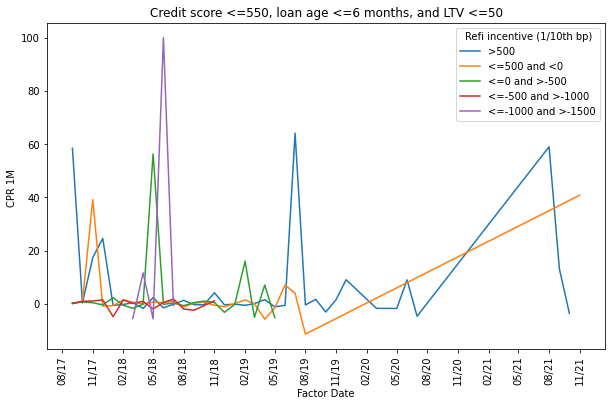

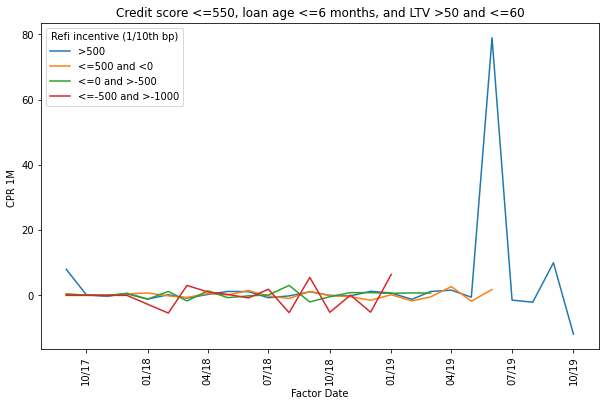

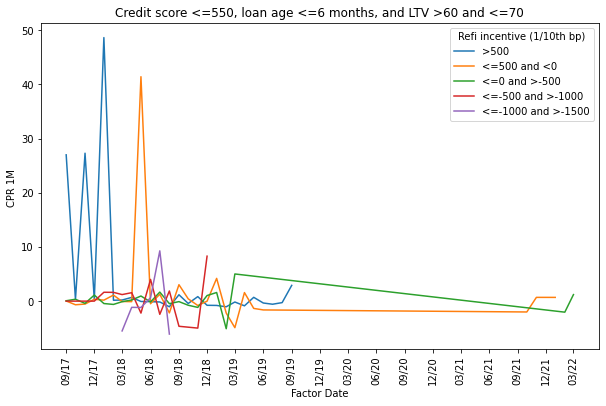

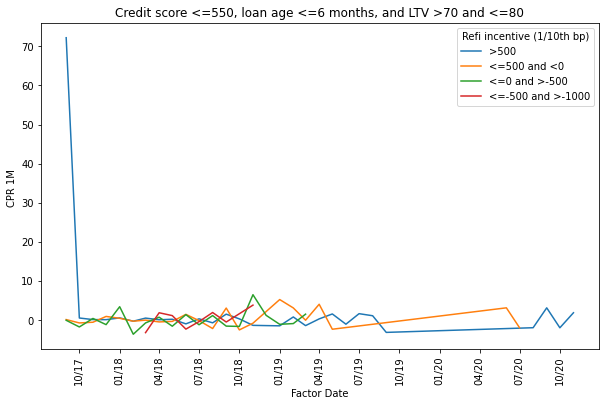

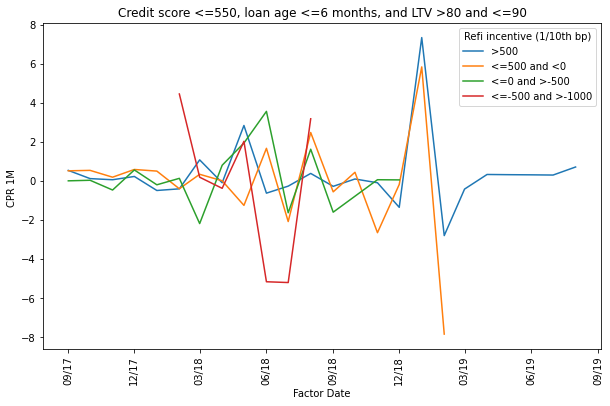

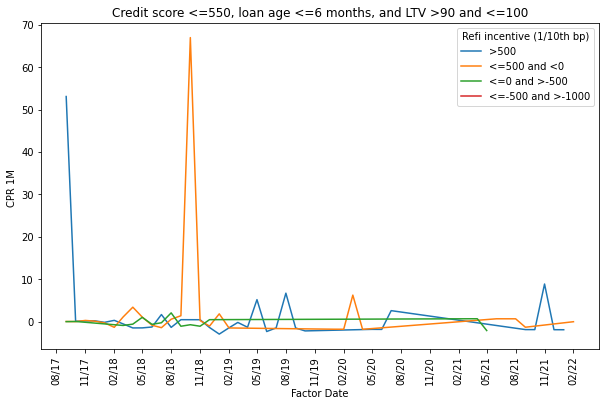

In [ ]:
for i in range(6): 
  Incentive_pos5 = OTM_Large_A_1_LTV[i][OTM_Large_A_1_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_A_1_LTV[i][(OTM_Large_A_1_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_A_1_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_A_1_LTV[i][(OTM_Large_A_1_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_A_1_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_A_1_LTV[i][(OTM_Large_A_1_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_A_1_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_A_1_LTV[i][(OTM_Large_A_1_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_A_1_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_A_1_LTV[i][(OTM_Large_A_1_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_A_1_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_A_1_LTV[i][OTM_Large_A_1_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  

  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10 ,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[0] + ', loan age ' + LoanAge_buckets[0] + ' months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

### Loan age $>6$ and $\leq 12$ months and all LTVs

<Figure size 432x288 with 0 Axes>

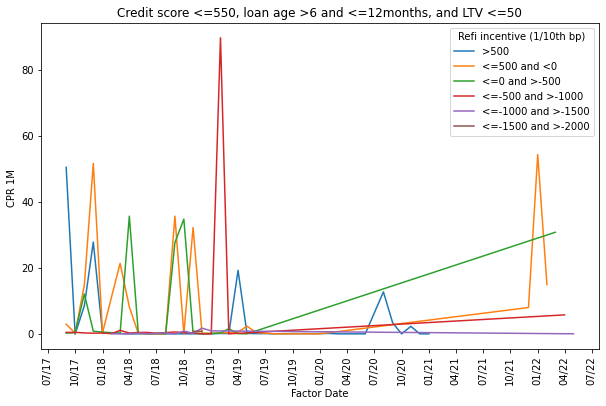

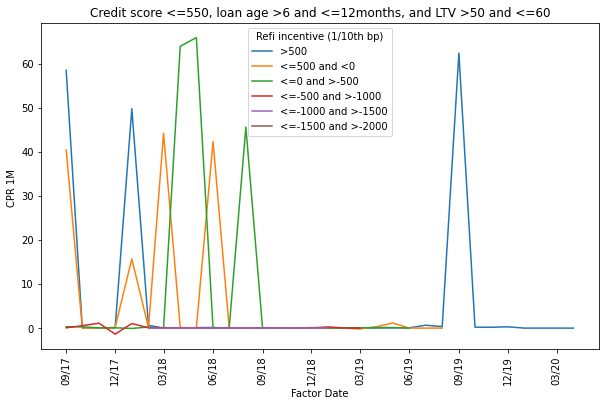

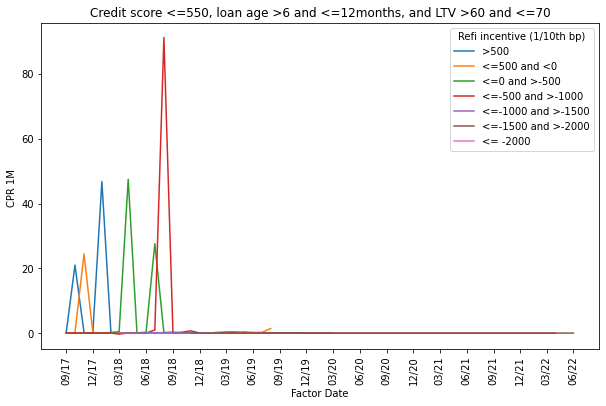

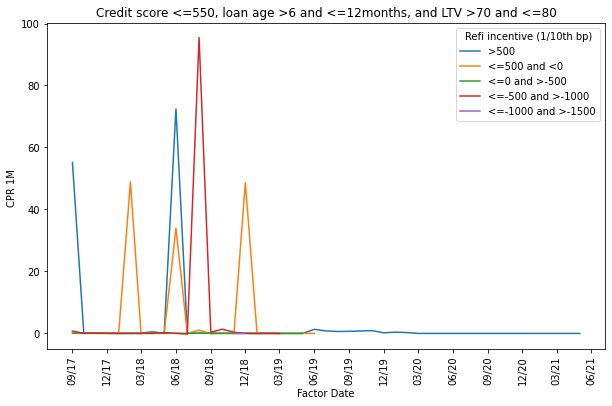

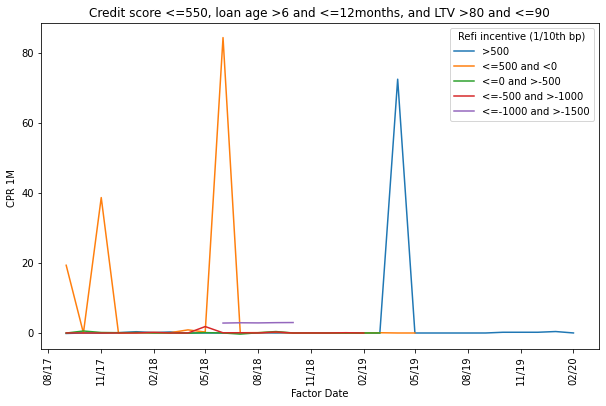

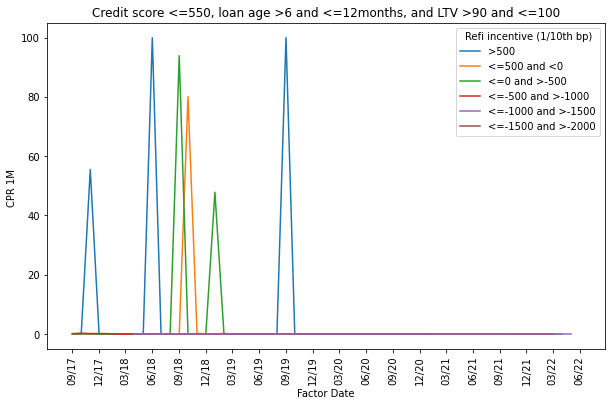

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_A_2_LTV[i][OTM_Large_A_2_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_A_2_LTV[i][(OTM_Large_A_2_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_A_2_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_A_2_LTV[i][(OTM_Large_A_2_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_A_2_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_A_2_LTV[i][(OTM_Large_A_2_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_A_2_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_A_2_LTV[i][(OTM_Large_A_2_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_A_2_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_A_2_LTV[i][(OTM_Large_A_2_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_A_2_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_A_2_LTV[i][OTM_Large_A_2_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[0] + ', loan age ' + LoanAge_buckets[1] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

### Loan age $>12$ and $\leq 24$ months and all LTVs

<Figure size 432x288 with 0 Axes>

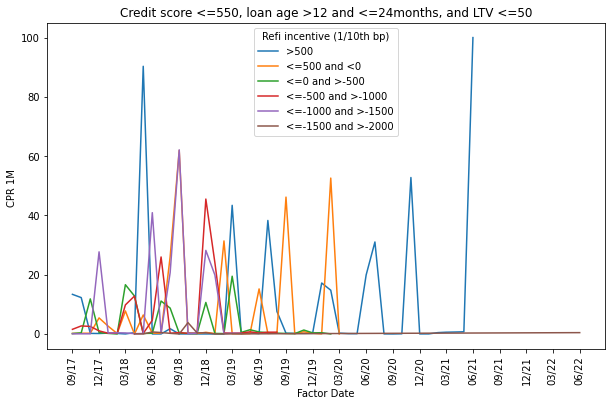

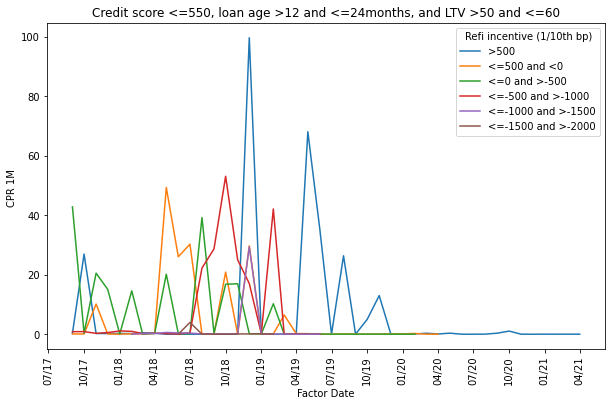

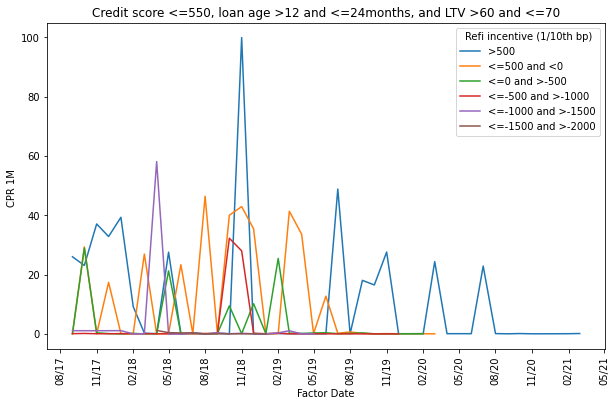

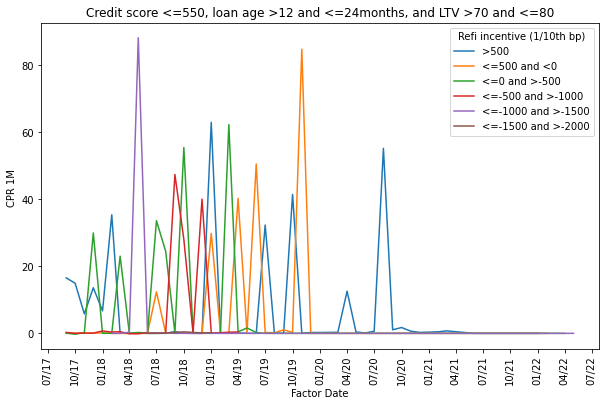

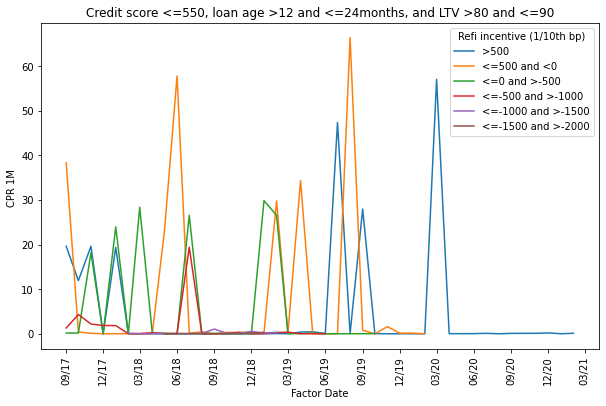

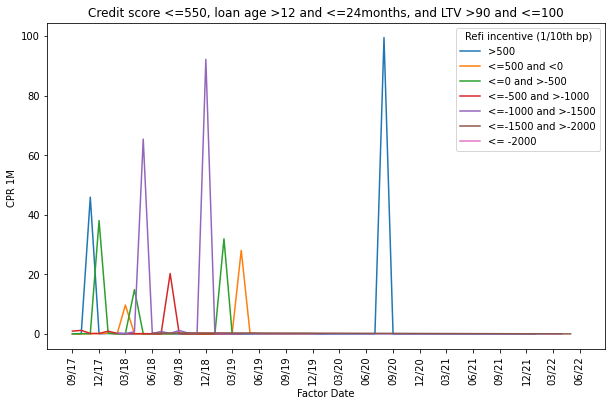

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_A_3_LTV[i][OTM_Large_A_3_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_A_3_LTV[i][(OTM_Large_A_3_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_A_3_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_A_3_LTV[i][(OTM_Large_A_3_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_A_3_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_A_3_LTV[i][(OTM_Large_A_3_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_A_3_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_A_3_LTV[i][(OTM_Large_A_3_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_A_3_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_A_3_LTV[i][(OTM_Large_A_3_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_A_3_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_A_3_LTV[i][OTM_Large_A_3_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[0] + ', loan age ' + LoanAge_buckets[2] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

### Loan age $>24$ and $\leq 36$ months and all LTVs

<Figure size 432x288 with 0 Axes>

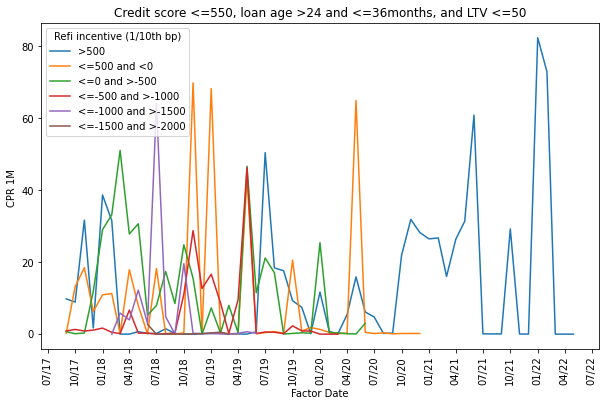

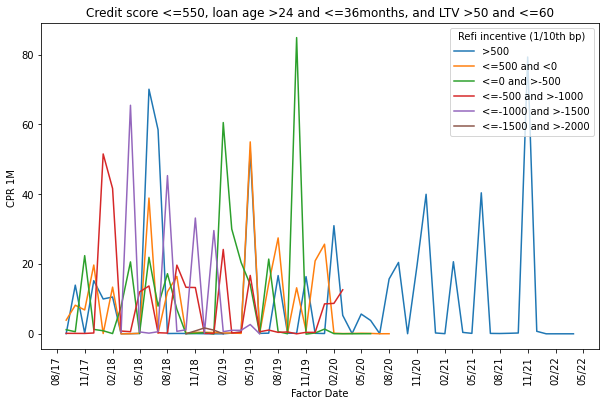

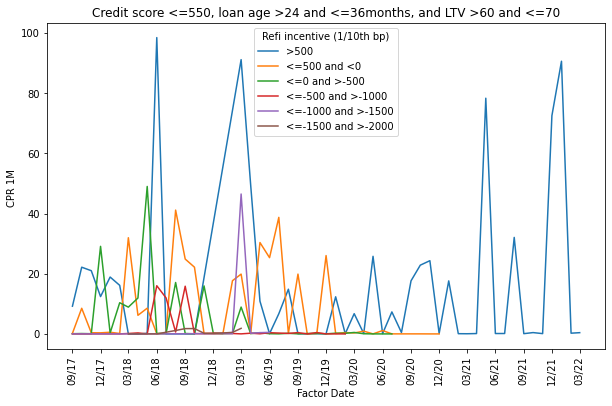

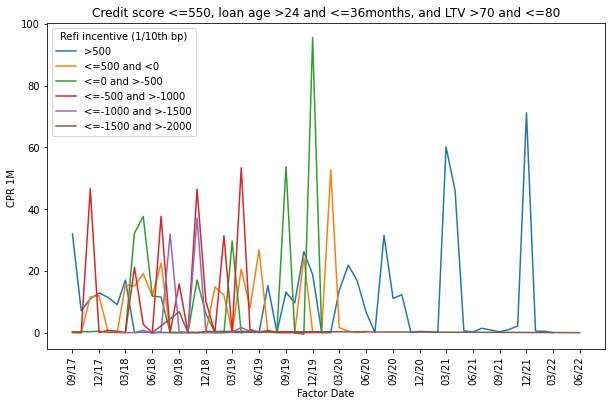

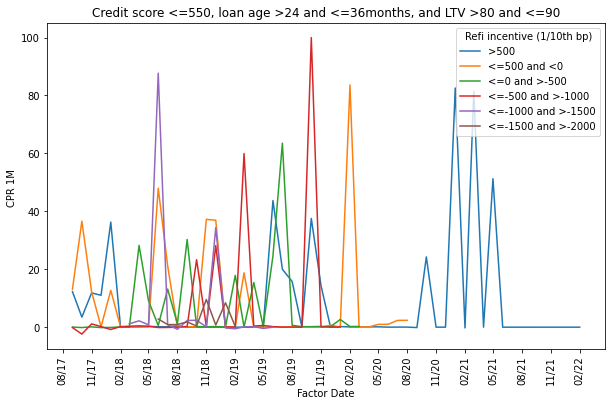

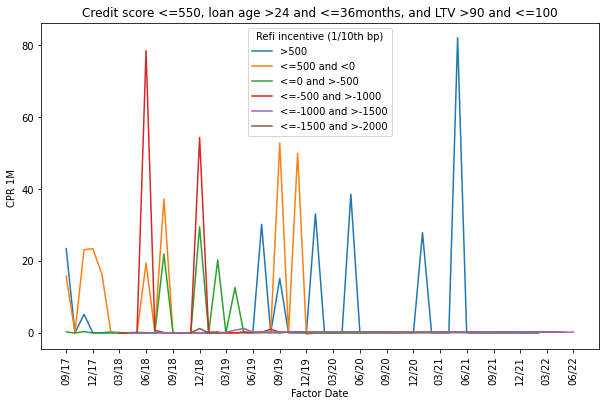

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_A_4_LTV[i][OTM_Large_A_4_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_A_4_LTV[i][(OTM_Large_A_4_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_A_4_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_A_4_LTV[i][(OTM_Large_A_4_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_A_4_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_A_4_LTV[i][(OTM_Large_A_4_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_A_4_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_A_4_LTV[i][(OTM_Large_A_4_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_A_4_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_A_4_LTV[i][(OTM_Large_A_4_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_A_4_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_A_4_LTV[i][OTM_Large_A_4_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[0] + ', loan age ' + LoanAge_buckets[3] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

### Loan age $>36$ and $\leq 48$ months and all LTVs

<Figure size 432x288 with 0 Axes>

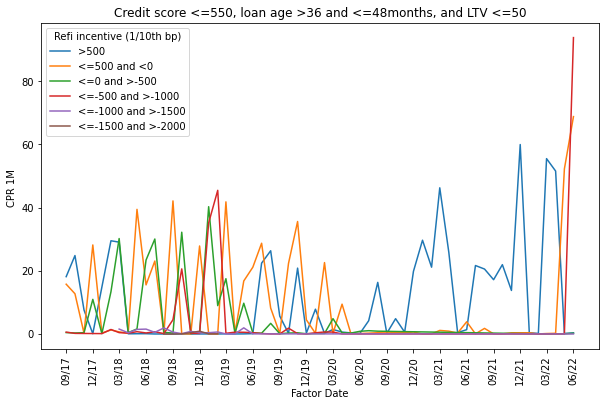

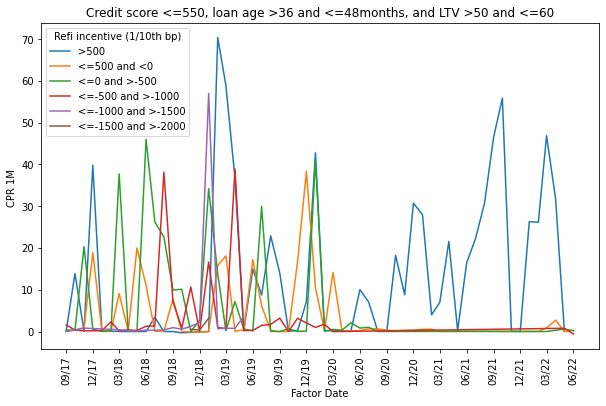

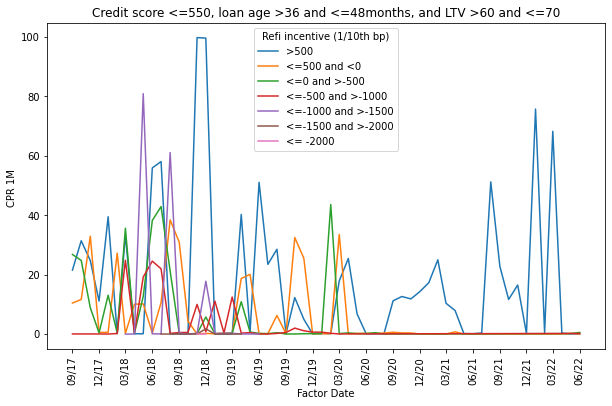

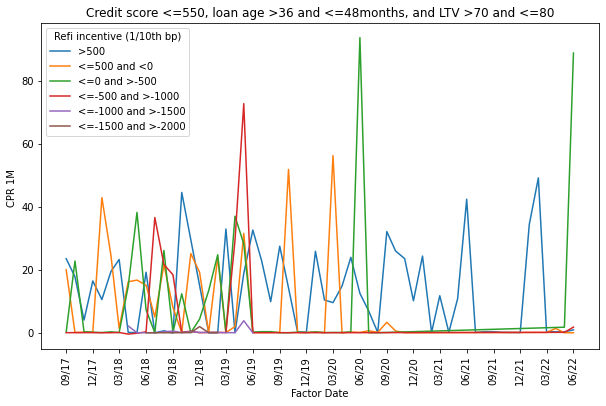

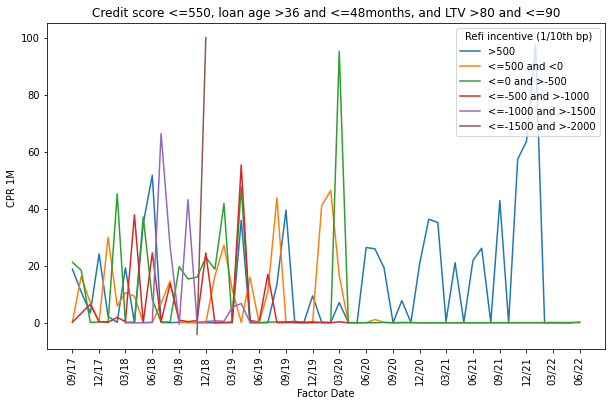

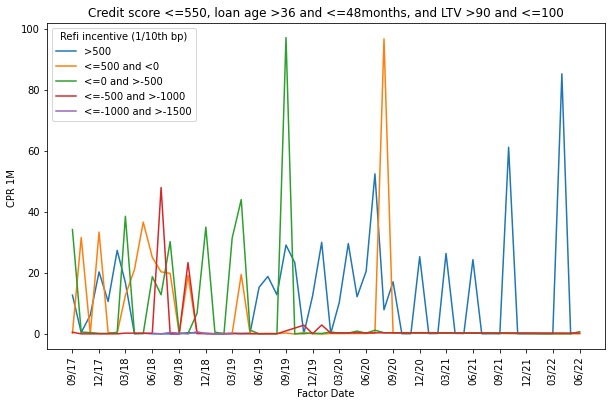

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_A_5_LTV[i][OTM_Large_A_5_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_A_5_LTV[i][(OTM_Large_A_5_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_A_5_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_A_5_LTV[i][(OTM_Large_A_5_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_A_5_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_A_5_LTV[i][(OTM_Large_A_5_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_A_5_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_A_5_LTV[i][(OTM_Large_A_5_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_A_5_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_A_5_LTV[i][(OTM_Large_A_5_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_A_5_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_A_5_LTV[i][OTM_Large_A_5_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[0] + ', loan age ' + LoanAge_buckets[4] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

### Loan age $>48$ and $\leq 60$ months and all LTVs

<Figure size 432x288 with 0 Axes>

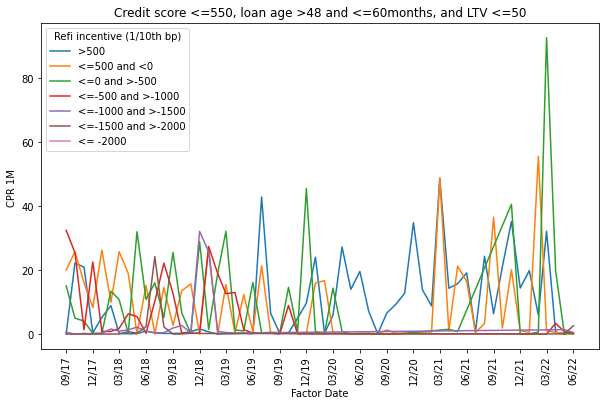

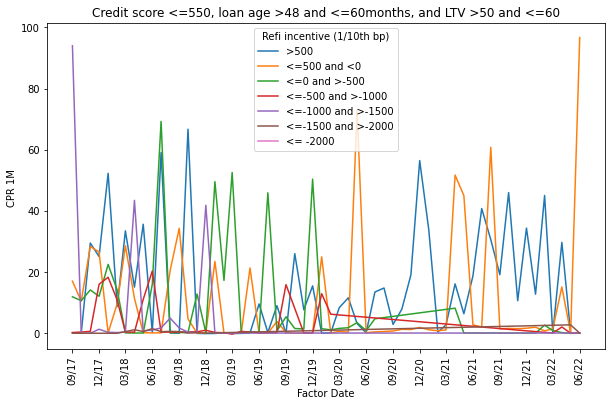

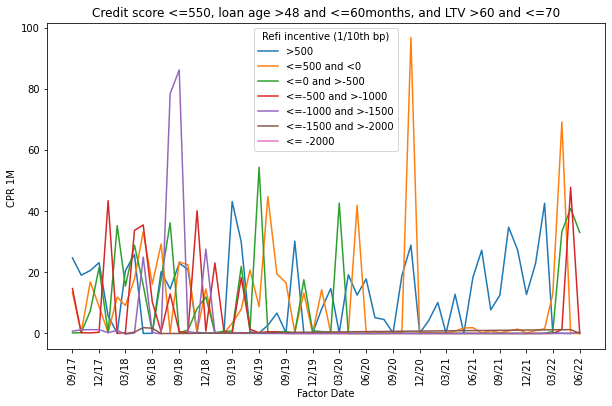

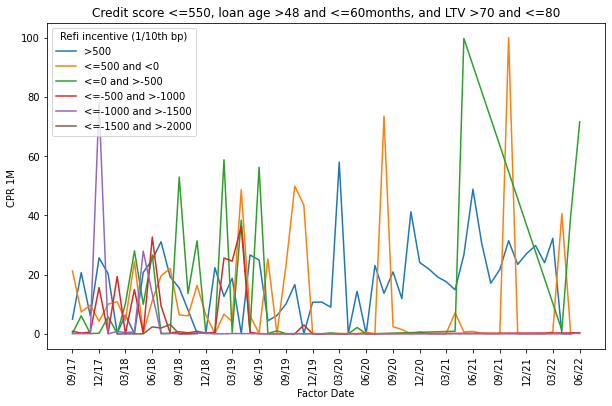

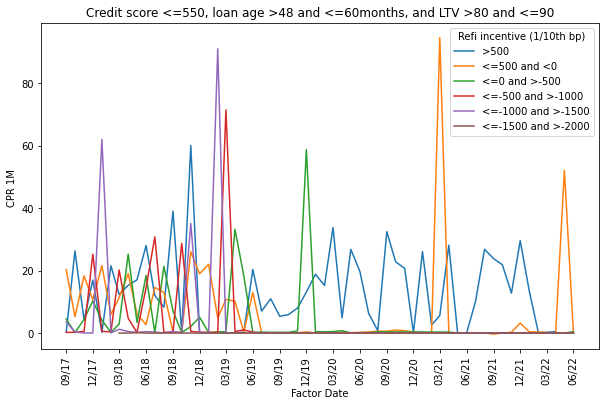

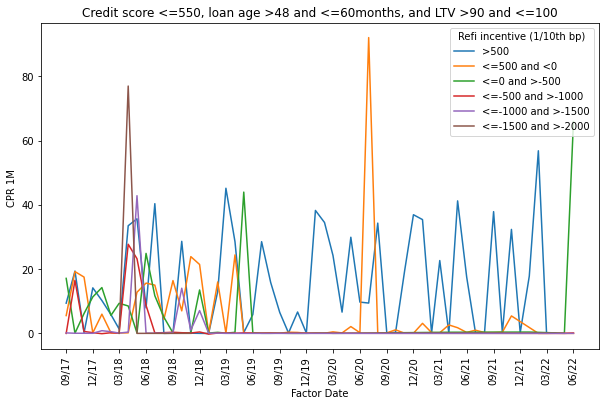

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_A_6_LTV[i][OTM_Large_A_6_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_A_6_LTV[i][(OTM_Large_A_6_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_A_6_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_A_6_LTV[i][(OTM_Large_A_6_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_A_6_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_A_6_LTV[i][(OTM_Large_A_6_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_A_6_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_A_6_LTV[i][(OTM_Large_A_6_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_A_6_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_A_6_LTV[i][(OTM_Large_A_6_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_A_6_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_A_6_LTV[i][OTM_Large_A_6_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[0] + ', loan age ' + LoanAge_buckets[5] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

### Loan age $>60$ months and all LTVs

<Figure size 432x288 with 0 Axes>

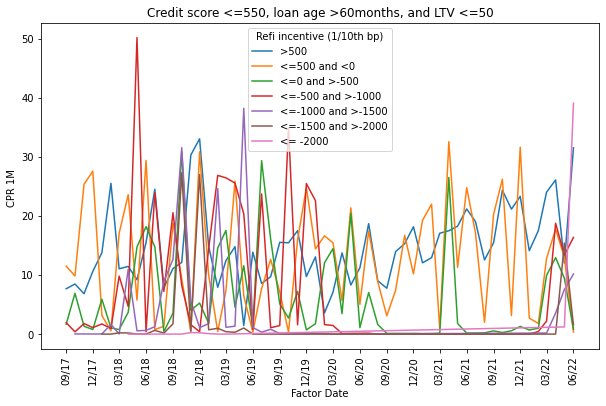

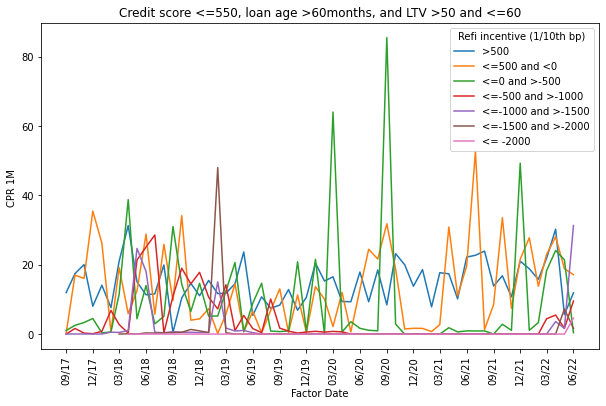

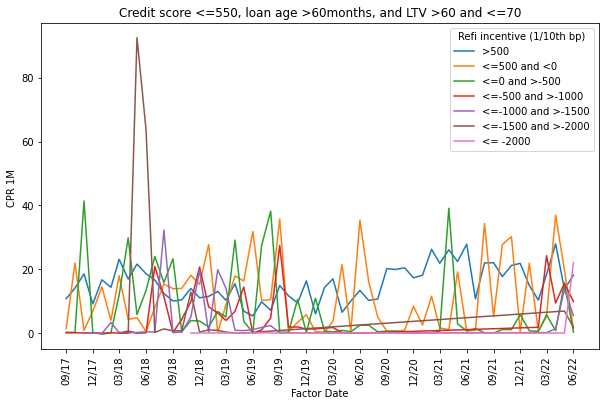

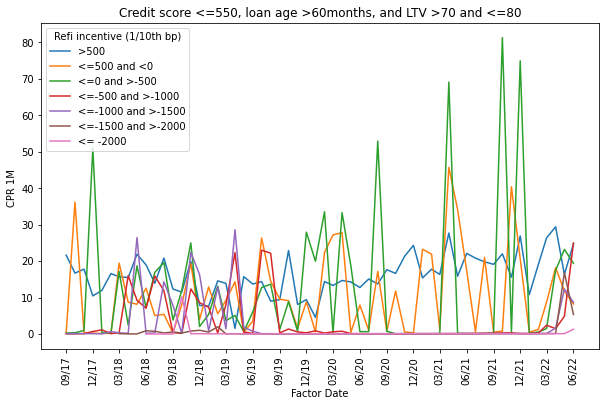

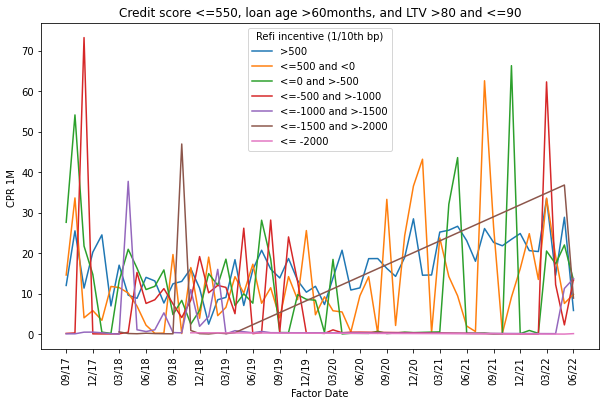

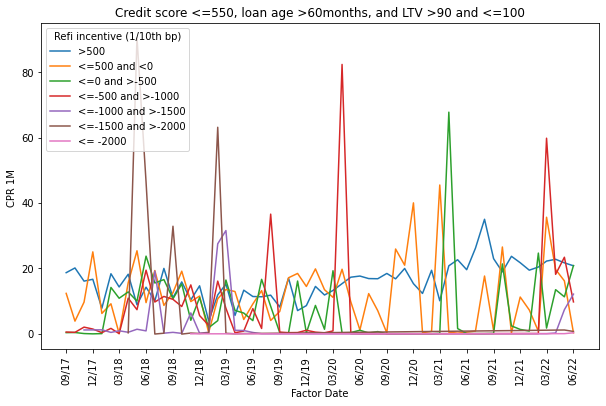

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_A_7_LTV[i][OTM_Large_A_7_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_A_7_LTV[i][(OTM_Large_A_7_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_A_7_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_A_7_LTV[i][(OTM_Large_A_7_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_A_7_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_A_7_LTV[i][(OTM_Large_A_7_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_A_7_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_A_7_LTV[i][(OTM_Large_A_7_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_A_7_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_A_7_LTV[i][(OTM_Large_A_7_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_A_7_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_A_7_LTV[i][OTM_Large_A_7_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[0] + ', loan age ' + LoanAge_buckets[6] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

## Credit score $>550$ and $\leq 680$ (Bucket B)

### Loan Age $\leq 6$ months and all LTVs

<Figure size 432x288 with 0 Axes>

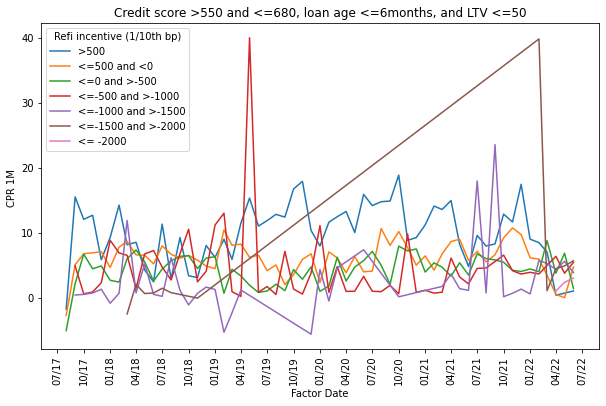

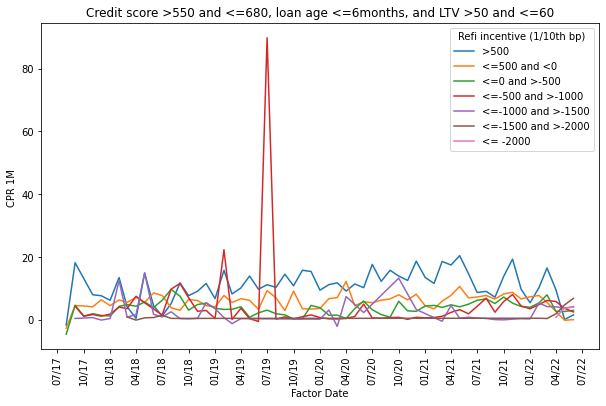

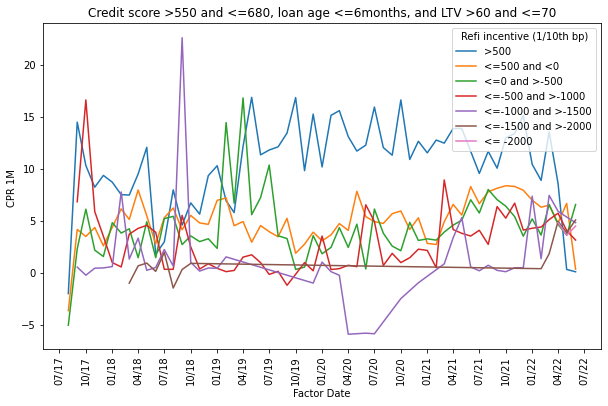

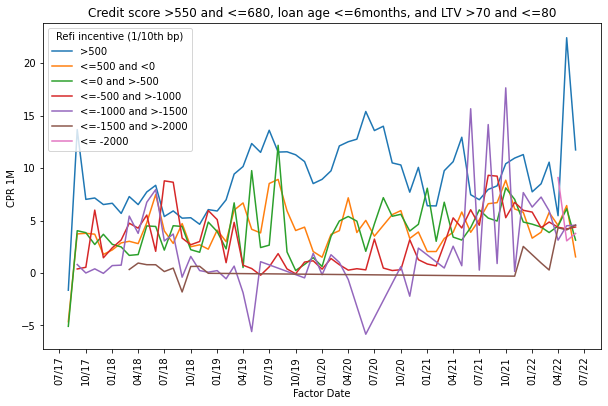

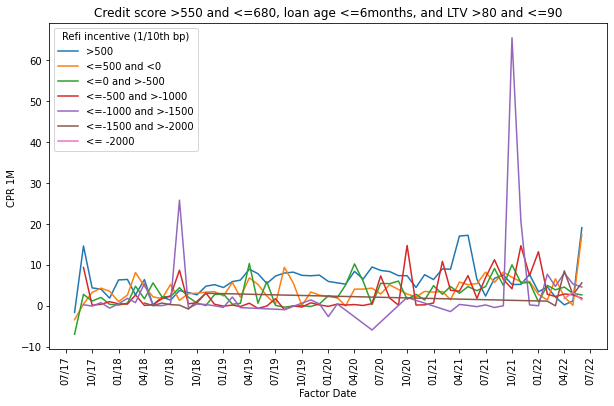

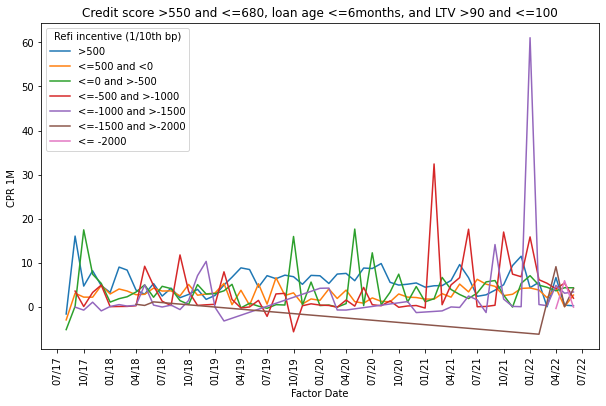

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_B_1_LTV[i][OTM_Large_B_1_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_B_1_LTV[i][(OTM_Large_B_1_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_B_1_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_B_1_LTV[i][(OTM_Large_B_1_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_B_1_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_B_1_LTV[i][(OTM_Large_B_1_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_B_1_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_B_1_LTV[i][(OTM_Large_B_1_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_B_1_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_B_1_LTV[i][(OTM_Large_B_1_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_B_1_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_B_1_LTV[i][OTM_Large_B_1_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[1] + ', loan age ' + LoanAge_buckets[0] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

### Loan age $>6$ and $\leq 12$ months and all LTVs

<Figure size 432x288 with 0 Axes>

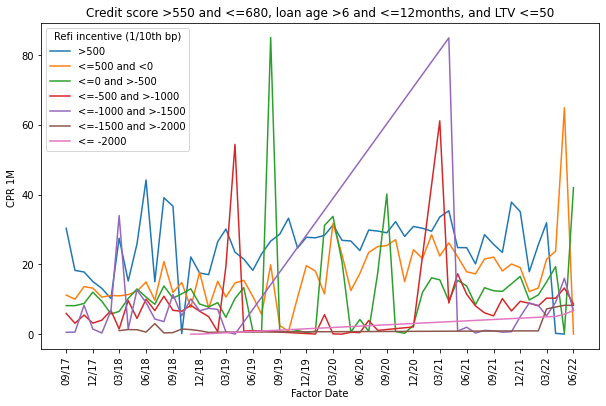

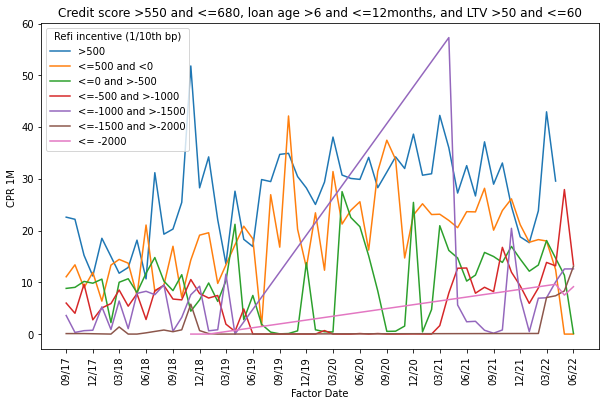

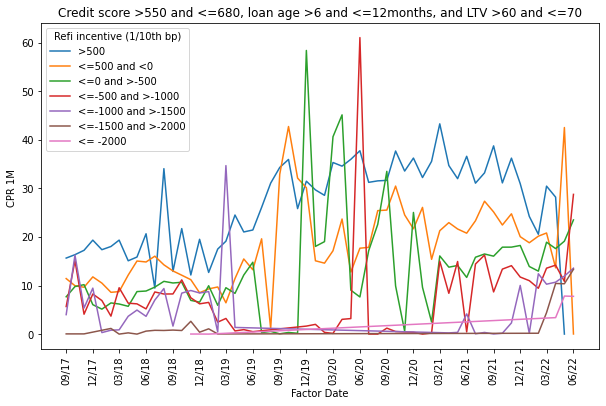

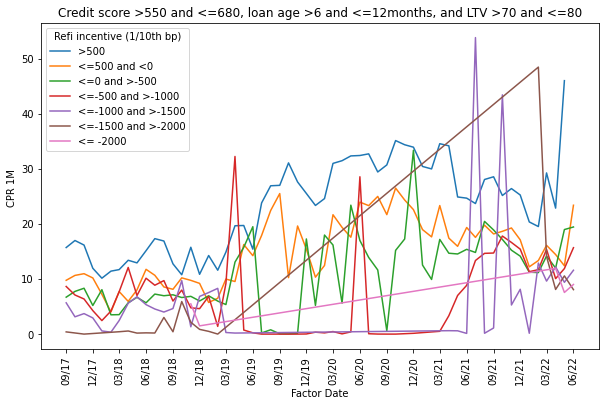

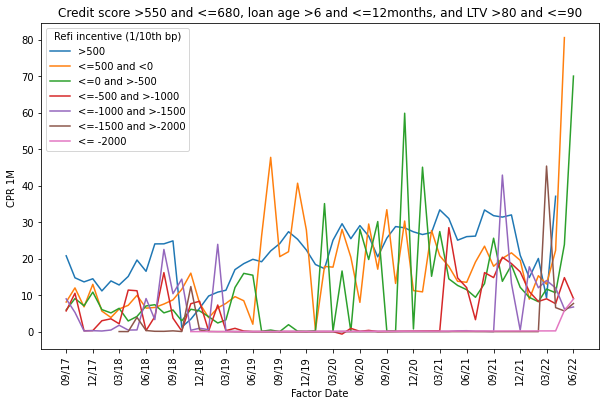

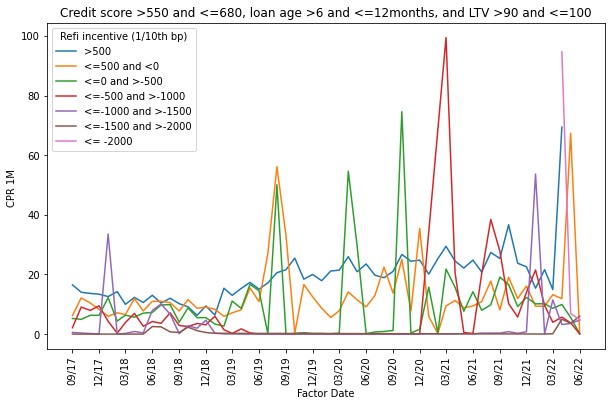

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_B_2_LTV[i][OTM_Large_B_2_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_B_2_LTV[i][(OTM_Large_B_2_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_B_2_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_B_2_LTV[i][(OTM_Large_B_2_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_B_2_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_B_2_LTV[i][(OTM_Large_B_2_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_B_2_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_B_2_LTV[i][(OTM_Large_B_2_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_B_2_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_B_2_LTV[i][(OTM_Large_B_2_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_B_2_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_B_2_LTV[i][OTM_Large_B_2_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[1] + ', loan age ' + LoanAge_buckets[1] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

### Loan age $>12$ and $\leq 24$ months and all LTVs


<Figure size 432x288 with 0 Axes>

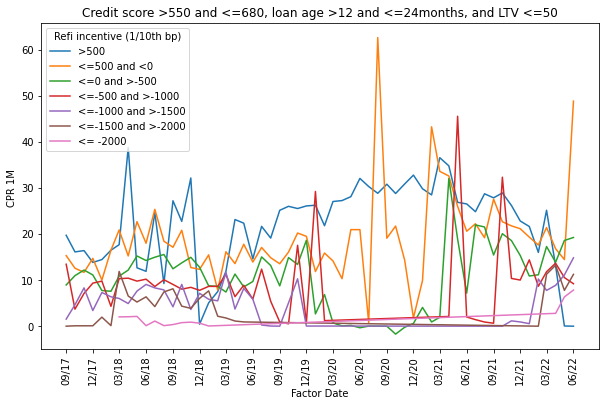

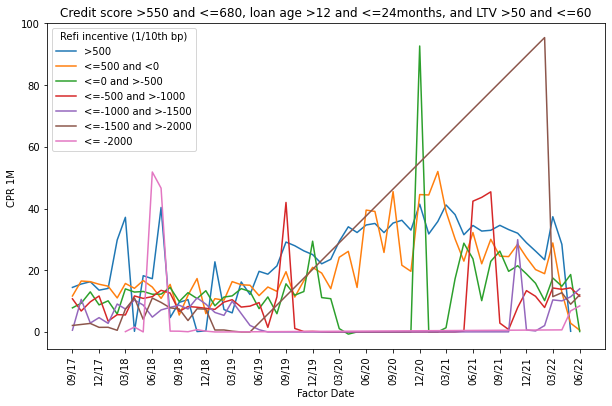

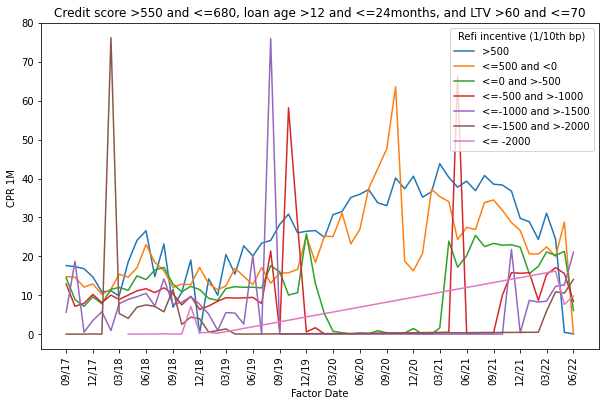

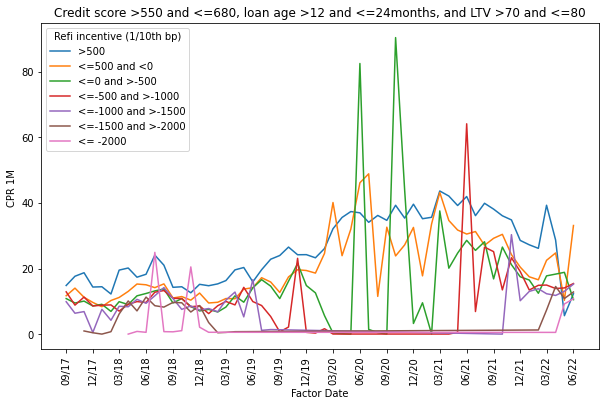

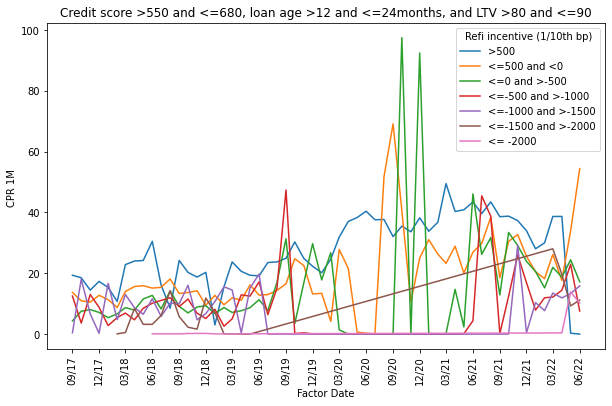

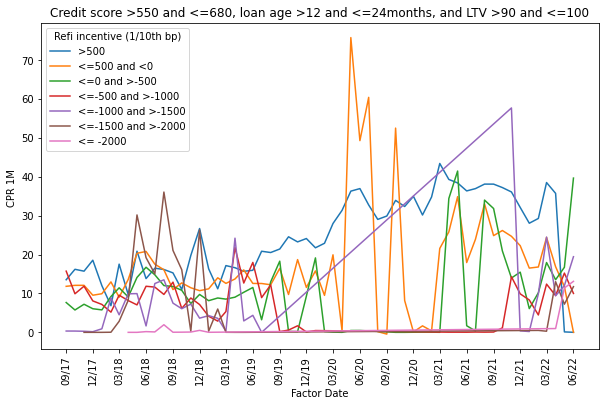

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_B_3_LTV[i][OTM_Large_B_3_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_B_3_LTV[i][(OTM_Large_B_3_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_B_3_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_B_3_LTV[i][(OTM_Large_B_3_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_B_3_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_B_3_LTV[i][(OTM_Large_B_3_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_B_3_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_B_3_LTV[i][(OTM_Large_B_3_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_B_3_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_B_3_LTV[i][(OTM_Large_B_3_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_B_3_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_B_3_LTV[i][OTM_Large_B_3_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[1] + ', loan age ' + LoanAge_buckets[2] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

### Loan age $>24$ and $\leq 36$ months and all LTVs

<Figure size 432x288 with 0 Axes>

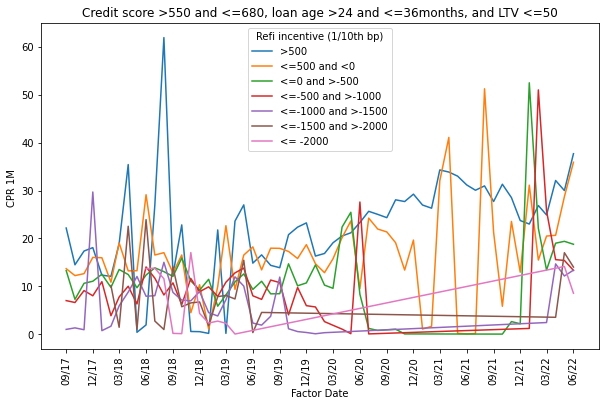

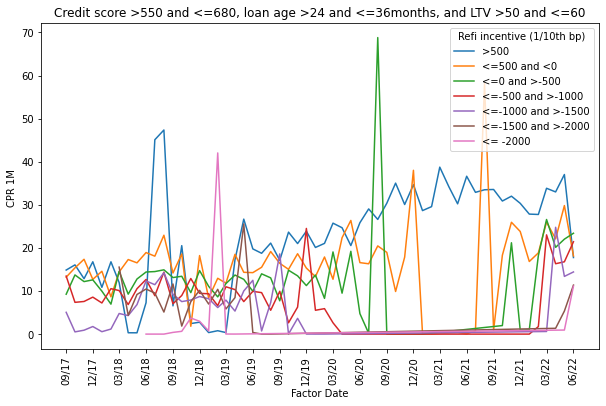

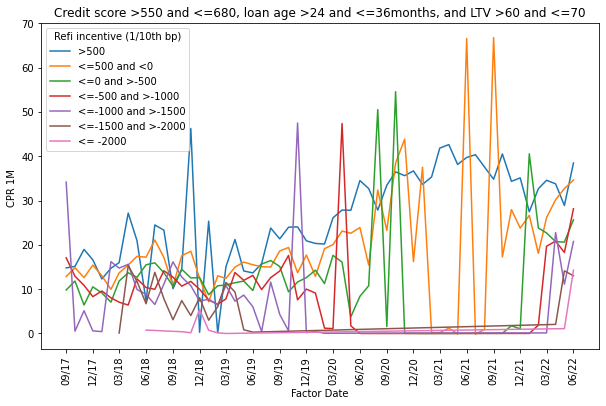

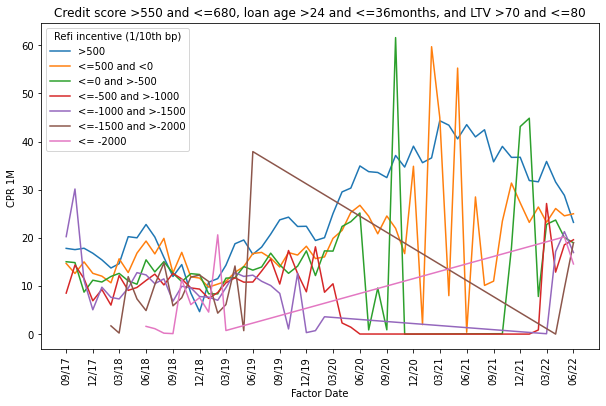

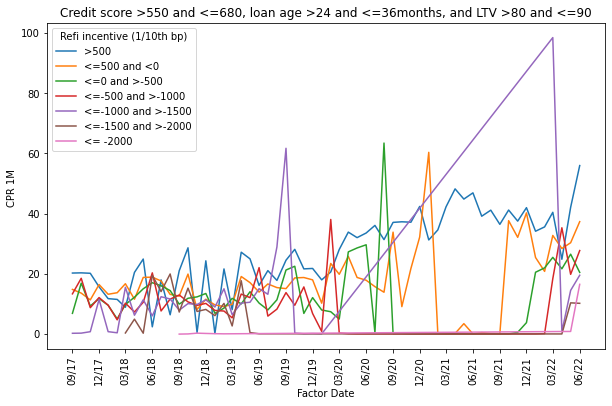

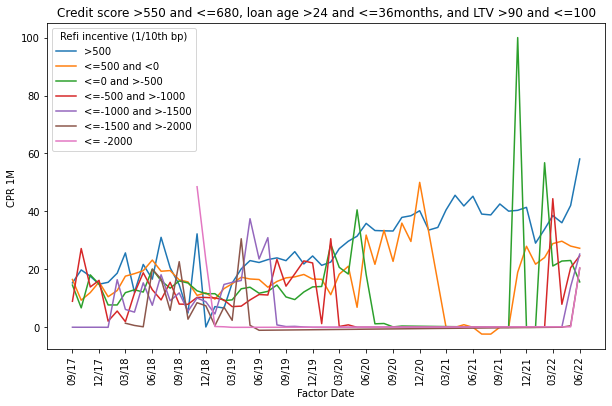

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_B_4_LTV[i][OTM_Large_B_4_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_B_4_LTV[i][(OTM_Large_B_4_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_B_4_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_B_4_LTV[i][(OTM_Large_B_4_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_B_4_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_B_4_LTV[i][(OTM_Large_B_4_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_B_4_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_B_4_LTV[i][(OTM_Large_B_4_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_B_4_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_B_4_LTV[i][(OTM_Large_B_4_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_B_4_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_B_4_LTV[i][OTM_Large_B_4_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[1] + ', loan age ' + LoanAge_buckets[3] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

### Loan age $>36$ and $\leq 48$ months and all LTVs

<Figure size 432x288 with 0 Axes>

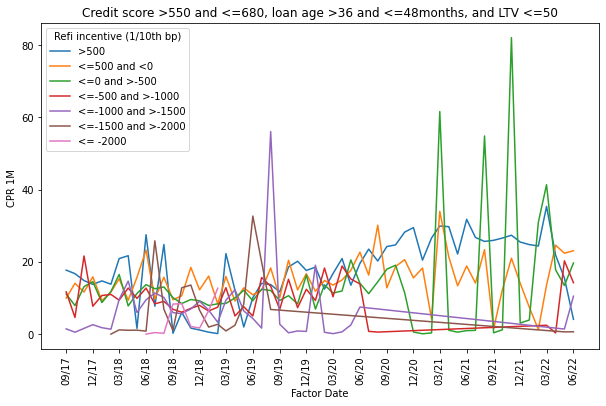

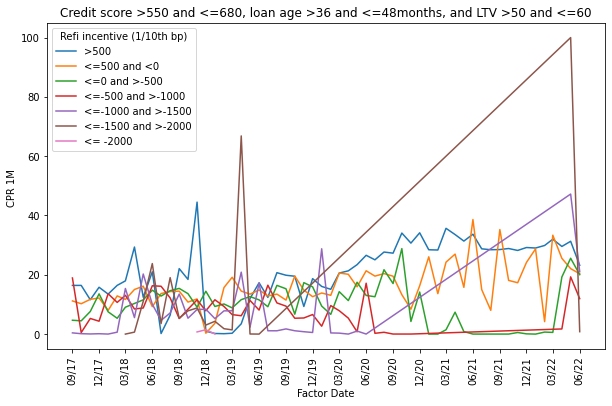

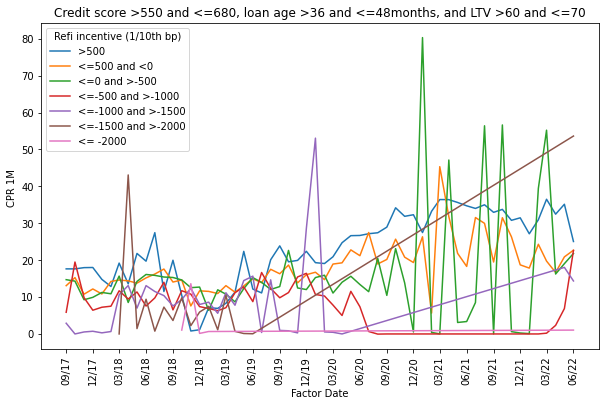

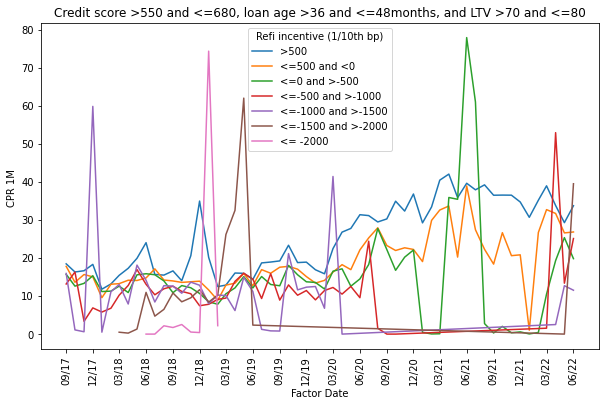

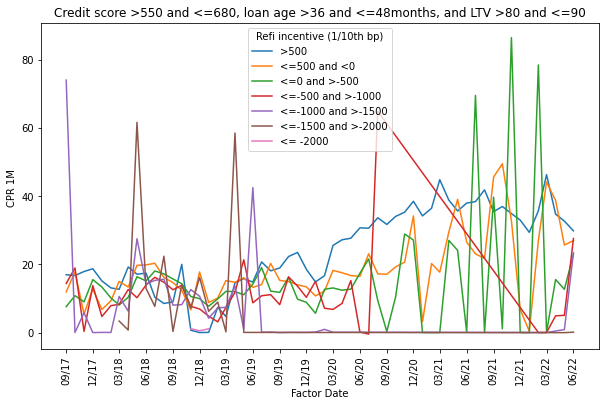

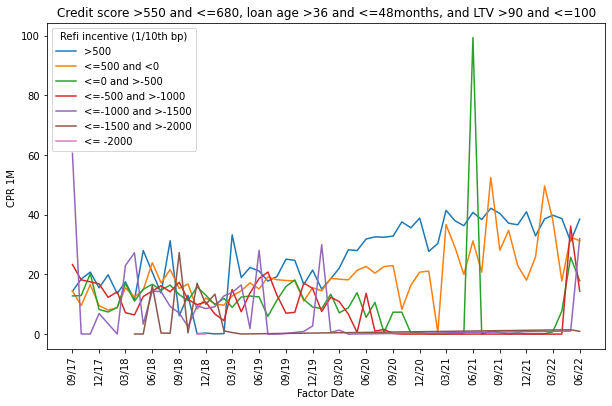

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_B_5_LTV[i][OTM_Large_B_5_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_B_5_LTV[i][(OTM_Large_B_5_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_B_5_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_B_5_LTV[i][(OTM_Large_B_5_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_B_5_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_B_5_LTV[i][(OTM_Large_B_5_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_B_5_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_B_5_LTV[i][(OTM_Large_B_5_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_B_5_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_B_5_LTV[i][(OTM_Large_B_5_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_B_5_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_B_5_LTV[i][OTM_Large_B_5_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[1] + ', loan age ' + LoanAge_buckets[4] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


### Loan age $>48$ and $\leq 60$ months and all LTVs

<Figure size 432x288 with 0 Axes>

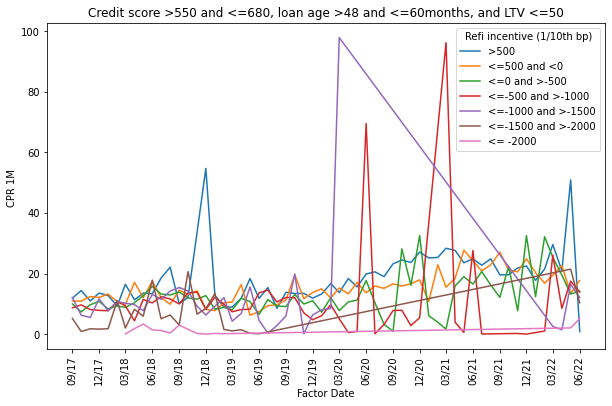

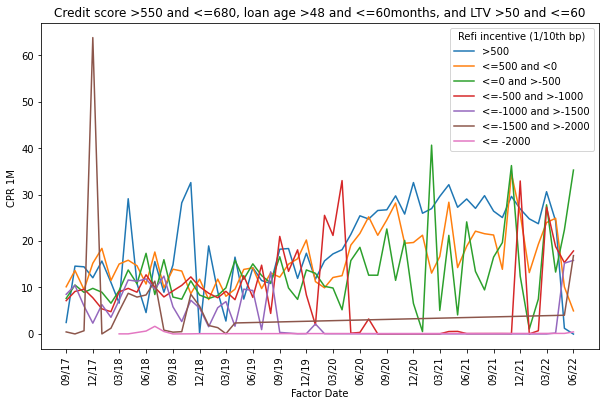

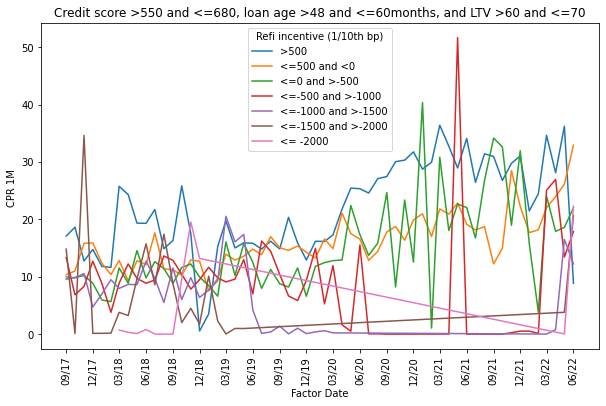

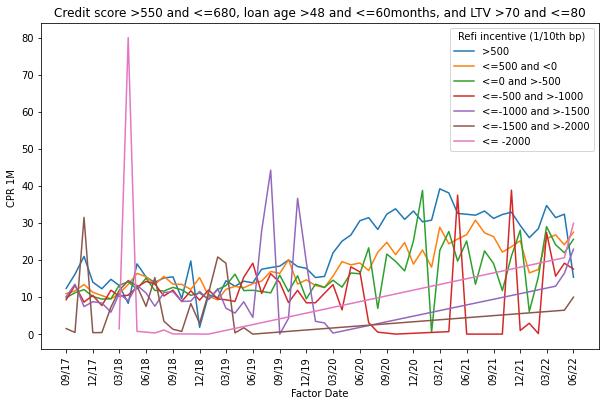

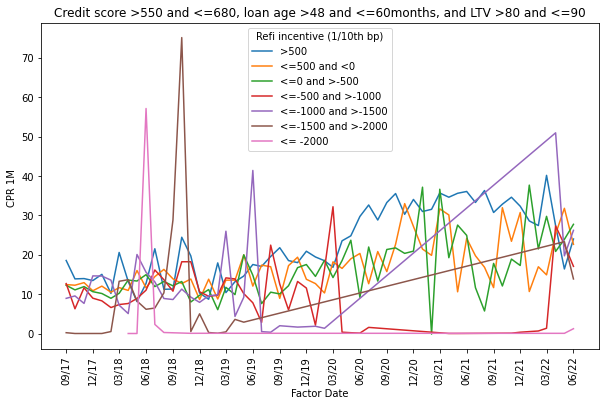

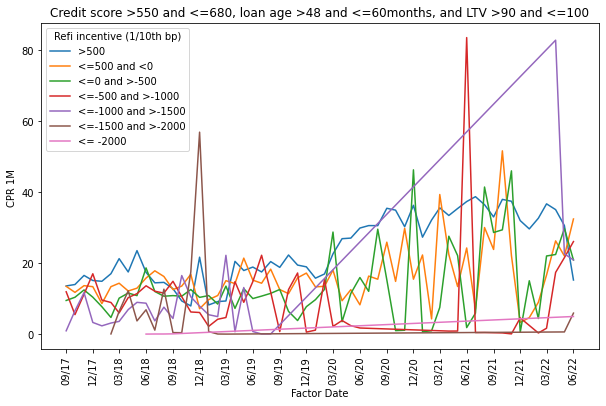

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_B_6_LTV[i][OTM_Large_B_6_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_B_6_LTV[i][(OTM_Large_B_6_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_B_6_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_B_6_LTV[i][(OTM_Large_B_6_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_B_6_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_B_6_LTV[i][(OTM_Large_B_6_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_B_6_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_B_6_LTV[i][(OTM_Large_B_6_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_B_6_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_B_6_LTV[i][(OTM_Large_B_6_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_B_6_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_B_6_LTV[i][OTM_Large_B_6_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[1] + ', loan age ' + LoanAge_buckets[5] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


### Loan age $>60$ months and all LTVs

<Figure size 432x288 with 0 Axes>

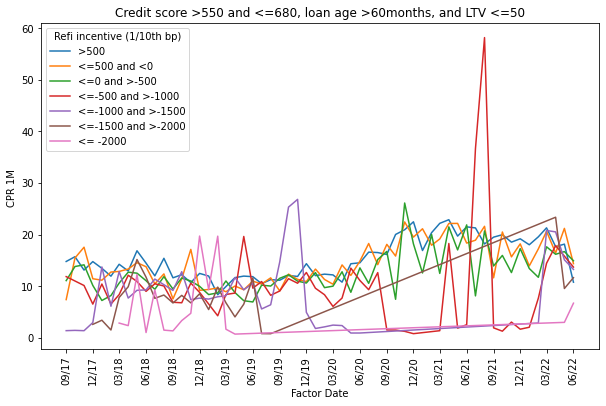

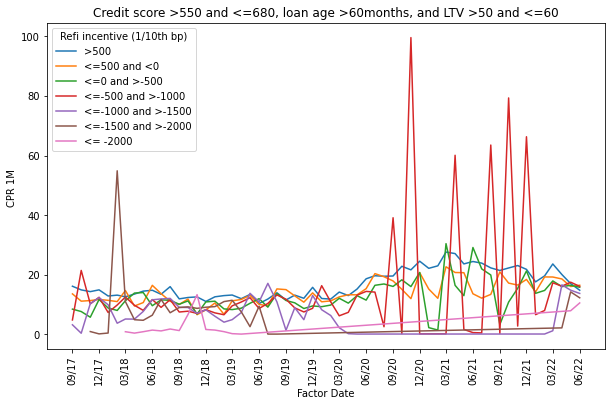

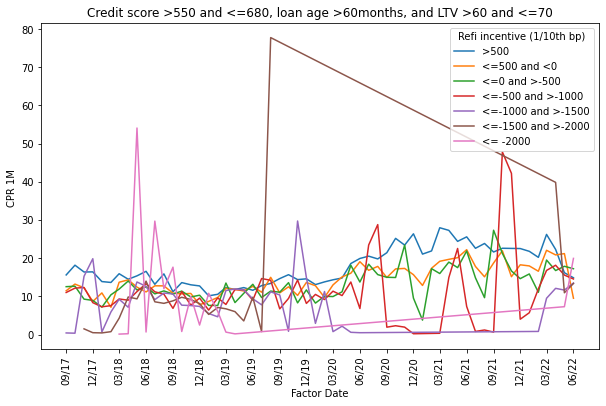

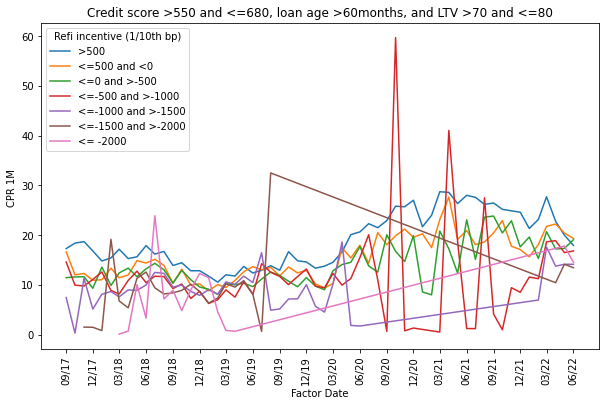

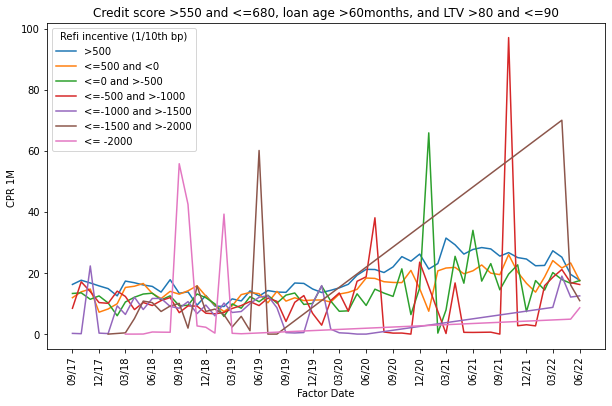

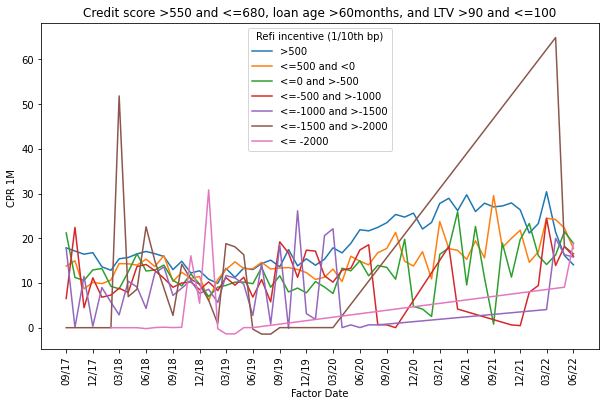

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_B_7_LTV[i][OTM_Large_B_7_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_B_7_LTV[i][(OTM_Large_B_7_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_B_7_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_B_7_LTV[i][(OTM_Large_B_7_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_B_7_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_B_7_LTV[i][(OTM_Large_B_7_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_B_7_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_B_7_LTV[i][(OTM_Large_B_7_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_B_7_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_B_7_LTV[i][(OTM_Large_B_7_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_B_7_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_B_7_LTV[i][OTM_Large_B_7_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[1] + ', loan age ' + LoanAge_buckets[6] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

## Credit score $>680$ and $\leq 740$ (Bucket C)

### Loan Age $\leq 6$ months and all LTVs

<Figure size 432x288 with 0 Axes>

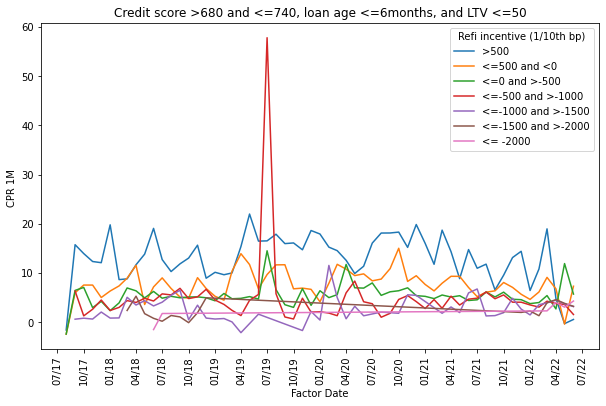

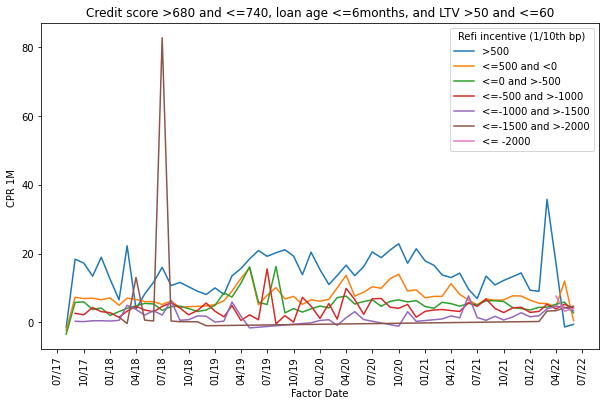

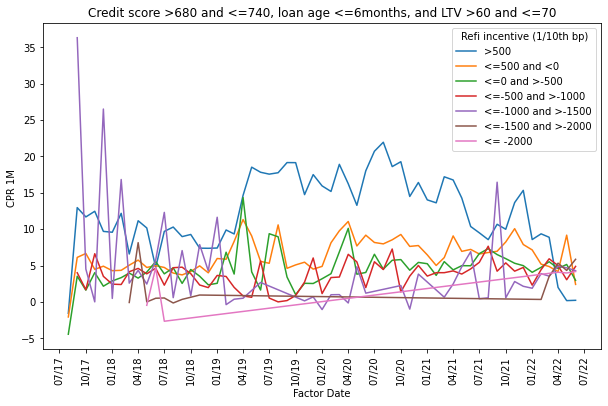

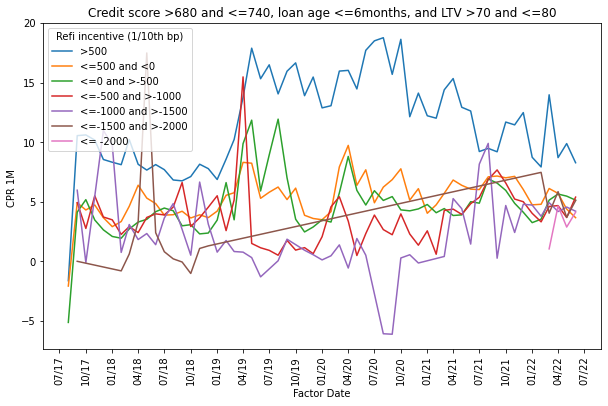

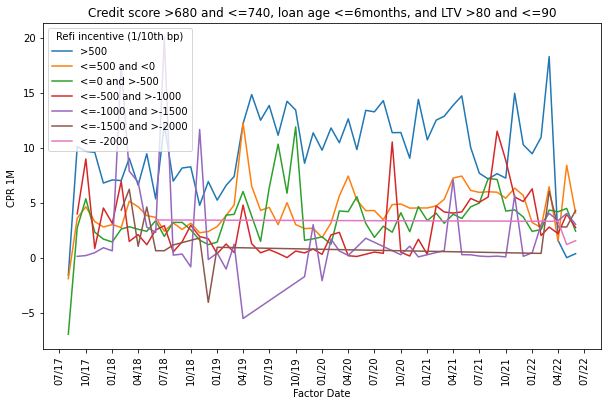

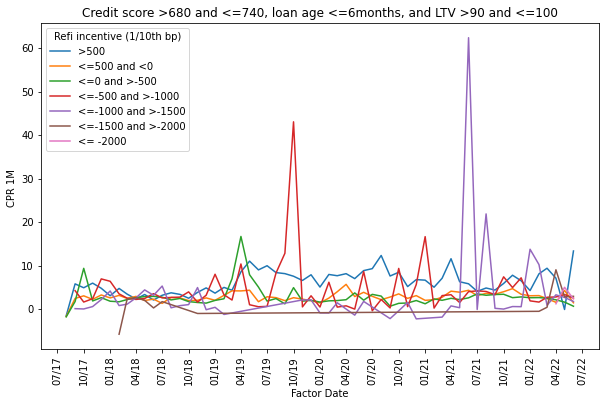

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_C_1_LTV[i][OTM_Large_C_1_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_C_1_LTV[i][(OTM_Large_C_1_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_C_1_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_C_1_LTV[i][(OTM_Large_C_1_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_C_1_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_C_1_LTV[i][(OTM_Large_C_1_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_C_1_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_C_1_LTV[i][(OTM_Large_C_1_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_C_1_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_C_1_LTV[i][(OTM_Large_C_1_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_C_1_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_C_1_LTV[i][OTM_Large_C_1_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[2] + ', loan age ' + LoanAge_buckets[0] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


### Loan age $>6$ and $\leq 12$ months and all LTVs

<Figure size 432x288 with 0 Axes>

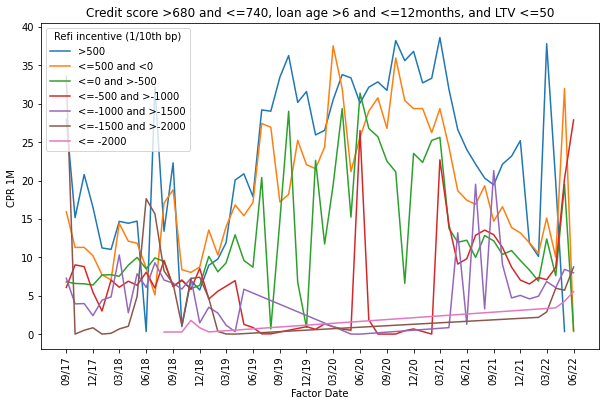

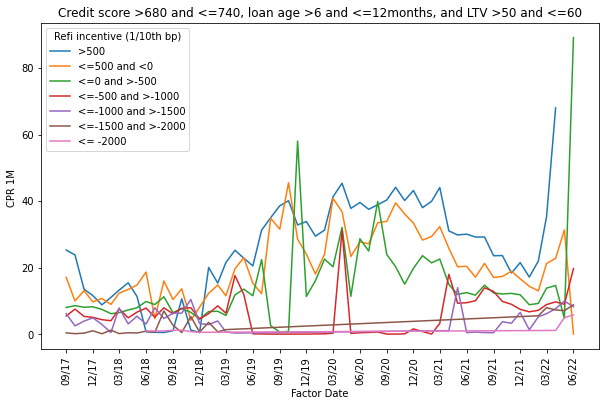

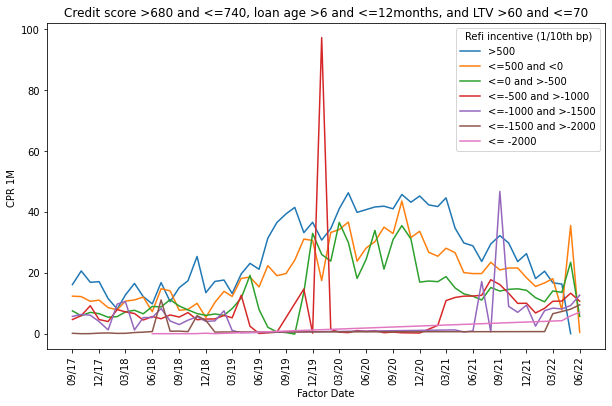

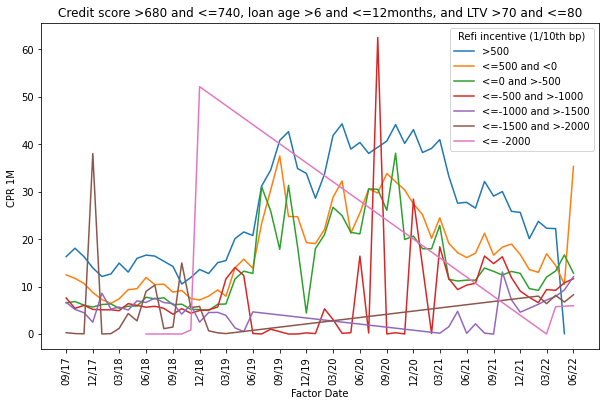

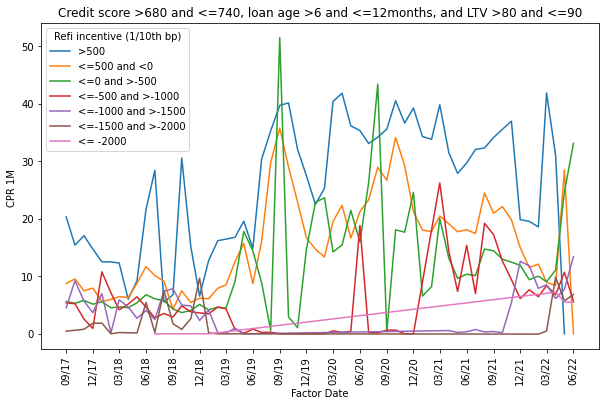

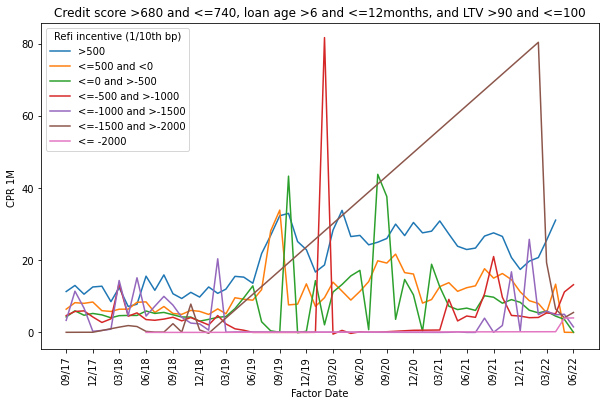

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_C_2_LTV[i][OTM_Large_C_2_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_C_2_LTV[i][(OTM_Large_C_2_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_C_2_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_C_2_LTV[i][(OTM_Large_C_2_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_C_2_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_C_2_LTV[i][(OTM_Large_C_2_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_C_2_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_C_2_LTV[i][(OTM_Large_C_2_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_C_2_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_C_2_LTV[i][(OTM_Large_C_2_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_C_2_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_C_2_LTV[i][OTM_Large_C_2_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[2] + ', loan age ' + LoanAge_buckets[1] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


### Loan age $>12$ and $\leq 24$ months and all LTVs


<Figure size 432x288 with 0 Axes>

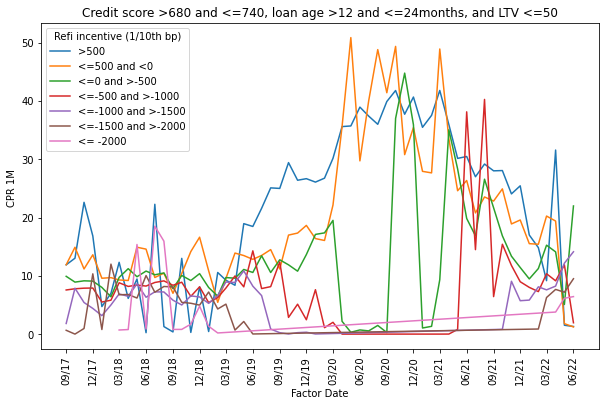

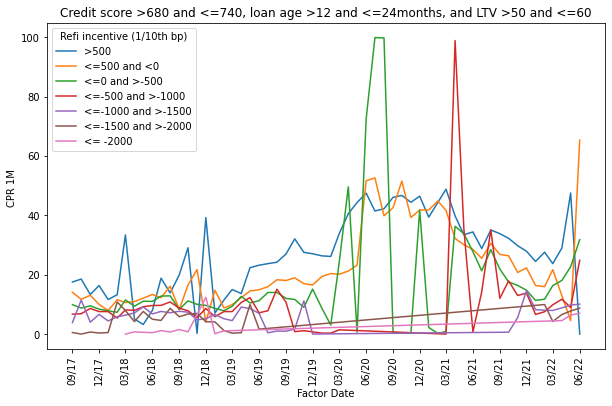

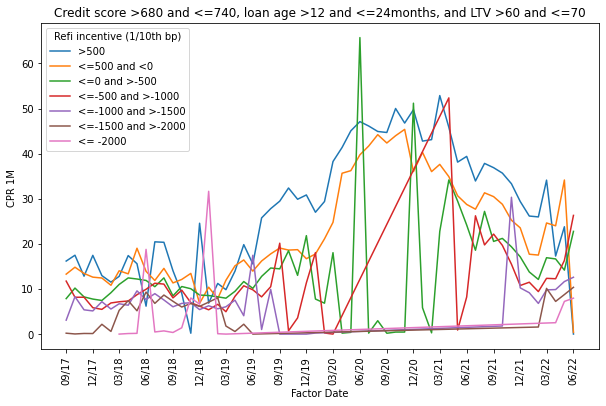

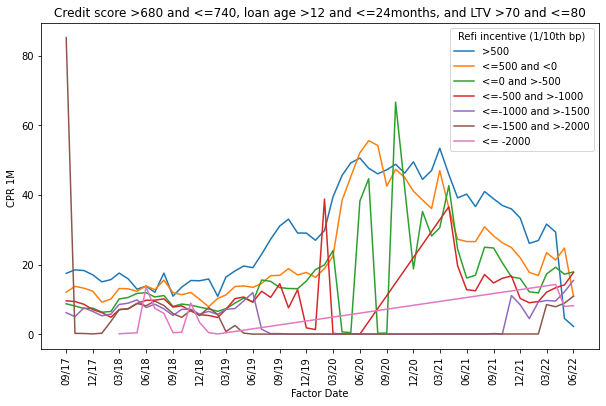

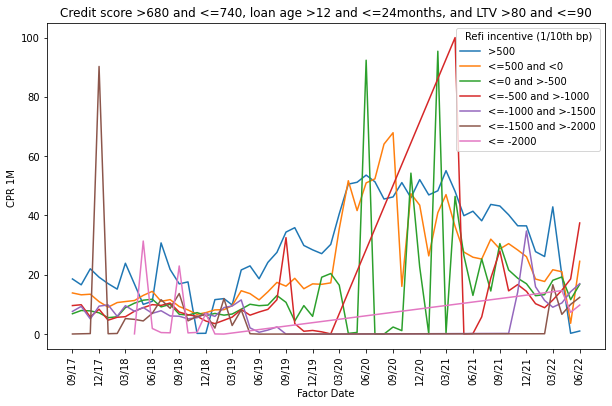

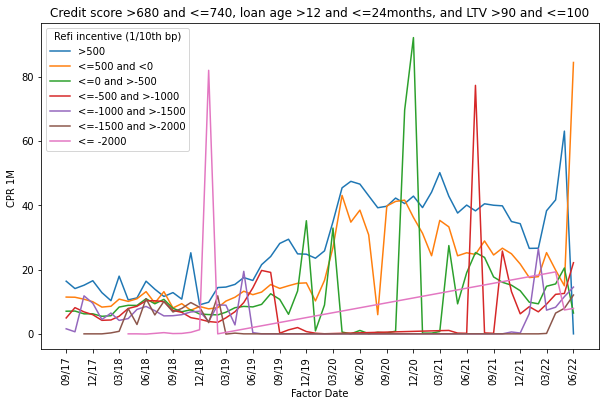

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_C_3_LTV[i][OTM_Large_C_3_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_C_3_LTV[i][(OTM_Large_C_3_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_C_3_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_C_3_LTV[i][(OTM_Large_C_3_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_C_3_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_C_3_LTV[i][(OTM_Large_C_3_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_C_3_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_C_3_LTV[i][(OTM_Large_C_3_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_C_3_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_C_3_LTV[i][(OTM_Large_C_3_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_C_3_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_C_3_LTV[i][OTM_Large_C_3_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[2] + ', loan age ' + LoanAge_buckets[2] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


### Loan age $>24$ and $\leq 36$ months and all LTVs

<Figure size 432x288 with 0 Axes>

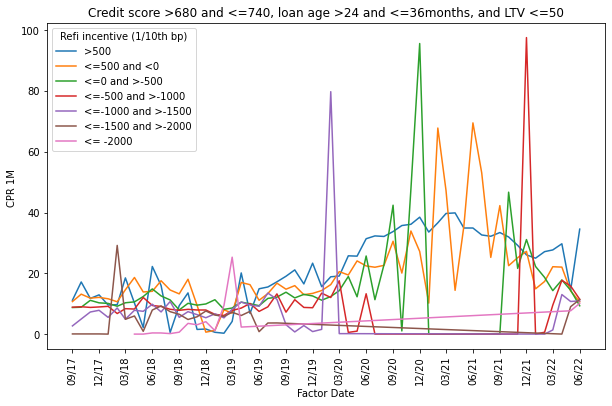

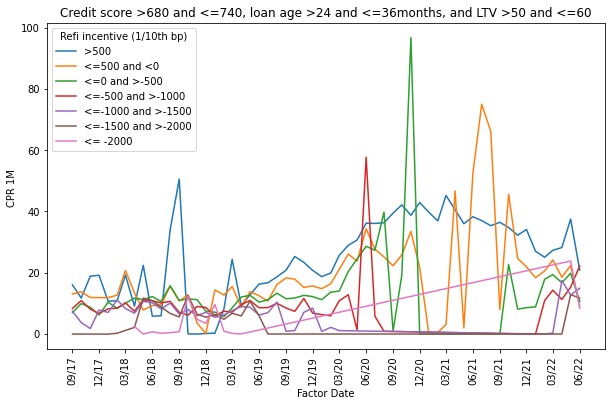

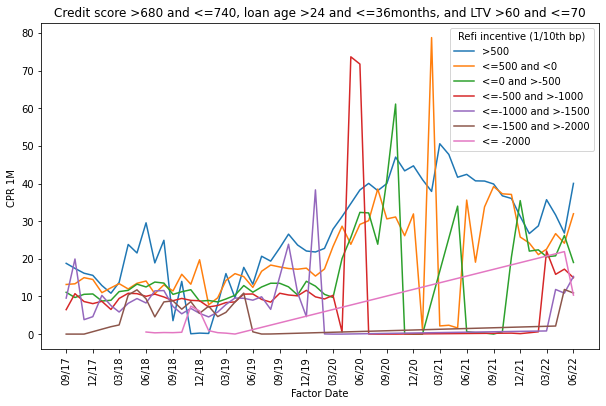

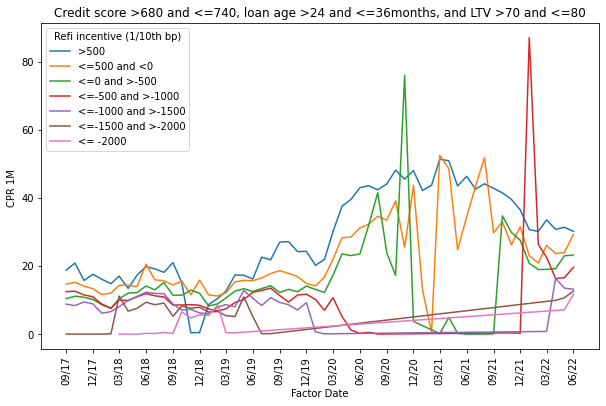

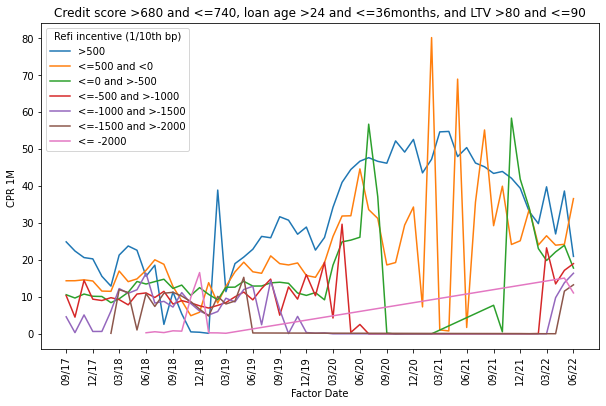

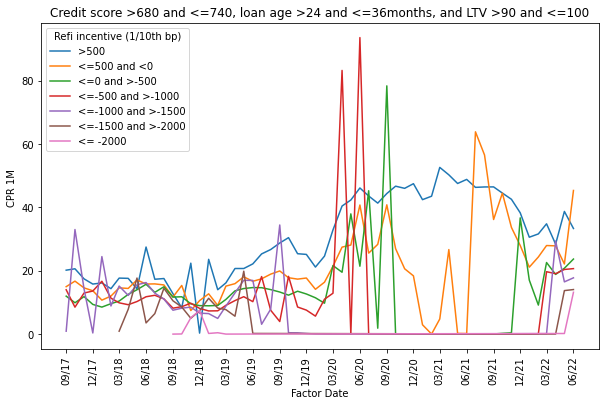

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_C_4_LTV[i][OTM_Large_C_4_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_C_4_LTV[i][(OTM_Large_C_4_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_C_4_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_C_4_LTV[i][(OTM_Large_C_4_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_C_4_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_C_4_LTV[i][(OTM_Large_C_4_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_C_4_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_C_4_LTV[i][(OTM_Large_C_4_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_C_4_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_C_4_LTV[i][(OTM_Large_C_4_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_C_4_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_C_4_LTV[i][OTM_Large_C_4_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[2] + ', loan age ' + LoanAge_buckets[3] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


### Loan age $>36$ and $\leq 48$ months and all LTVs

<Figure size 432x288 with 0 Axes>

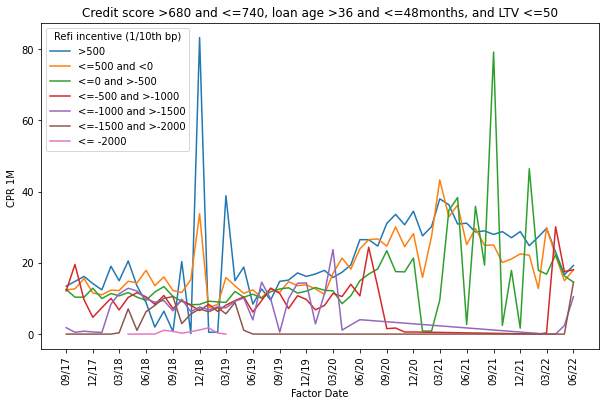

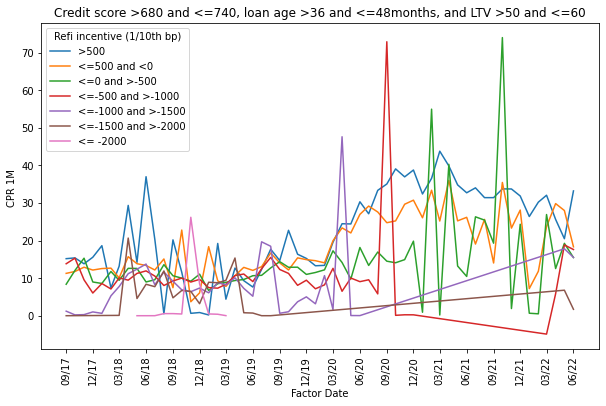

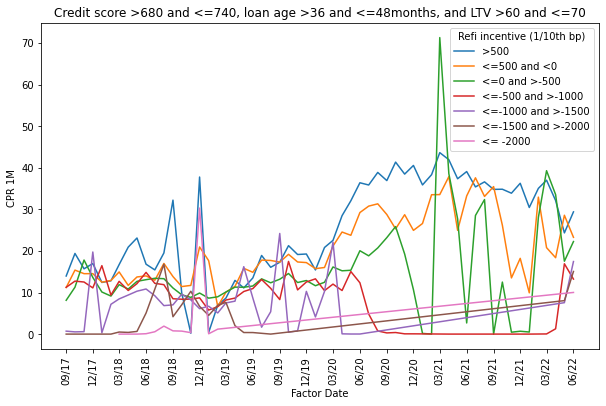

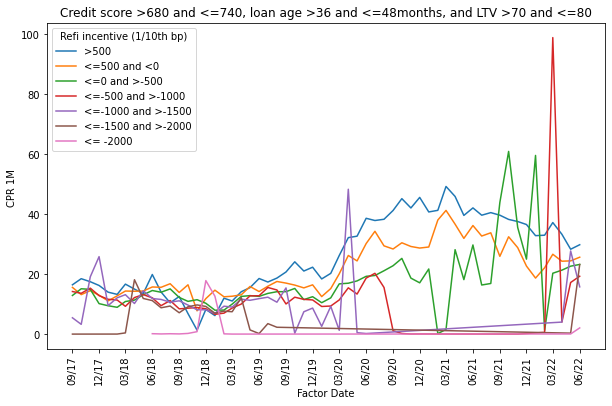

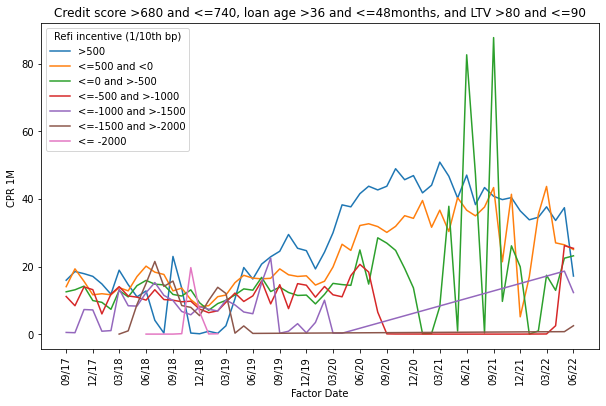

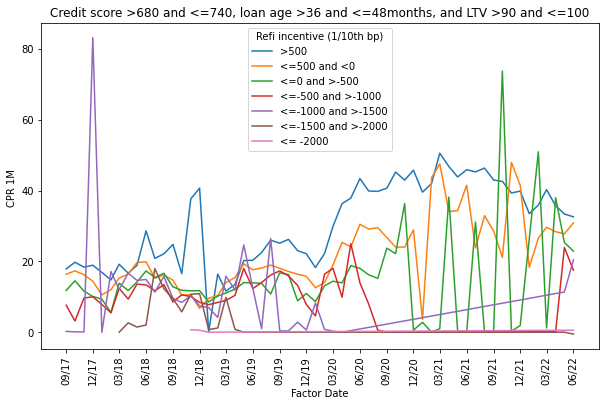

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_C_5_LTV[i][OTM_Large_C_5_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_C_5_LTV[i][(OTM_Large_C_5_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_C_5_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_C_5_LTV[i][(OTM_Large_C_5_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_C_5_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_C_5_LTV[i][(OTM_Large_C_5_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_C_5_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_C_5_LTV[i][(OTM_Large_C_5_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_C_5_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_C_5_LTV[i][(OTM_Large_C_5_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_C_5_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_C_5_LTV[i][OTM_Large_C_5_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[2] + ', loan age ' + LoanAge_buckets[4] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


### Loan age $>48$ and $\leq 60$ months and all LTVs

<Figure size 432x288 with 0 Axes>

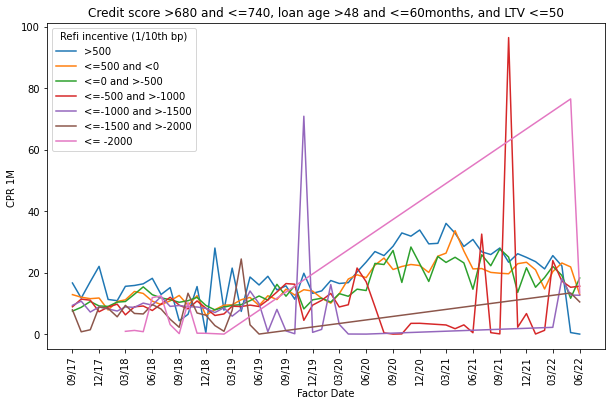

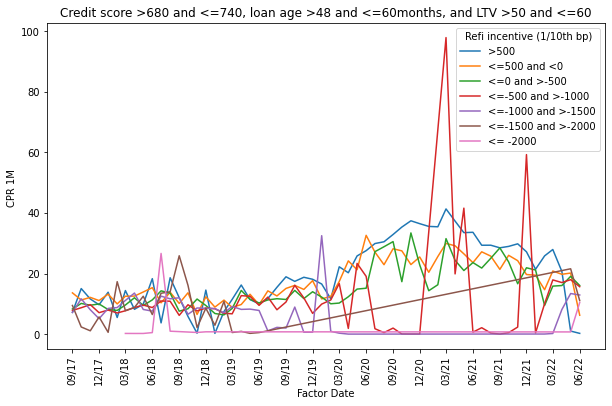

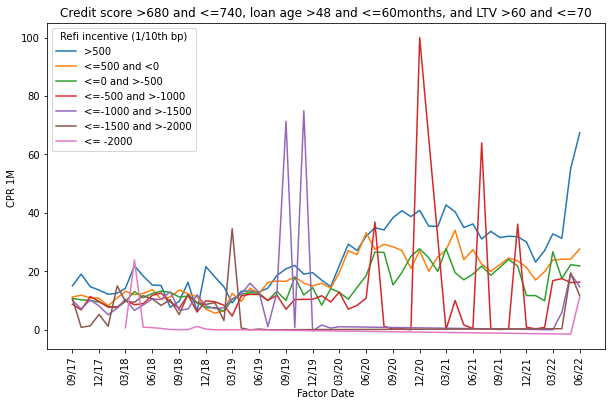

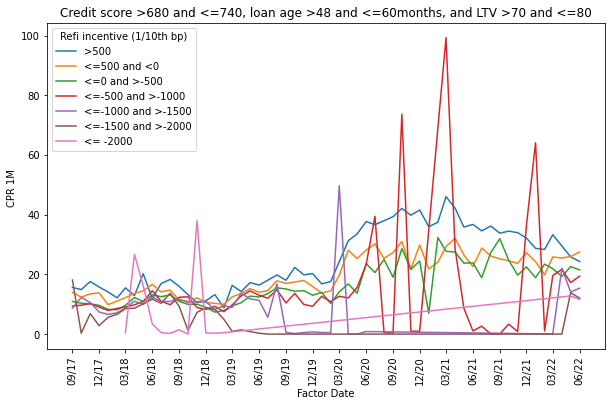

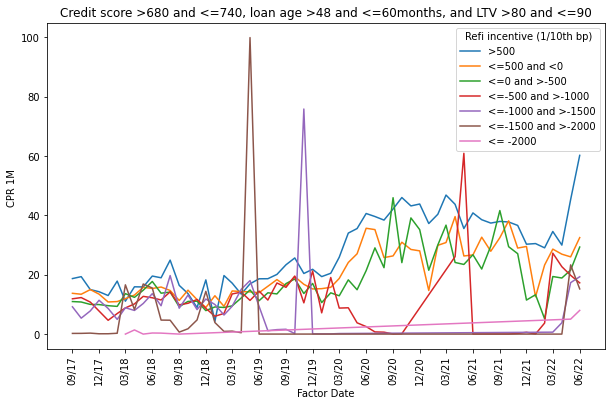

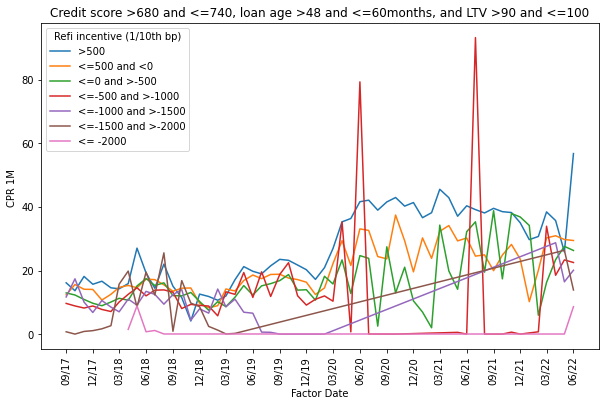

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_C_6_LTV[i][OTM_Large_C_6_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_C_6_LTV[i][(OTM_Large_C_6_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_C_6_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_C_6_LTV[i][(OTM_Large_C_6_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_C_6_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_C_6_LTV[i][(OTM_Large_C_6_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_C_6_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_C_6_LTV[i][(OTM_Large_C_6_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_C_6_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_C_6_LTV[i][(OTM_Large_C_6_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_C_6_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_C_6_LTV[i][OTM_Large_C_6_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[2] + ', loan age ' + LoanAge_buckets[5] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


### Loan age $>60$ months and all LTVs

<Figure size 432x288 with 0 Axes>

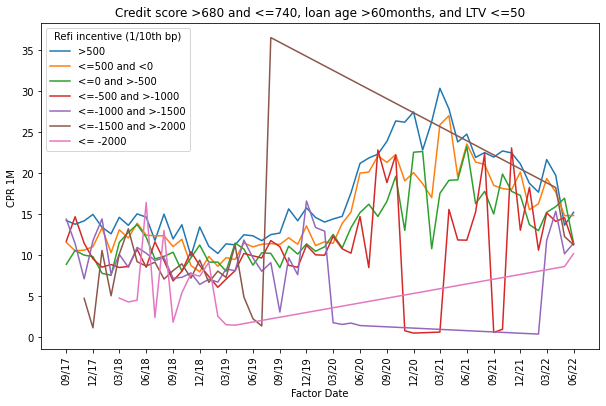

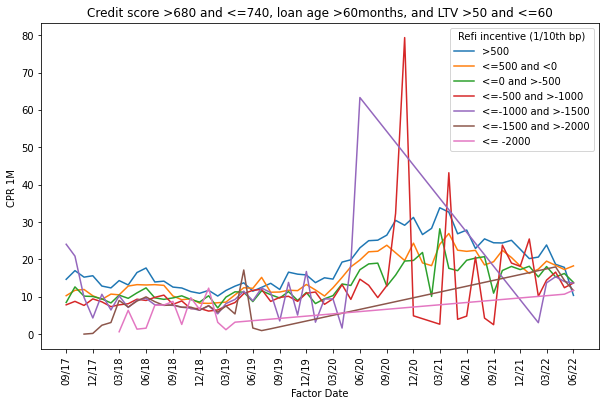

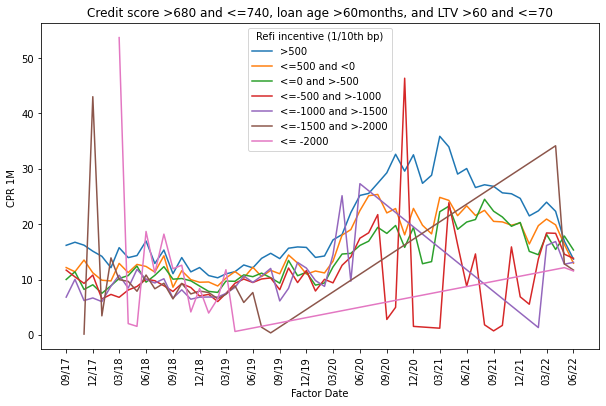

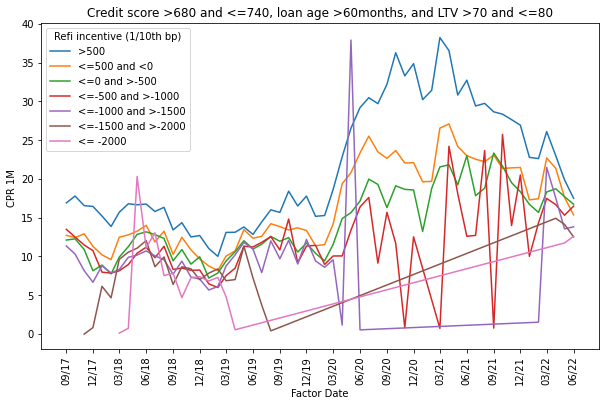

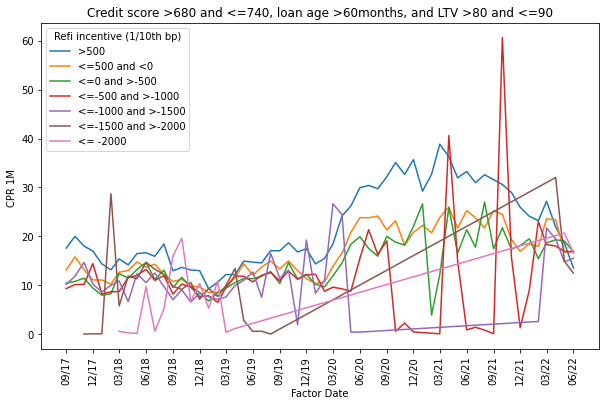

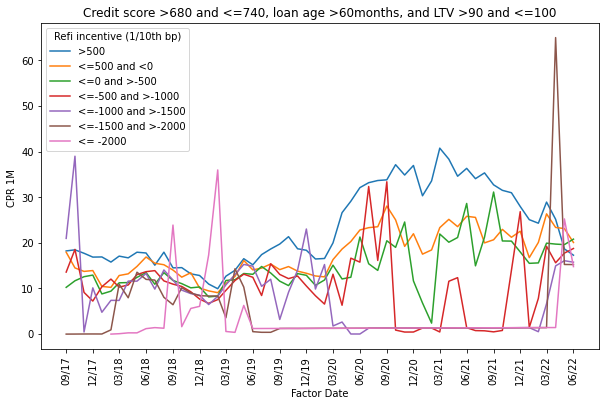

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_C_7_LTV[i][OTM_Large_C_7_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_C_7_LTV[i][(OTM_Large_C_7_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_C_7_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_C_7_LTV[i][(OTM_Large_C_7_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_C_7_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_C_7_LTV[i][(OTM_Large_C_7_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_C_7_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_C_7_LTV[i][(OTM_Large_C_7_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_C_7_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_C_7_LTV[i][(OTM_Large_C_7_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_C_7_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_C_7_LTV[i][OTM_Large_C_7_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[2] + ', loan age ' + LoanAge_buckets[6] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


## Credit score $>740$ (Bucket D)

### Loan Age $\leq 6$ months and all LTVs

<Figure size 432x288 with 0 Axes>

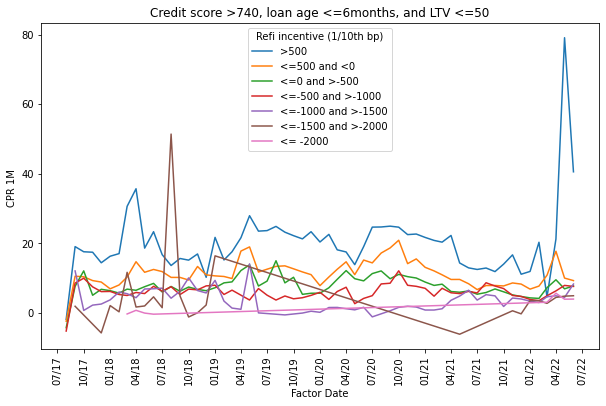

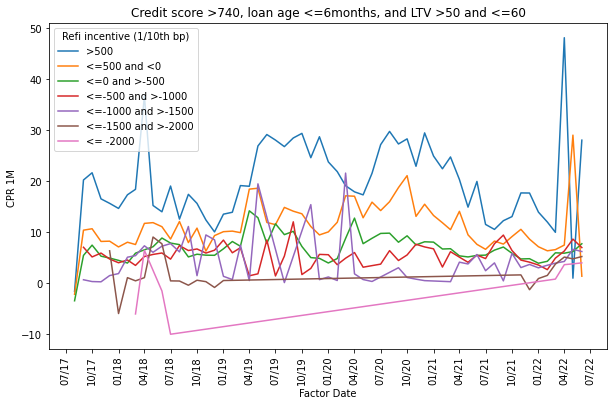

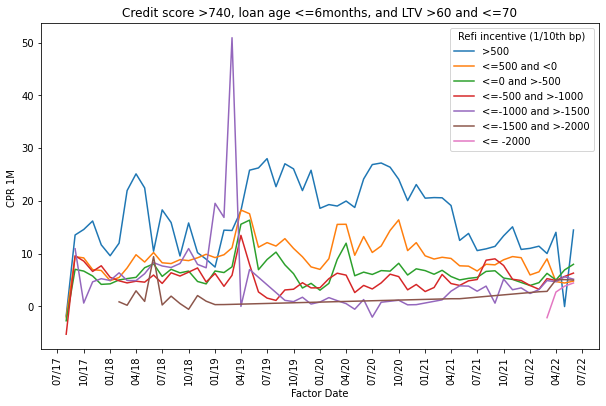

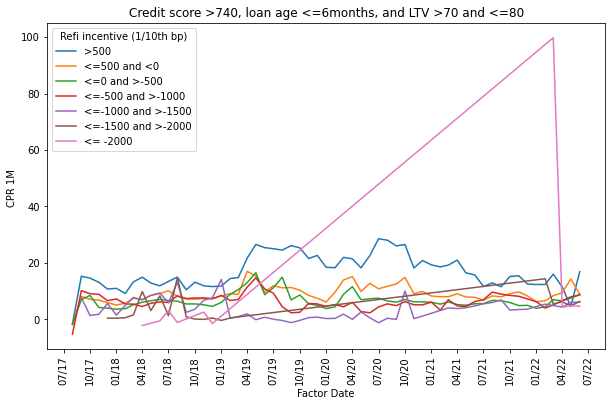

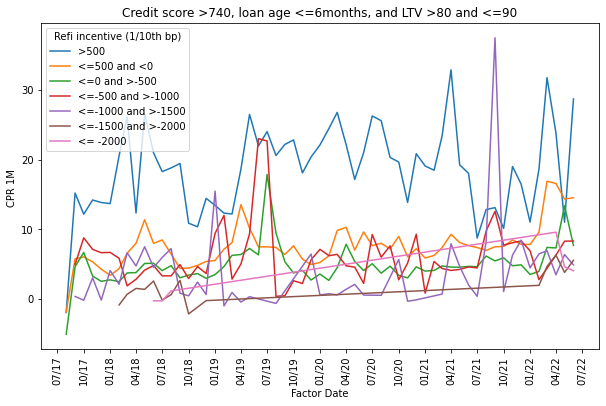

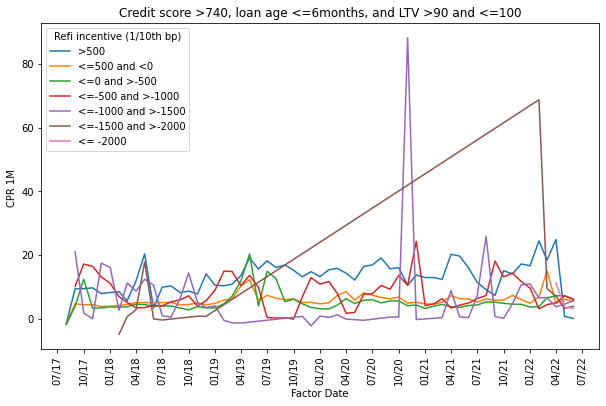

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_D_1_LTV[i][OTM_Large_D_1_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_D_1_LTV[i][(OTM_Large_D_1_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_D_1_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_D_1_LTV[i][(OTM_Large_D_1_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_D_1_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_D_1_LTV[i][(OTM_Large_D_1_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_D_1_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_D_1_LTV[i][(OTM_Large_D_1_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_D_1_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_D_1_LTV[i][(OTM_Large_D_1_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_D_1_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_D_1_LTV[i][OTM_Large_D_1_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[3] + ', loan age ' + LoanAge_buckets[0] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

### Loan age $>6$ and $\leq 12$ months and all LTVs

<Figure size 432x288 with 0 Axes>

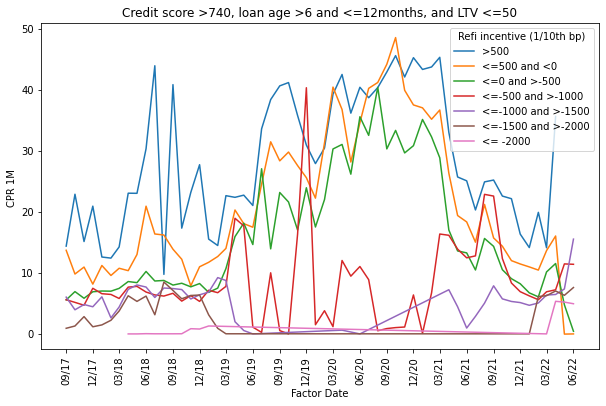

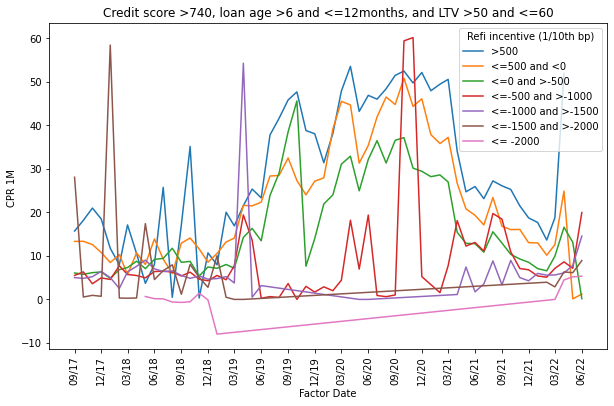

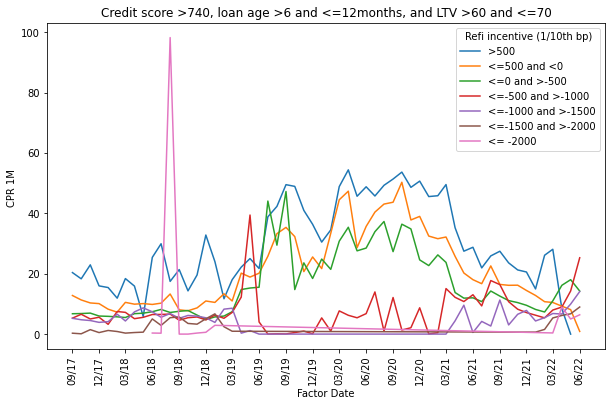

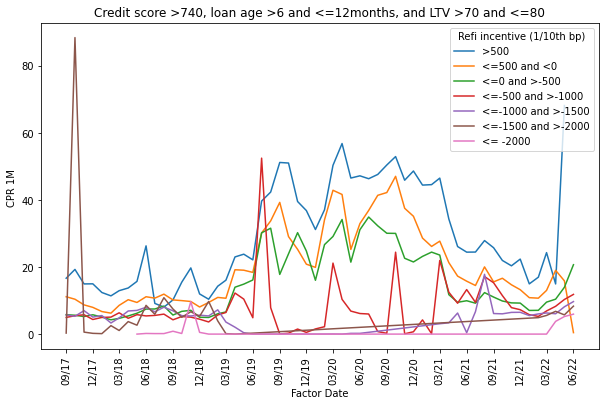

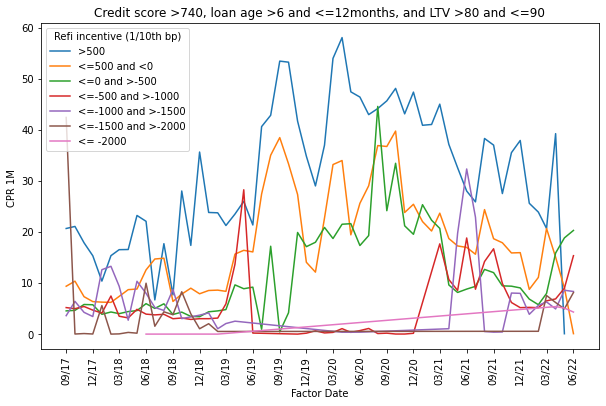

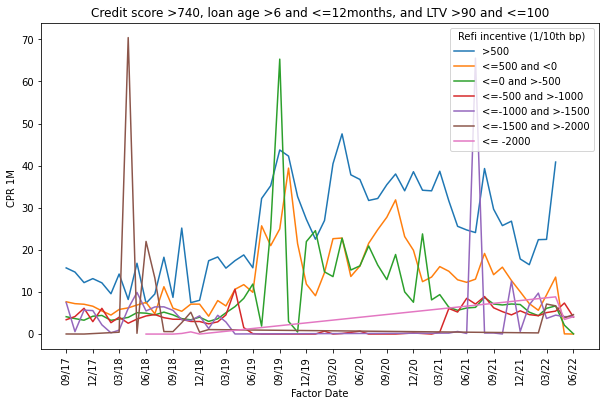

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_D_2_LTV[i][OTM_Large_D_2_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_D_2_LTV[i][(OTM_Large_D_2_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_D_2_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_D_2_LTV[i][(OTM_Large_D_2_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_D_2_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_D_2_LTV[i][(OTM_Large_D_2_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_D_2_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_D_2_LTV[i][(OTM_Large_D_2_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_D_2_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_D_2_LTV[i][(OTM_Large_D_2_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_D_2_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_D_2_LTV[i][OTM_Large_D_2_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[3] + ', loan age ' + LoanAge_buckets[1] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


### Loan age $>12$ and $\leq 24$ months and all LTVs


<Figure size 432x288 with 0 Axes>

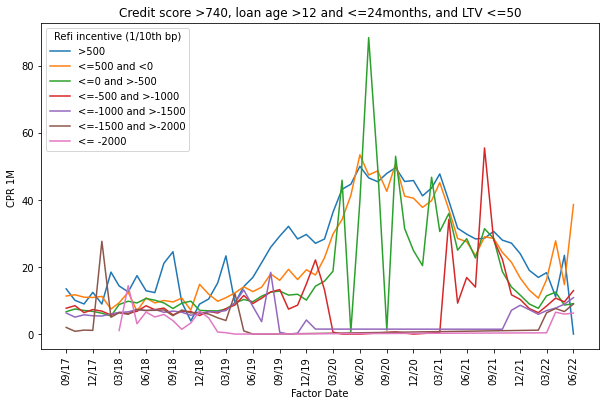

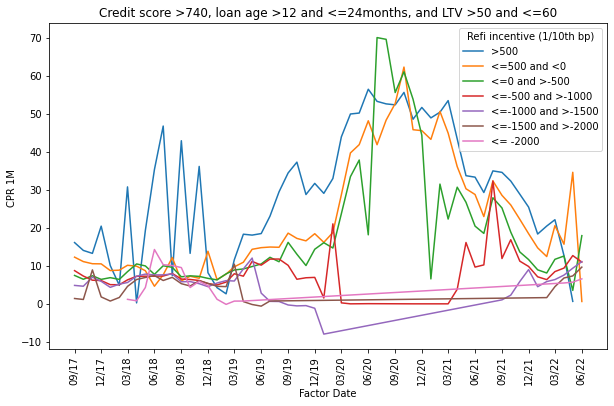

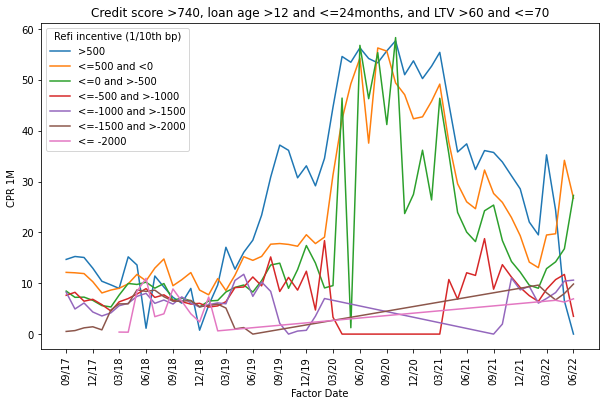

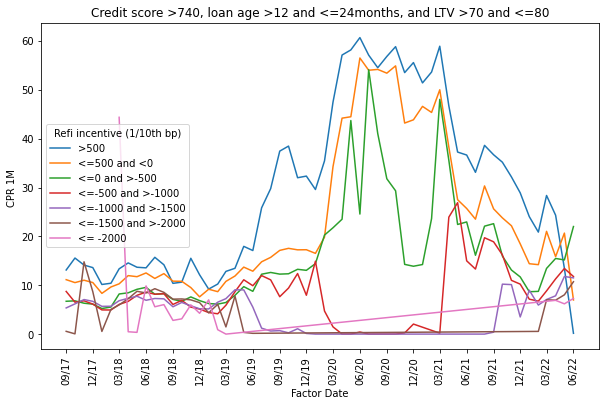

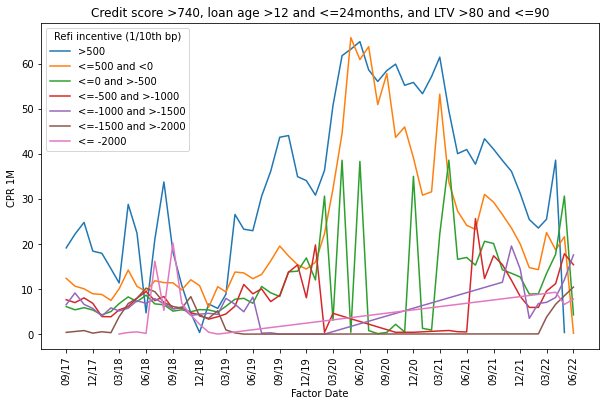

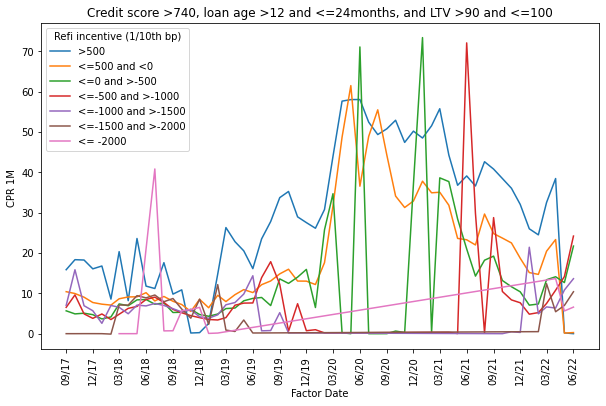

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_D_3_LTV[i][OTM_Large_D_3_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_D_3_LTV[i][(OTM_Large_D_3_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_D_3_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_D_3_LTV[i][(OTM_Large_D_3_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_D_3_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_D_3_LTV[i][(OTM_Large_D_3_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_D_3_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_D_3_LTV[i][(OTM_Large_D_3_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_D_3_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_D_3_LTV[i][(OTM_Large_D_3_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_D_3_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_D_3_LTV[i][OTM_Large_D_3_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[3] + ', loan age ' + LoanAge_buckets[2] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)

### Loan age $>24$ and $\leq 36$ months and all LTVs

<Figure size 432x288 with 0 Axes>

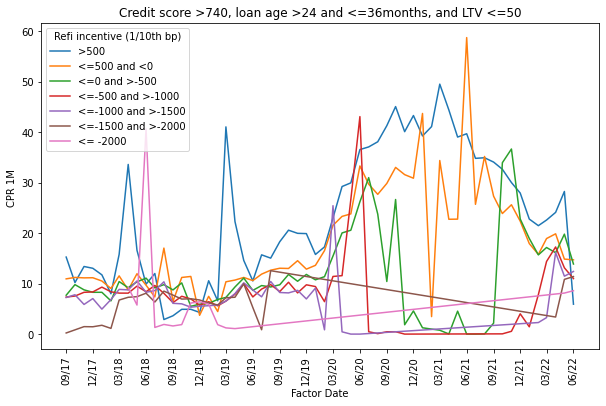

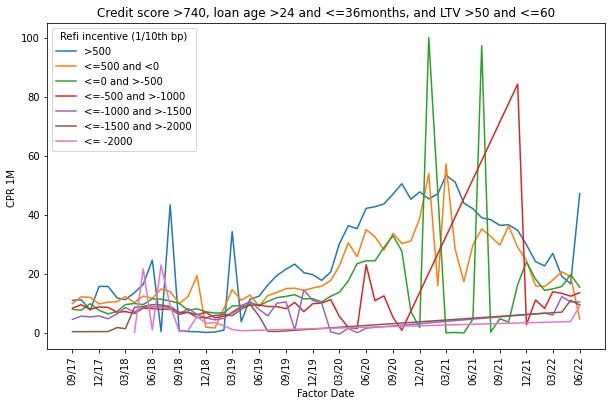

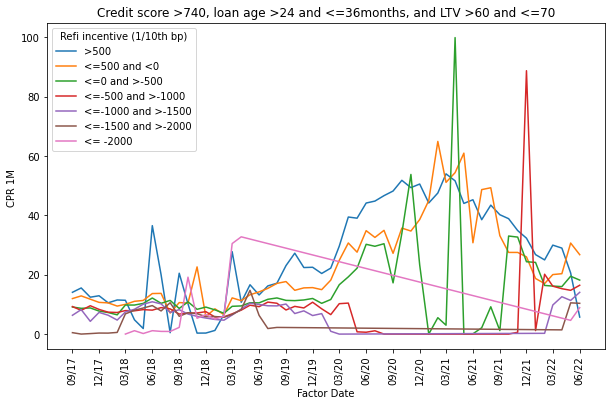

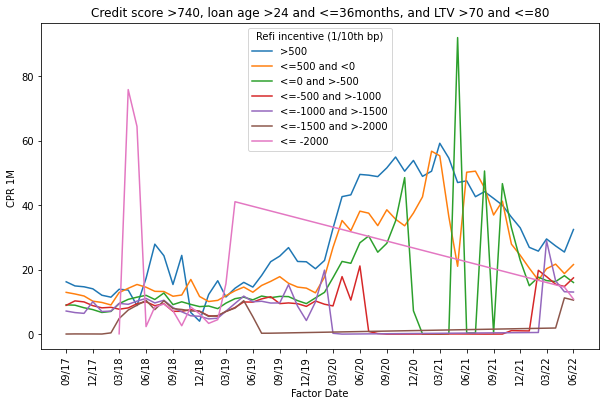

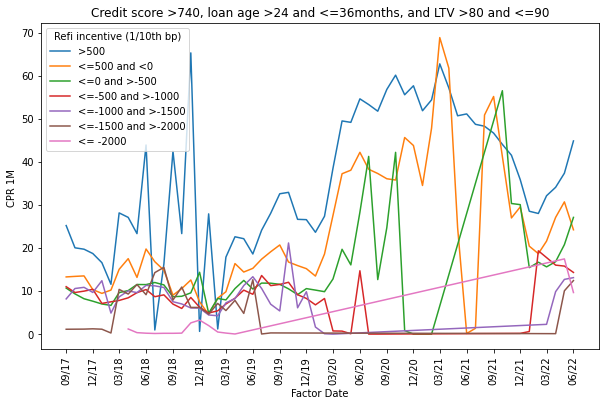

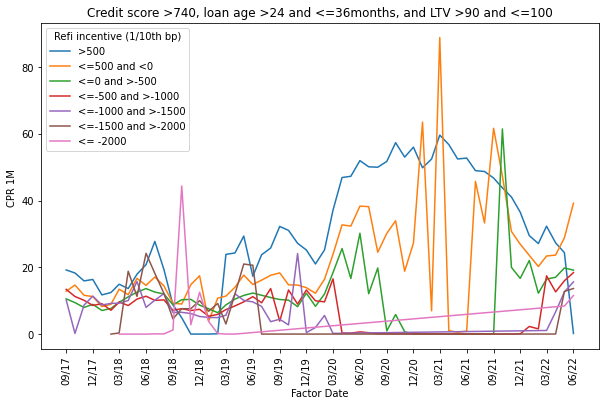

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_D_4_LTV[i][OTM_Large_D_4_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_D_4_LTV[i][(OTM_Large_D_4_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_D_4_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_D_4_LTV[i][(OTM_Large_D_4_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_D_4_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_D_4_LTV[i][(OTM_Large_D_4_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_D_4_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_D_4_LTV[i][(OTM_Large_D_4_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_D_4_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_D_4_LTV[i][(OTM_Large_D_4_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_D_4_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_D_4_LTV[i][OTM_Large_D_4_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[3] + ', loan age ' + LoanAge_buckets[3] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


### Loan age $>36$ and $\leq 48$ months and all LTVs

<Figure size 432x288 with 0 Axes>

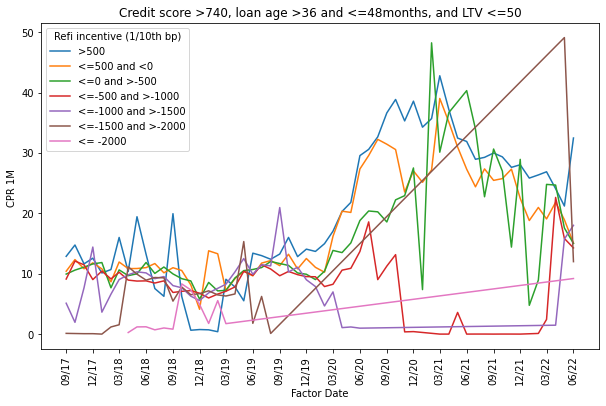

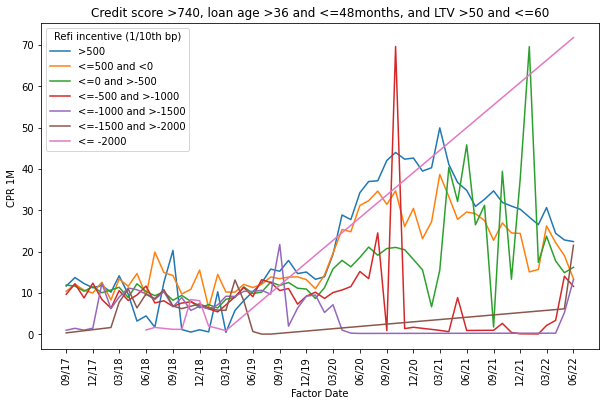

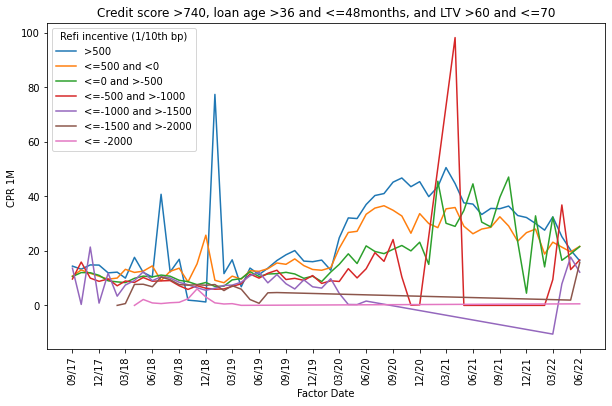

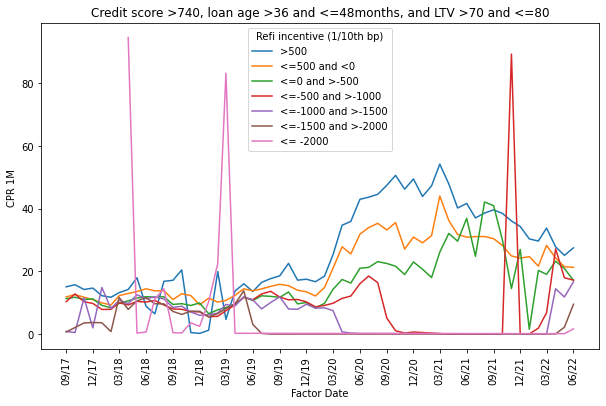

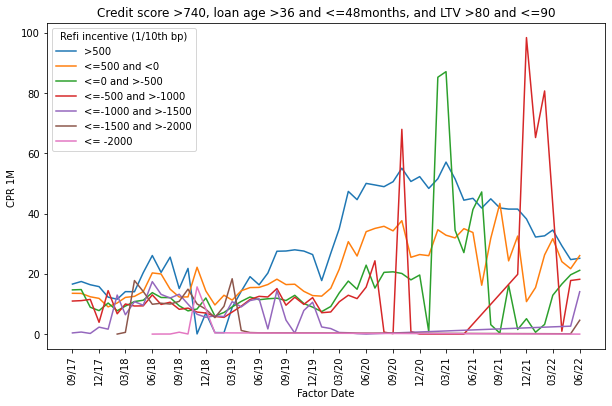

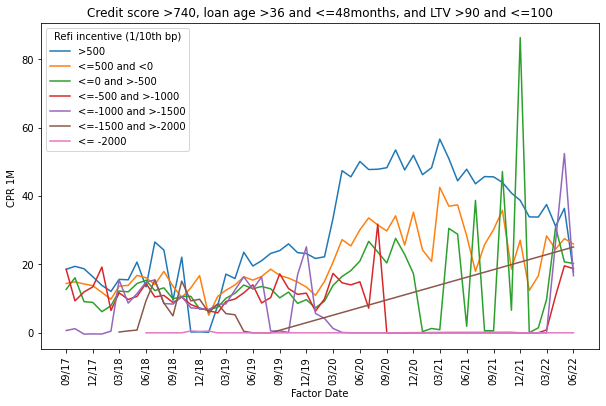

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_D_5_LTV[i][OTM_Large_D_5_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_D_5_LTV[i][(OTM_Large_D_5_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_D_5_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_D_5_LTV[i][(OTM_Large_D_5_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_D_5_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_D_5_LTV[i][(OTM_Large_D_5_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_D_5_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_D_5_LTV[i][(OTM_Large_D_5_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_D_5_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_D_5_LTV[i][(OTM_Large_D_5_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_D_5_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_D_5_LTV[i][OTM_Large_D_5_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[3] + ', loan age ' + LoanAge_buckets[4] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


### Loan age $>48$ and $\leq 60$ months and all LTVs

<Figure size 432x288 with 0 Axes>

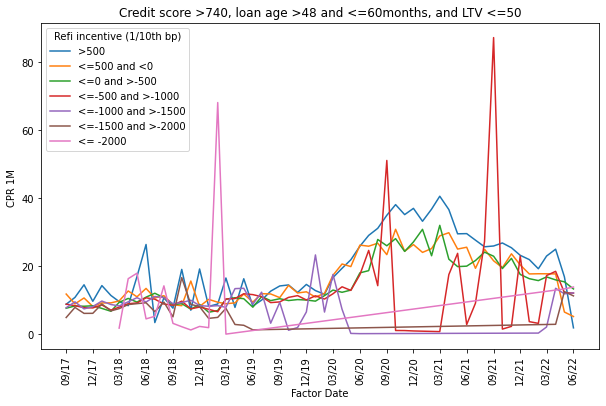

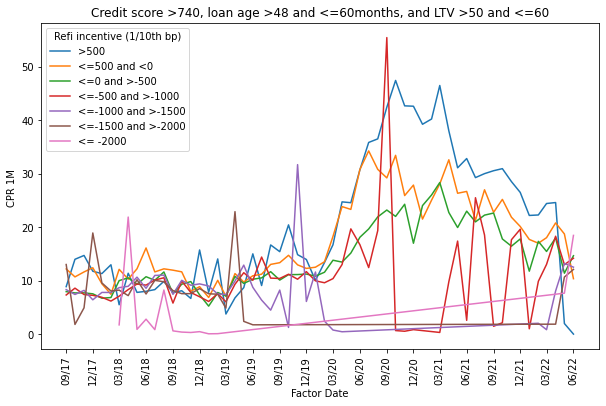

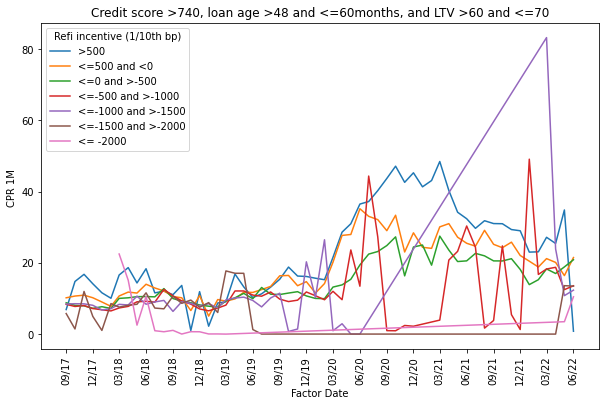

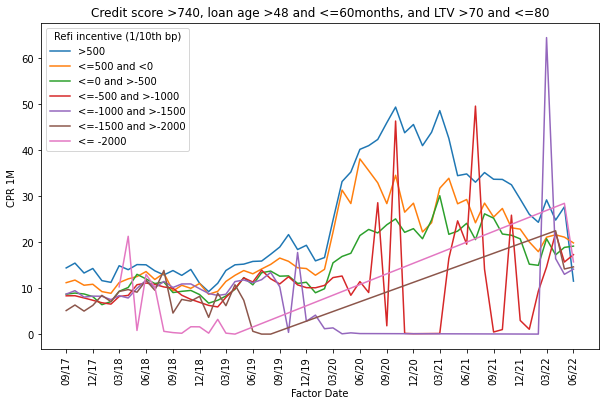

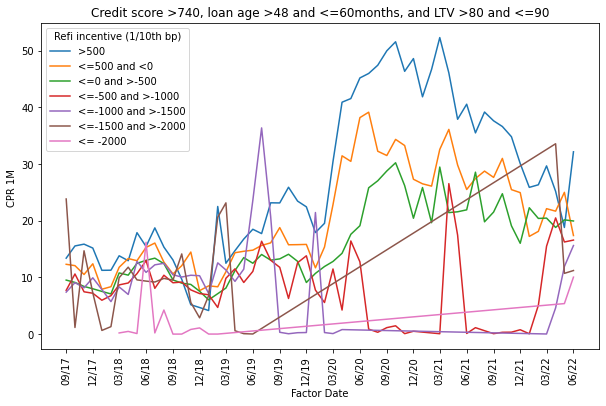

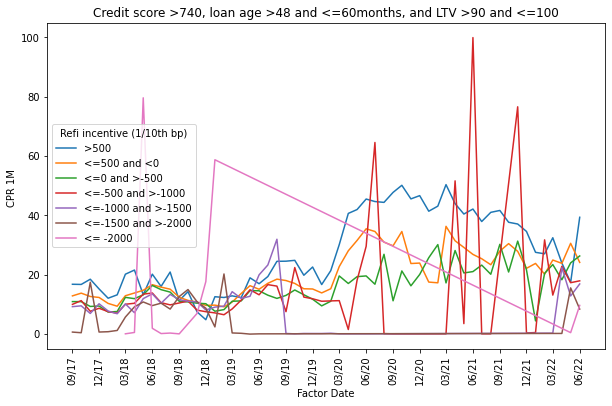

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_D_6_LTV[i][OTM_Large_D_6_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_D_6_LTV[i][(OTM_Large_D_6_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_D_6_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_D_6_LTV[i][(OTM_Large_D_6_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_D_6_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_D_6_LTV[i][(OTM_Large_D_6_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_D_6_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_D_6_LTV[i][(OTM_Large_D_6_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_D_6_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_D_6_LTV[i][(OTM_Large_D_6_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_D_6_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_D_6_LTV[i][OTM_Large_D_6_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[3] + ', loan age ' + LoanAge_buckets[5] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


### Loan age $>60$ months and all LTVs

<Figure size 432x288 with 0 Axes>

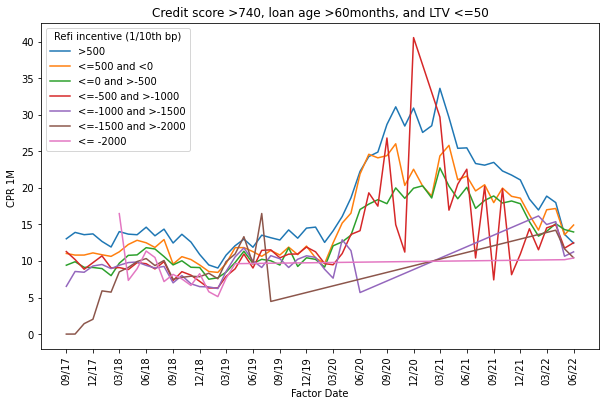

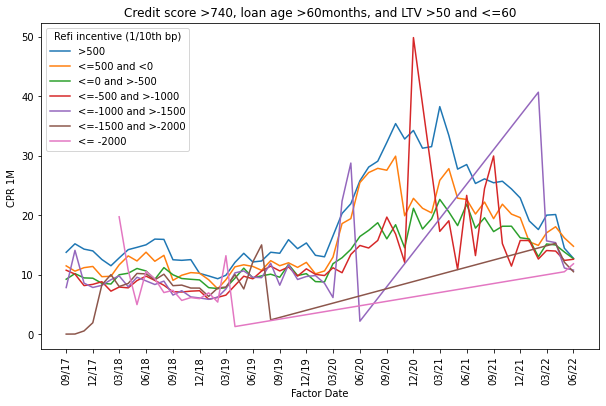

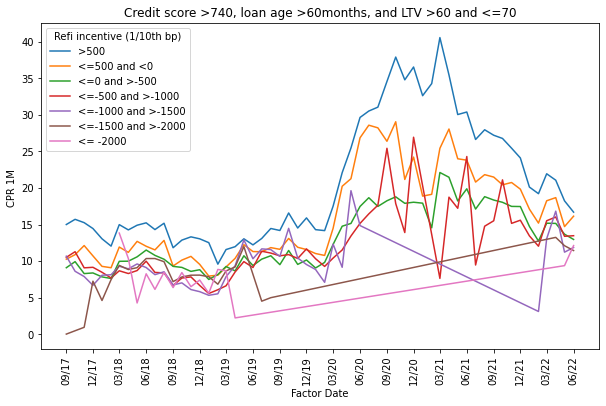

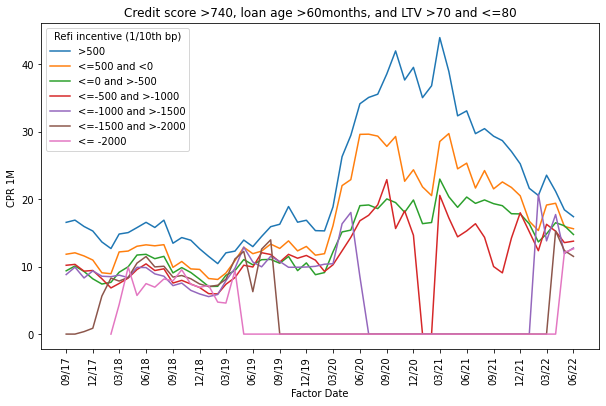

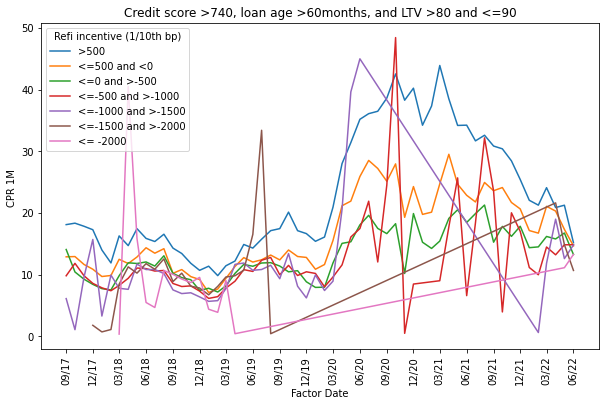

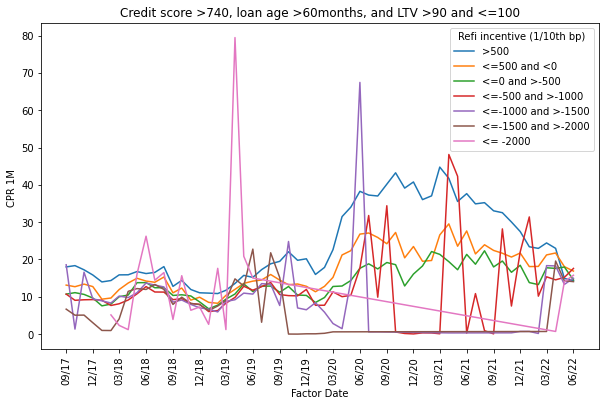

In [ ]:
for i in range(6):
  Incentive_pos5 = OTM_Large_D_7_LTV[i][OTM_Large_D_7_LTV[i]['Refi Incentive(1/10th bp)'] >500]
  Incentive_0 = OTM_Large_D_7_LTV[i][(OTM_Large_D_7_LTV[i]['Refi Incentive(1/10th bp)'] > 0) & (OTM_Large_D_7_LTV[i]['Refi Incentive(1/10th bp)'] <= 500)]
  Incentive_neg5 = OTM_Large_D_7_LTV[i][(OTM_Large_D_7_LTV[i]['Refi Incentive(1/10th bp)'] > -500) & (OTM_Large_D_7_LTV[i]['Refi Incentive(1/10th bp)'] <= 0)]
  Incentive_neg1 = OTM_Large_D_7_LTV[i][(OTM_Large_D_7_LTV[i]['Refi Incentive(1/10th bp)'] > -1000) & (OTM_Large_D_7_LTV[i]['Refi Incentive(1/10th bp)'] <=-500)]
  Incentive_neg15 = OTM_Large_D_7_LTV[i][(OTM_Large_D_7_LTV[i]['Refi Incentive(1/10th bp)']> -1500) & (OTM_Large_D_7_LTV[i]['Refi Incentive(1/10th bp)'] <=-1000)]
  Incentive_neg2 = OTM_Large_D_7_LTV[i][(OTM_Large_D_7_LTV[i]['Refi Incentive(1/10th bp)'] > -2000) & (OTM_Large_D_7_LTV[i]['Refi Incentive(1/10th bp)'] <=-1500)]
  Incentive_neg = OTM_Large_D_7_LTV[i][OTM_Large_D_7_LTV[i]['Refi Incentive(1/10th bp)'] <= -2000]
  
  plt.figure(i)
  fig, ax = plt.subplots(figsize=(10,6))
  sns.lineplot(data = Incentive_pos5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_0, x = 'Factor Date', y ='CPR 1M ')
  sns.lineplot(data = Incentive_neg5, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg1, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg15, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg2, x = 'Factor Date', y = 'CPR 1M ')
  sns.lineplot(data = Incentive_neg, x = 'Factor Date', y = 'CPR 1M ')
  plt.title('Credit score ' + CS_buckets[3] + ', loan age ' + LoanAge_buckets[6] + 'months, and LTV ' + LTV_buckets[i])
  plt.legend(labels = ['>500','<=500 and <0','<=0 and >-500','<=-500 and >-1000','<=-1000 and >-1500','<=-1500 and >-2000','<= -2000'], title ='Refi incentive (1/10th bp)')
  ax.xaxis.set_major_locator(MonthLocator(interval = 3))
  ax.xaxis.set_major_formatter(DateFormatter("%m/%y"))
  plt.xticks(rotation = 90)


We also made scatterplots and S-curves of the data broken into cohorts of credit score and then further into loan age, and also into cohorts of credit score and further into LTV. 

# Scatterplots broken down into credit score and loan age buckets. The multiple colors on the first scatterplots represent different LTVs

In [ ]:
A_list =  [[OTM_Large_A_1_LTV], [OTM_Large_A_2_LTV], [OTM_Large_A_3_LTV], [OTM_Large_A_4_LTV], [OTM_Large_A_5_LTV], [OTM_Large_A_6_LTV], [OTM_Large_A_7_LTV]]
B_list =  [[OTM_Large_B_1_LTV], [OTM_Large_B_2_LTV], [OTM_Large_B_3_LTV], [OTM_Large_B_4_LTV], [OTM_Large_B_5_LTV], [OTM_Large_B_6_LTV], [OTM_Large_B_7_LTV]]
C_list =  [[OTM_Large_C_1_LTV], [OTM_Large_C_2_LTV], [OTM_Large_C_3_LTV], [OTM_Large_C_4_LTV], [OTM_Large_C_5_LTV], [OTM_Large_C_6_LTV], [OTM_Large_C_7_LTV]]
D_list =  [[OTM_Large_D_1_LTV], [OTM_Large_D_2_LTV], [OTM_Large_D_3_LTV], [OTM_Large_D_4_LTV], [OTM_Large_D_5_LTV], [OTM_Large_D_6_LTV], [OTM_Large_D_7_LTV]]

In [ ]:
import scipy.optimize as opt
import matplotlib.pyplot as plt
from matplotlib.dates import MonthLocator, DateFormatter
from math import nan,isnan

## Credit score $\leq 550$ (Bucket A)







### Loan age $\leq 6$ months

Scatter plot and fitted S-curve of credit score $\leq 550$ and loan age $\leq 6$ months

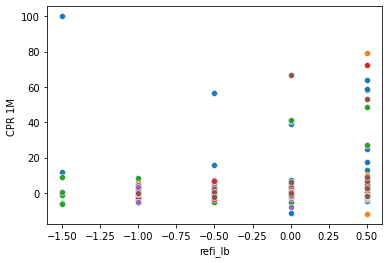

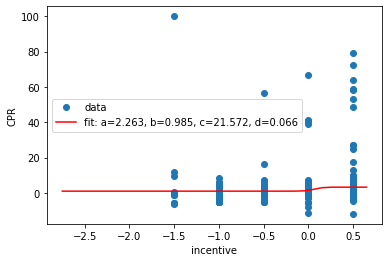

In [ ]:
def f(x, a, b, c, d):
    return a / (1. + np.exp(-c * (x - d))) + b

X = []
Y = []

for i in range(6):
  sns.scatterplot(data=OTM_Large_A_1_LTV[i], x = OTM_Large_A_1_LTV[i]['refi_lb'], y = OTM_Large_A_1_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_1_LTV[i]['refi_lb'])):
    X.append(OTM_Large_A_1_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_1_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_A_1_LTV[i]['CPR 1M '].iloc[k])

x = X
y = Y
xtest = np.arange(-2.75,.75,.1)
popt_A1, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_A1)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A1))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 6$ and $\leq 12$ months


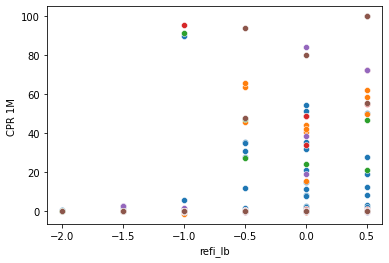

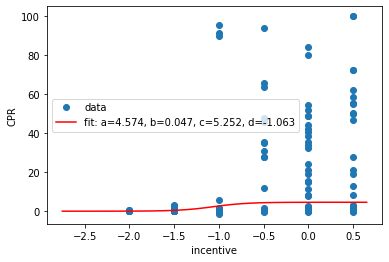

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_A_2_LTV[i], x = OTM_Large_A_2_LTV[i]['refi_lb'], y = OTM_Large_A_2_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_2_LTV[i]['refi_lb'])):
    X.append(OTM_Large_A_2_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_2_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_A_2_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_A2, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_A2)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A2))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 12$ and $\leq 24$ months

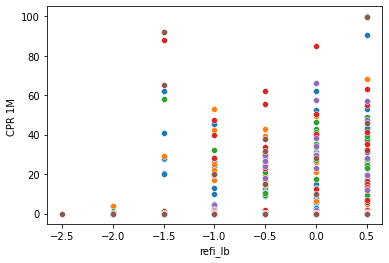

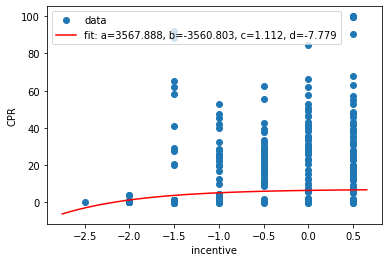

In [ ]:

X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_A_3_LTV[i], x = OTM_Large_A_3_LTV[i]['refi_lb'], y = OTM_Large_A_3_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_3_LTV[i]['refi_lb'])):
    X.append(OTM_Large_A_3_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_3_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_A_3_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_A3, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_A3)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A3))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 24$ and $\leq 36$ months

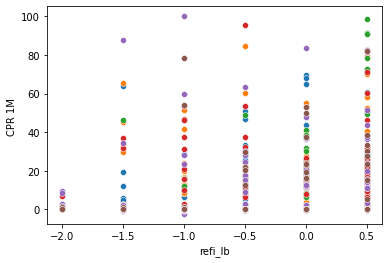

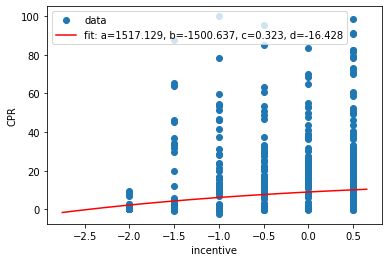

In [ ]:


X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_A_4_LTV[i], x = OTM_Large_A_4_LTV[i]['refi_lb'], y = OTM_Large_A_4_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_4_LTV[i]['refi_lb'])):
    X.append(OTM_Large_A_4_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_4_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_A_4_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_A4, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_A4)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A4))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 36$ and $\leq 48$ months

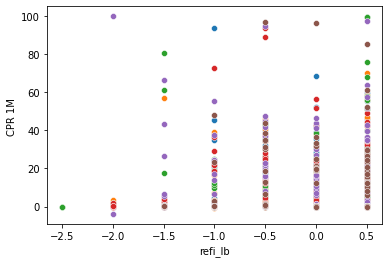

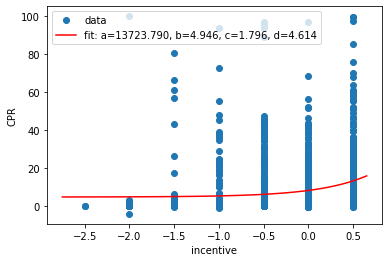

In [ ]:

X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_A_5_LTV[i], x = OTM_Large_A_5_LTV[i]['refi_lb'], y = OTM_Large_A_5_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_5_LTV[i]['refi_lb'])):
    X.append(OTM_Large_A_5_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_5_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_A_5_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_A5, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_A5)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A5))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 48$ and $\leq 60$ months

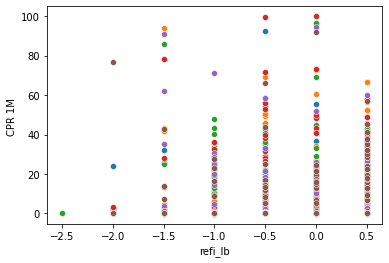

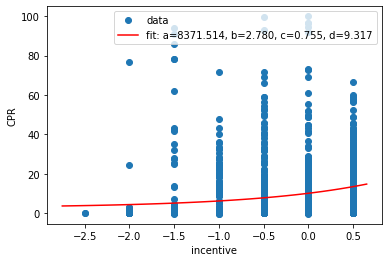

In [ ]:

X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_A_6_LTV[i], x = OTM_Large_A_6_LTV[i]['refi_lb'], y = OTM_Large_A_6_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_6_LTV[i]['refi_lb'])):
    X.append(OTM_Large_A_6_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_6_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_A_6_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_A6, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_A6)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A6))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 60$ months

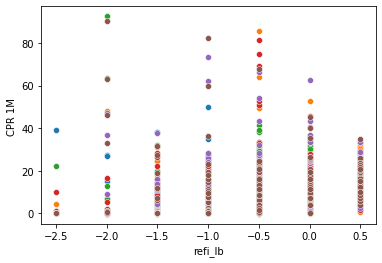

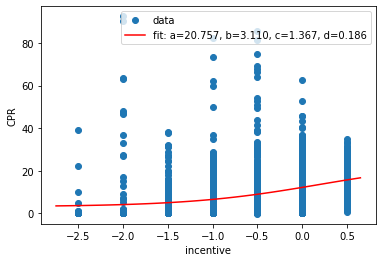

In [ ]:

X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_A_7_LTV[i], x = OTM_Large_A_7_LTV[i]['refi_lb'], y = OTM_Large_A_7_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_7_LTV[i]['refi_lb'])):
    X.append(OTM_Large_A_7_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_7_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_A_7_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_A7, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_A7)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A7))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

## Credit score $>550$ and $\leq 680$ (Bucket B)

### Loan age $\leq 6$ months

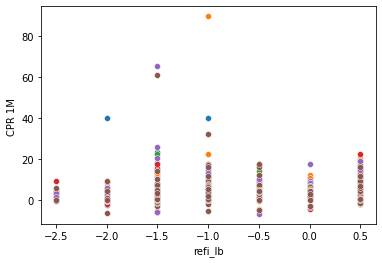

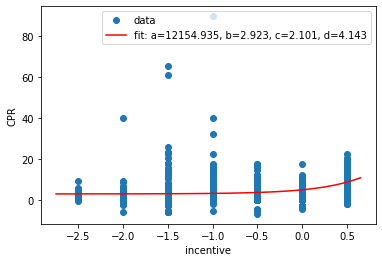

In [ ]:


X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_1_LTV[i], x = OTM_Large_B_1_LTV[i]['refi_lb'], y = OTM_Large_B_1_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_1_LTV[i]['refi_lb'])):
    X.append(OTM_Large_B_1_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_1_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_B_1_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_B1, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_B1)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B1))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 6$ and $\leq 12$ months

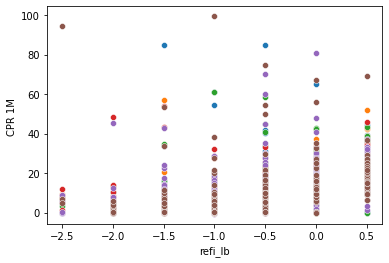

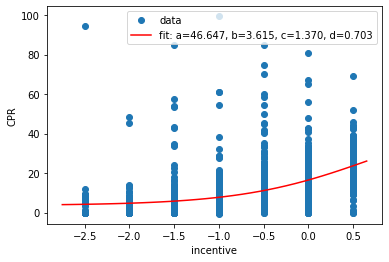

In [ ]:

X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_2_LTV[i], x = OTM_Large_B_2_LTV[i]['refi_lb'], y = OTM_Large_B_2_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_2_LTV[i]['refi_lb'])):
    X.append(OTM_Large_B_2_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_2_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_B_2_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_B2, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_B2)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B2))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 12$ and $\leq 24$ months

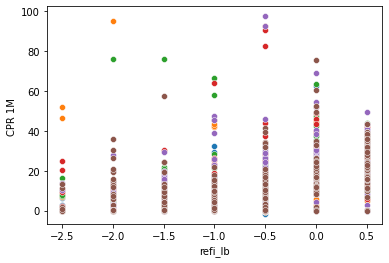

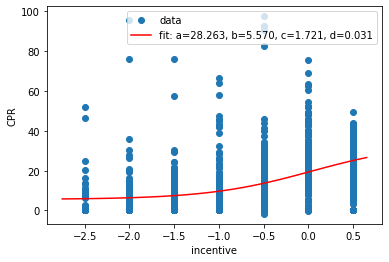

In [ ]:

X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_3_LTV[i], x = OTM_Large_B_3_LTV[i]['refi_lb'], y = OTM_Large_B_3_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_3_LTV[i]['refi_lb'])):
    X.append(OTM_Large_B_3_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_3_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_B_3_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_B3, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_B3)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B3))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 24$ and $\leq 36$ months

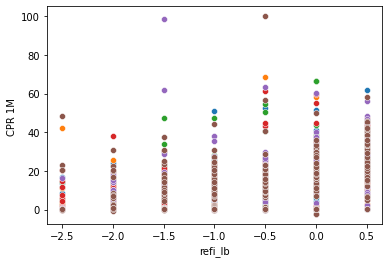

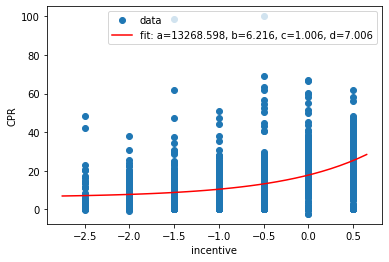

In [ ]:

X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_4_LTV[i], x = OTM_Large_B_4_LTV[i]['refi_lb'], y = OTM_Large_B_4_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_4_LTV[i]['refi_lb'])):
    X.append(OTM_Large_B_4_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_4_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_B_4_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_B4, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_B4)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B4))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 36$ and $\leq 48$ months

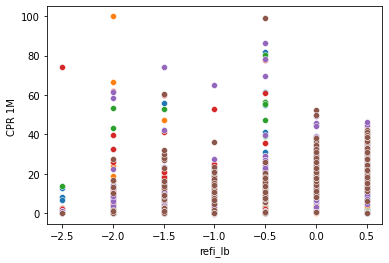

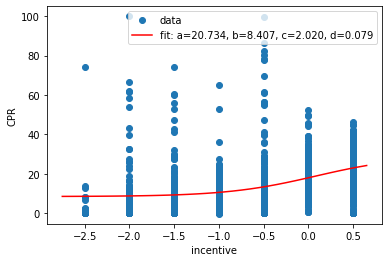

In [ ]:

X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_5_LTV[i], x = OTM_Large_B_5_LTV[i]['refi_lb'], y = OTM_Large_B_5_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_5_LTV[i]['refi_lb'])):
    X.append(OTM_Large_B_5_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_5_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_B_5_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_B5, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_B5)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B5))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 48$ and $\leq 60$ months

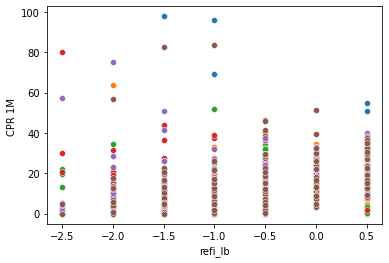

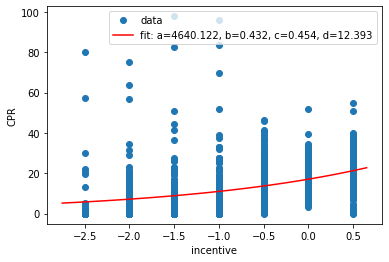

In [ ]:

X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_6_LTV[i], x = OTM_Large_B_6_LTV[i]['refi_lb'], y = OTM_Large_B_6_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_6_LTV[i]['refi_lb'])):
    X.append(OTM_Large_B_6_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_6_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_B_6_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_B6, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_B6)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B6))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $>60$ months

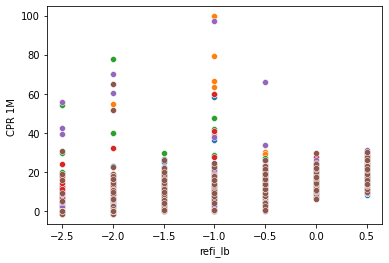

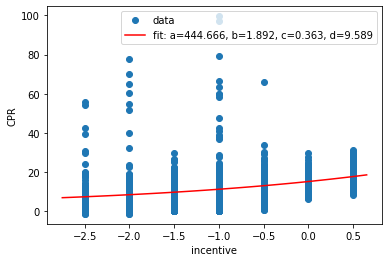

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_7_LTV[i], x = OTM_Large_B_7_LTV[i]['refi_lb'], y = OTM_Large_B_7_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_7_LTV[i]['refi_lb'])):
    X.append(OTM_Large_B_7_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_7_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_B_7_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_B7, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_B7)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B7))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

## Credit score $>680$ and $\leq 740$ (Bucket C)

### Loan age $\leq 6$ months

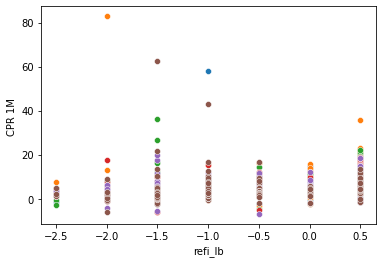

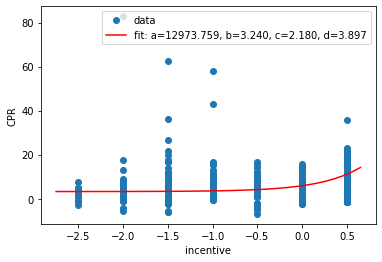

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_1_LTV[i], x = OTM_Large_C_1_LTV[i]['refi_lb'], y = OTM_Large_C_1_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_1_LTV[i]['refi_lb'])):
    X.append(OTM_Large_C_1_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_1_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_C_1_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_C1, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_C1)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C1))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 6$ and $\leq 12$ months

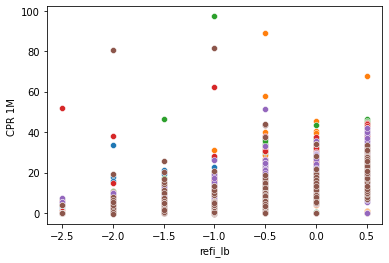

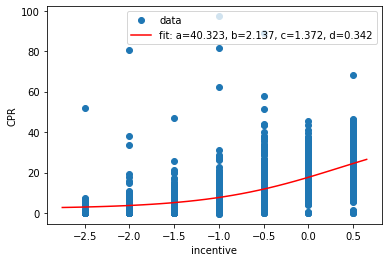

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_2_LTV[i], x = OTM_Large_C_2_LTV[i]['refi_lb'], y = OTM_Large_C_2_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_2_LTV[i]['refi_lb'])):
    X.append(OTM_Large_C_2_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_2_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_C_2_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_C2, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_C2)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C2))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 12$ and $\leq 24$ months

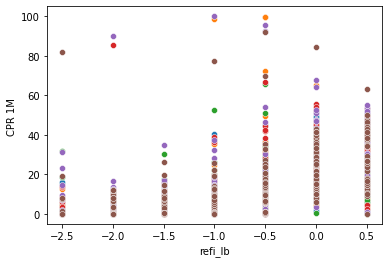

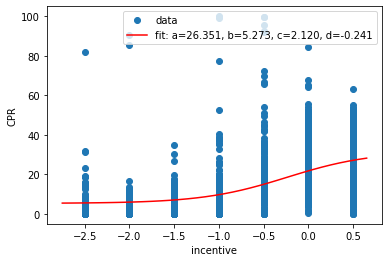

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_3_LTV[i], x = OTM_Large_C_3_LTV[i]['refi_lb'], y = OTM_Large_C_3_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_3_LTV[i]['refi_lb'])):
    X.append(OTM_Large_C_3_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_3_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_C_3_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_C3, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_C3)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C3))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 24$ and $\leq 36$ months

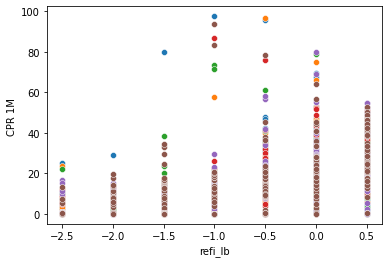

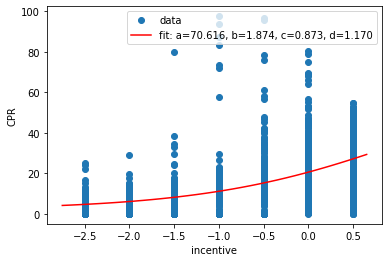

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_4_LTV[i], x = OTM_Large_C_4_LTV[i]['refi_lb'], y = OTM_Large_C_4_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_4_LTV[i]['refi_lb'])):
    X.append(OTM_Large_C_4_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_4_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_C_4_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_C4, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_C4)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C4))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 36$ and $\leq 48$ months

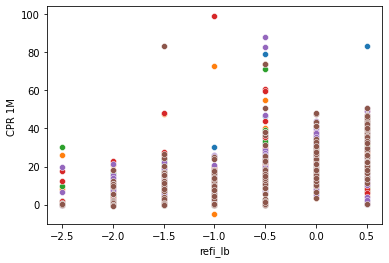

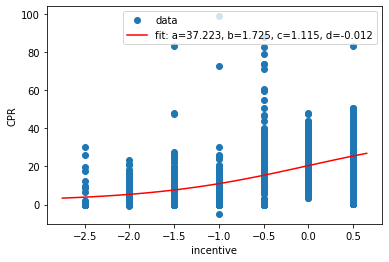

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_5_LTV[i], x = OTM_Large_C_5_LTV[i]['refi_lb'], y = OTM_Large_C_5_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_5_LTV[i]['refi_lb'])):
    X.append(OTM_Large_C_5_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_5_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_C_5_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_C5, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_C5)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C5))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 48$ and $\leq 60$ months

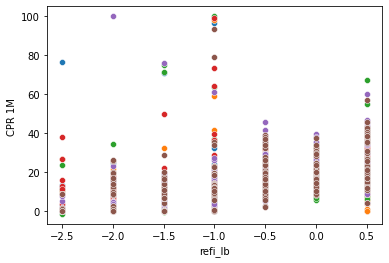

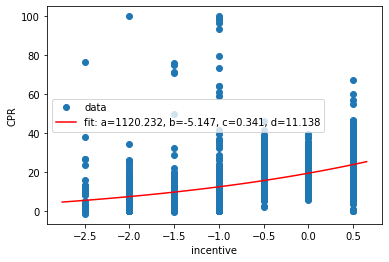

In [ ]:
X = []
Y = [] 
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_6_LTV[i], x = OTM_Large_C_6_LTV[i]['refi_lb'], y = OTM_Large_C_6_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_6_LTV[i]['refi_lb'])):
    X.append(OTM_Large_C_6_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_6_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_C_6_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_C6, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_C6)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C6))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 60$ months

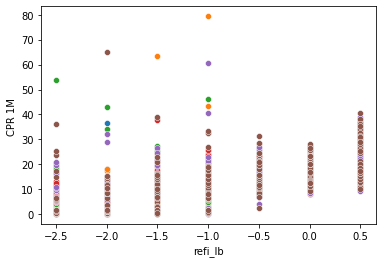

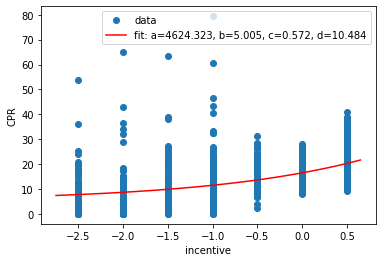

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_7_LTV[i], x = OTM_Large_C_7_LTV[i]['refi_lb'], y = OTM_Large_C_7_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_7_LTV[i]['refi_lb'])):
    X.append(OTM_Large_C_7_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_7_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_C_7_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_C7, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_C7)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C7))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

## Credit score $>740$ (Bucket D)

### Loan age $\leq 6$ months

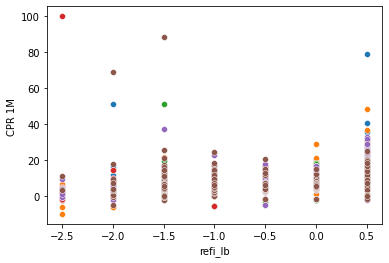

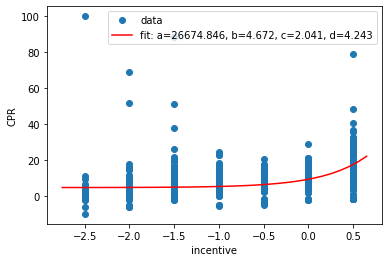

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_1_LTV[i], x = OTM_Large_D_1_LTV[i]['refi_lb'], y = OTM_Large_D_1_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_1_LTV[i]['refi_lb'])):
    X.append(OTM_Large_D_1_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_1_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_D_1_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_D1, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_D1)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D1))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 6$ and $\leq 12$ months

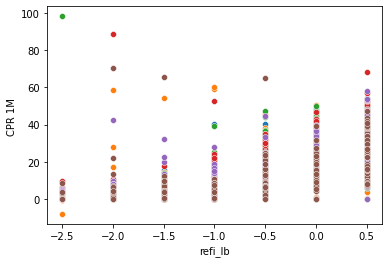

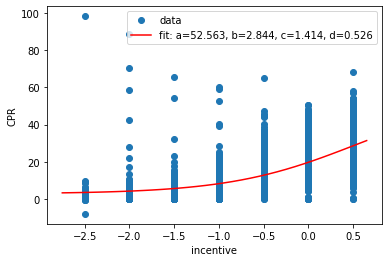

In [ ]:
X = [] 
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_2_LTV[i], x = OTM_Large_D_2_LTV[i]['refi_lb'], y = OTM_Large_D_2_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_2_LTV[i]['refi_lb'])):
    X.append(OTM_Large_D_2_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_2_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_D_2_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_D2, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_D2)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D2))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 12$ and $\leq 24$ months

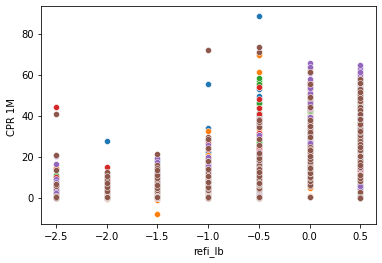

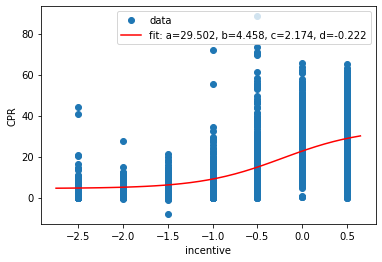

In [ ]:

X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_3_LTV[i], x = OTM_Large_D_3_LTV[i]['refi_lb'], y = OTM_Large_D_3_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_3_LTV[i]['refi_lb'])):
    X.append(OTM_Large_D_3_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_3_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_D_3_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_D3, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_D3)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D3))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 24$ and $\leq 36$ months

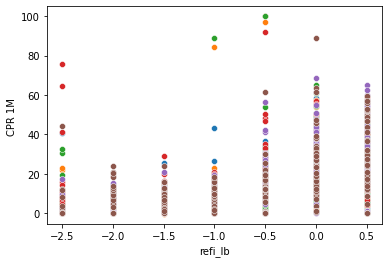

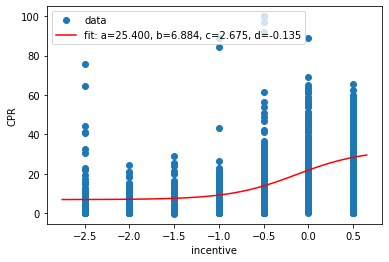

In [ ]:
X = [] 
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_4_LTV[i], x = OTM_Large_D_4_LTV[i]['refi_lb'], y = OTM_Large_D_4_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_4_LTV[i]['refi_lb'])):
    X.append(OTM_Large_D_4_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_4_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_D_4_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])

x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_D4, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_D4)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D4))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 36$ and $\leq 48$ months

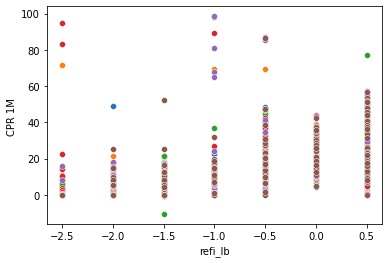

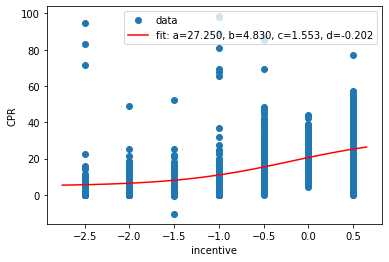

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_5_LTV[i], x = OTM_Large_D_5_LTV[i]['refi_lb'], y = OTM_Large_D_5_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_5_LTV[i]['refi_lb'])):
    X.append(OTM_Large_D_5_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_5_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_D_5_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_D5, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_D5)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D5))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 48$ and $\leq 60$ months

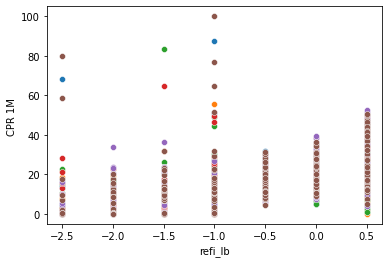

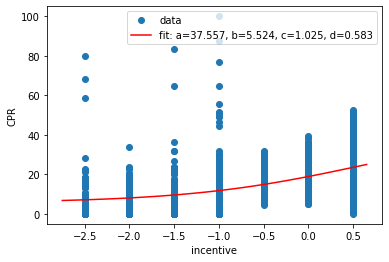

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_6_LTV[i], x = OTM_Large_D_6_LTV[i]['refi_lb'], y = OTM_Large_D_6_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_6_LTV[i]['refi_lb'])):
    X.append(OTM_Large_D_6_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_6_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_D_6_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_D6, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_D6)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D6))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Loan age $> 60$ months

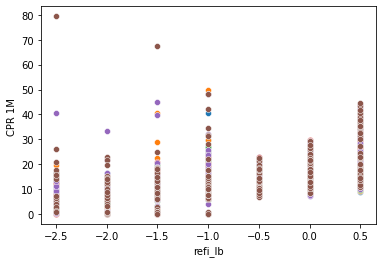

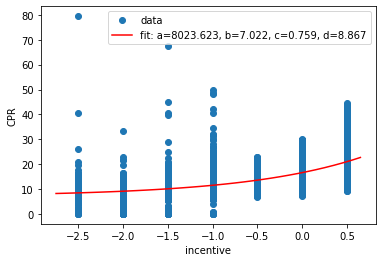

In [ ]:
X = [] 
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_7_LTV[i], x = OTM_Large_D_7_LTV[i]['refi_lb'], y = OTM_Large_D_7_LTV[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_7_LTV[i]['refi_lb'])):
    X.append(OTM_Large_D_7_LTV[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_7_LTV[i]['CPR 1M '])):
    Y.append(OTM_Large_D_7_LTV[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_D7, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_D7)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D7))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

## The S-curves for each loan age for a given credit bucket plotted together

Below we plot all the S-curves for different loan ages, but the same credit score together.

### Credit score $\leq 550$ (Bucket A)

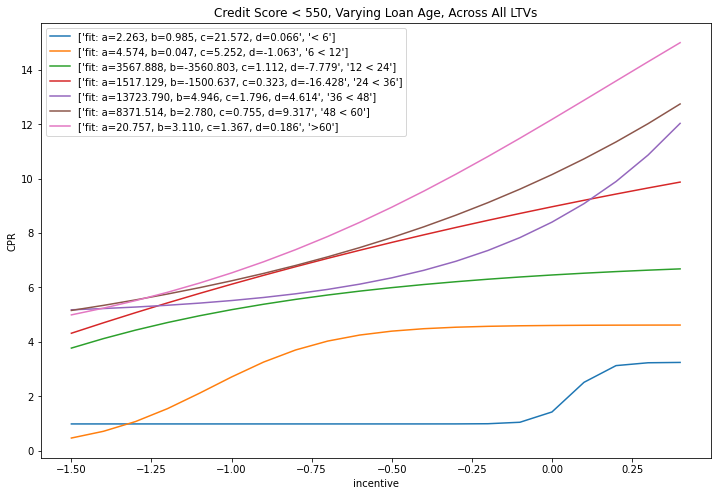

In [ ]:
xtest = np.arange(-1.5, 0.5,.1)
y_fit_A1 = f(xtest, *popt_A1)
y_fit_A2 = f(xtest, *popt_A2)
y_fit_A3 = f(xtest, *popt_A3)
y_fit_A4 = f(xtest, *popt_A4)
y_fit_A5 = f(xtest, *popt_A5)
y_fit_A6 = f(xtest, *popt_A6)
y_fit_A7 = f(xtest, *popt_A7)
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
ax.plot(xtest, y_fit_A1, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A1), '< 6'])
ax.plot(xtest, y_fit_A2, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A2), '6 < 12'])
ax.plot(xtest, y_fit_A3, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A3), '12 < 24'])
ax.plot(xtest, y_fit_A4, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A4), '24 < 36'])
ax.plot(xtest, y_fit_A5, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A5), '36 < 48'])
ax.plot(xtest, y_fit_A6, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A6), '48 < 60'])
ax.plot(xtest, y_fit_A7, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_A7), '>60'])
plt.title('Credit Score < 550, Varying Loan Age, Across All LTVs')
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Differences to give ranges based on Loan Age

In [ ]:
# At incentive = -2.5, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-2.5, *popt_A1)
OldLoan = f(-2.5, *popt_A7)
print('The range expected based on Loan Age when incentive is -2.5:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -2.5: 0.9846818931150324 to 3.6245447504876993


In [ ]:
# At incentive = -1.5, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-1.5, *popt_A1)
OldLoan = f(-1.5, *popt_A7)
print('The range expected based on Loan Age when incentive is -1.5:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -1.5: 0.9846818931150373 to 4.993044925124294


In [ ]:
# At incentive = -1, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-1, *popt_A1)
OldLoan = f(-1, *popt_A7)
print('The range expected based on Loan Age when incentive is -1:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -1: 0.9846818933485791 to 6.535582621893374


In [ ]:
# At incentive = -.5, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-.5, *popt_A1)
OldLoan = f(-.5, *popt_A7)
print('The range expected based on Loan Age when incentive is -2.5:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -2.5: 0.9846931825924583 to 8.950645130748203


### Credit score $>550$ and $\leq 680$ (Bucket B)

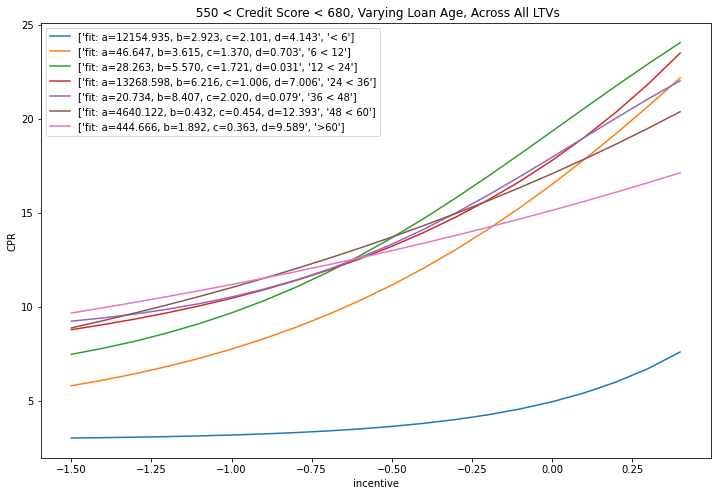

In [ ]:
xtest = np.arange(-1.5,0.5,.1)
y_fit_B1 = f(xtest, *popt_B1)
y_fit_B2 = f(xtest, *popt_B2)
y_fit_B3 = f(xtest, *popt_B3)
y_fit_B4 = f(xtest, *popt_B4)
y_fit_B5 = f(xtest, *popt_B5)
y_fit_B6 = f(xtest, *popt_B6)
y_fit_B7 = f(xtest, *popt_B7)
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
ax.plot(xtest, y_fit_B1, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B1), '< 6'])
ax.plot(xtest, y_fit_B2, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B2), '6 < 12'])
ax.plot(xtest, y_fit_B3, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B3), '12 < 24'])
ax.plot(xtest, y_fit_B4, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B4), '24 < 36'])
ax.plot(xtest, y_fit_B5, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B5), '36 < 48'])
ax.plot(xtest, y_fit_B6, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B6), '48 < 60'])
ax.plot(xtest, y_fit_B7, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_B7), '>60'])
plt.title(' 550 < Credit Score < 680, Varying Loan Age, Across All LTVs')
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Differences to give ranges based on Loan Age

In [ ]:
# At incentive = -2.5, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-2.5, *popt_B1)
OldLoan = f(-2.5, *popt_B7)
print('The range expected based on Loan Age when incentive is -2.5:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -2.5: 2.9334899598430977 to 7.323339223744606


In [ ]:
# At incentive = -1.5, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-1.5, *popt_B1)
OldLoan = f(-1.5, *popt_B7)
print('The range expected based on Loan Age when incentive is -1.5:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -1.5: 3.0090750387905087 to 9.661711190970276


In [ ]:
# At incentive = -1, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-1, *popt_B1)
OldLoan = f(-1, *popt_B7)
print('The range expected based on Loan Age when incentive is -1:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -1: 3.1692110590373717 to 11.177453325516082


In [ ]:
# At incentive = -.5, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-.5, *popt_B1)
OldLoan = f(-.5, *popt_B7)
print('The range expected based on Loan Age when incentive is -.5:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -.5: 3.6271069634864306 to 12.981379416111913


### Credit score $>680$ and $\leq 740$ (Bucket C)

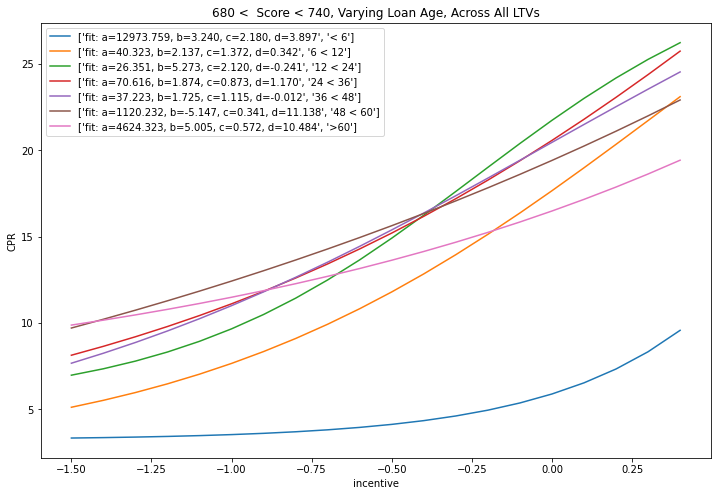

In [ ]:
xtest = np.arange(-1.5,0.5,.1)
y_fit_C1 = f(xtest, *popt_C1)
y_fit_C2 = f(xtest, *popt_C2)
y_fit_C3 = f(xtest, *popt_C3)
y_fit_C4 = f(xtest, *popt_C4)
y_fit_C5 = f(xtest, *popt_C5)
y_fit_C6 = f(xtest, *popt_C6)
y_fit_C7 = f(xtest, *popt_C7)
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
ax.plot(xtest, y_fit_C1, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C1), '< 6'])
ax.plot(xtest, y_fit_C2, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C2), '6 < 12'])
ax.plot(xtest, y_fit_C3, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C3), '12 < 24'])
ax.plot(xtest, y_fit_C4, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C4), '24 < 36'])
ax.plot(xtest, y_fit_C5, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C5), '36 < 48'])
ax.plot(xtest, y_fit_C6, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C6), '48 < 60'])
ax.plot(xtest, y_fit_C7, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C7), '>60'])
plt.title('680 <  Score < 740, Varying Loan Age, Across All LTVs')
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

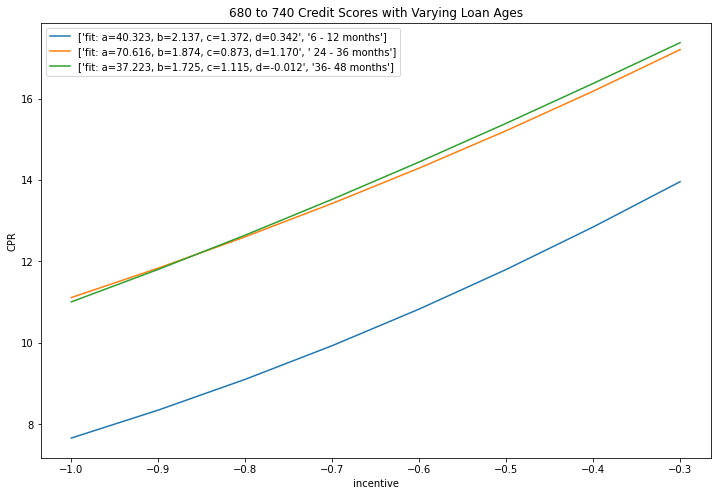

In [ ]:
xtest = np.arange(-1,-.25,.1)
y_fit_C1 = f(xtest, *popt_C1)
y_fit_C2 = f(xtest, *popt_C2)
y_fit_C3 = f(xtest, *popt_C3)
y_fit_C4 = f(xtest, *popt_C4)
y_fit_C5 = f(xtest, *popt_C5)
y_fit_C6 = f(xtest, *popt_C6)
y_fit_C7 = f(xtest, *popt_C7)
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
ax.plot(xtest, y_fit_C2, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C2), '6 - 12 months'])
ax.plot(xtest, y_fit_C4, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C4), ' 24 - 36 months'])
ax.plot(xtest, y_fit_C5, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_C5), '36- 48 months'])
plt.title('680 to 740 Credit Scores with Varying Loan Ages')
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Differences to give ranges based on Loan Age

In [ ]:
# At incentive = -2.5, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-2.5, *popt_C1)
OldLoan = f(-2.5, *popt_C7)
print('The range expected based on Loan Age when incentive is -2.5:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -2.5: 3.2518650904239594 to 7.758523280576661


In [ ]:
# At incentive = -1.5, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-1.5, *popt_C1)
OldLoan = f(-1.5, *popt_C7)
print('The range expected based on Loan Age when incentive is -1.5:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -1.5: 3.341262397207003 to 9.880997813811529


In [ ]:
# At incentive = -1, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-1, *popt_C1)
OldLoan = f(-1, *popt_C7)
print('The range expected based on Loan Age when incentive is -1:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -1: 3.5402202256043647 to 11.492817262823644


In [ ]:
# At incentive = -.5, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-.5, *popt_C1)
OldLoan = f(-.5, *popt_C7)
print('The range expected based on Loan Age when incentive is -.5:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -.5: 4.131876241603973 to 13.636443295694292


In [ ]:
print(f(-1.0, *popt_C1))
print(f(-1.0, *popt_C2))
print(f(-1.0, *popt_C4))
print(f(-1.0, *popt_C5))
print(f(-0.5, *popt_C1))
print(f(-0.5, *popt_C2))
print(f(-0.5, *popt_C4))
print(f(-0.5, *popt_C5))

3.5402202256043647
7.662122833599032
11.112461903184304
11.006931266199803
4.131876241603973
11.801909086079112
15.21070766009224
15.392416552502848


### Credit score $> 740$ (Bucket D)

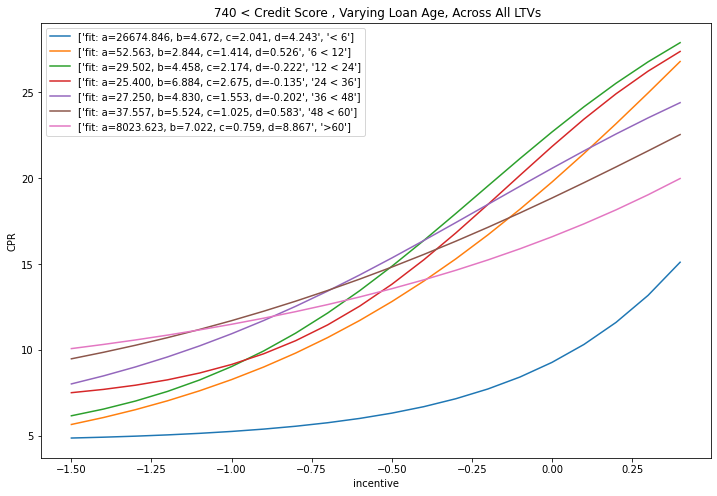

In [ ]:
xtest = np.arange(-1.5,0.5,.1)
y_fit_D1 = f(xtest, *popt_D1)
y_fit_D2 = f(xtest, *popt_D2)
y_fit_D3 = f(xtest, *popt_D3)
y_fit_D4 = f(xtest, *popt_D4)
y_fit_D5 = f(xtest, *popt_D5)
y_fit_D6 = f(xtest, *popt_D6)
y_fit_D7 = f(xtest, *popt_D7)
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
ax.plot(xtest, y_fit_D1, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D1), '< 6'])
ax.plot(xtest, y_fit_D2, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D2), '6 < 12'])
ax.plot(xtest, y_fit_D3, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D3), '12 < 24'])
ax.plot(xtest, y_fit_D4, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D4), '24 < 36'])
ax.plot(xtest, y_fit_D5, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D5), '36 < 48'])
ax.plot(xtest, y_fit_D6, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D6), '48 < 60'])
ax.plot(xtest, y_fit_D7, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_D7), '>60'])
plt.title(' 740 < Credit Score , Varying Loan Age, Across All LTVs')
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Differences to give ranges based on Loan Age

In [ ]:
# At incentive = -2.5, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-2.5, *popt_D1)
OldLoan = f(-2.5, *popt_D7)
print('The range expected based on Loan Age when incentive is -2.5:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -2.5: 4.700121545951863 to 8.459418974470852


In [ ]:
# At incentive = -1.5, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-1.5, *popt_D1)
OldLoan = f(-1.5, *popt_D7)
print('The range expected based on Loan Age when incentive is -1.5:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -1.5: 4.888178789584874 to 10.091590443387563


In [ ]:
# At incentive = -1, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-1, *popt_D1)
OldLoan = f(-1, *popt_D7)
print('The range expected based on Loan Age when incentive is -1:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -1: 5.271777927097533 to 11.50741289208655


In [ ]:
# At incentive = -.5, Young Loan (< 6 months) to Old Loan (> 60 months) 
YoungLoan = f(-.5, *popt_D1)
OldLoan = f(-.5, *popt_D7)
print('The range expected based on Loan Age when incentive is -.5:', YoungLoan, 'to', OldLoan)

The range expected based on Loan Age when incentive is -.5: 6.3361841952600795 to 13.57577323754158


# Scatterplots broken down into credit score and LTV buckets. The multiple colors on the first scatterplots represent different loan ages

In [ ]:
import scipy.optimize as opt
import matplotlib.pyplot as plt
from matplotlib.dates import MonthLocator, DateFormatter
from math import nan,isnan

## Credit score $\leq 550$ (Bucket A)

### LTV $\leq 50 \%$ 

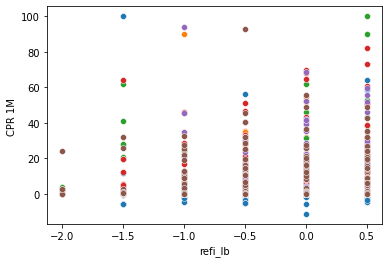

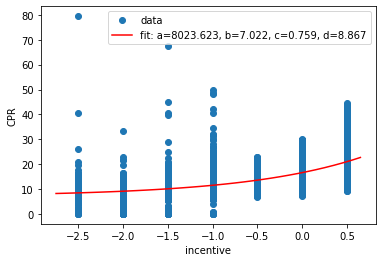

In [ ]:
def f(x, a, b, c, d):
    return a / (1. + np.exp(-c * (x - d))) + b

X = []
Y = []

for i in range(6):
  sns.scatterplot(data=OTM_Large_A_a_LA[i], x = OTM_Large_A_a_LA[i]['refi_lb'], y = OTM_Large_A_a_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_a_LA[i]['refi_lb'])):
    X.append(OTM_Large_A_a_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_a_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_A_a_LA[i]['CPR 1M '].iloc[k])

x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Aa, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Aa)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Aa))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

In [ ]:
OTM_Large_A_a_LA[1].head()

,Loan Age,Loan Age Description,Refi Incentive(1/10th bp),Refi Incentive(1/10th bp) Description,Orig LTV,Orig LTV Description,Credit Score,Credit Score Description,Factor Date,Current Remaining Principal Balance,...,Weighted Average Loan Age,Weighted Average Original Loan Size,Weighted Average Loan Size,Original Loan Amount,HPA (%) Weighted Average,HPA (%) Weighted Standard Deviation,CPR 1M,CCR 1M (Curtailment),CPR_final,refi_lb
65084,12,>6 and <=12,29999,>0.5,50,<=50,550,<=550,2017-09-01,1268586.188,...,9.284406,113648.9457,111980.4993,1288473.0,7.518200,1.236820,50.475294,-0.127655,50.475294,0.5
65047,12,>6 and <=12,500,>0 and <=0.5,50,<=50,550,<=550,2017-09-01,3869673.222,...,9.585390,161131.1066,157979.0243,3966072.0,6.656553,1.791585,2.933021,0.112019,2.933021,0.0
65009,12,>6 and <=12,0,>-0.5 and <=0,50,<=50,550,<=550,2017-09-01,6056437.953,...,9.568953,164374.1321,159965.0840,6248126.0,6.376700,1.636382,0.230101,0.230101,0.230101,-0.5
64973,12,>6 and <=12,-500,>-1 and <=-0.5,50,<=50,550,<=550,2017-09-01,2151535.256,...,9.273082,110832.6341,106266.4107,2247770.0,5.572320,2.125103,0.432525,0.432525,0.432525,-1.0
63827,12,>6 and <=12,29999,>0.5,50,<=50,550,<=550,2017-10-01,1918597.322,...,8.873408,114399.9890,112754.7170,1949955.0,6.554323,1.859546,-0.114879,-0.114879,-0.114879,0.5


### LTV $>50\%$ and $\leq 60\%$

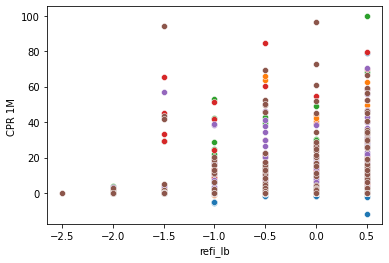

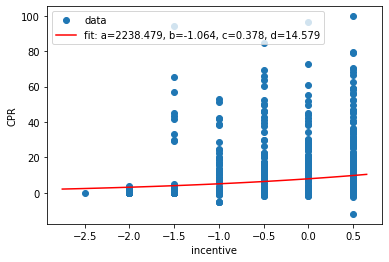

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_A_b_LA[i], x = OTM_Large_A_b_LA[i]['refi_lb'], y = OTM_Large_A_b_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_b_LA[i]['refi_lb'])):
    X.append(OTM_Large_A_b_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_b_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_A_b_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Ab, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Ab)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ab))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>60\%$ and $\leq 70\%$




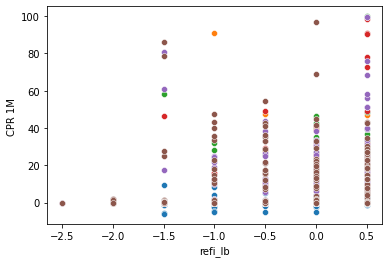

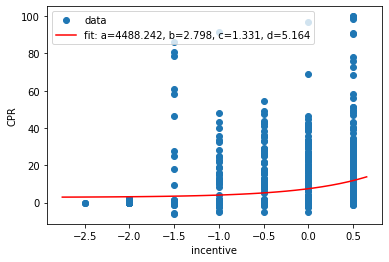

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_A_c_LA[i], x = OTM_Large_A_c_LA[i]['refi_lb'], y = OTM_Large_A_c_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_c_LA[i]['refi_lb'])):
    X.append(OTM_Large_A_c_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_c_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_A_c_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Ac, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Ac)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ac))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>70\%$ and $\leq 80\%$

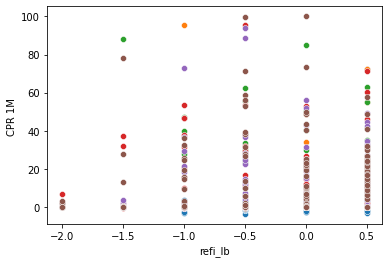

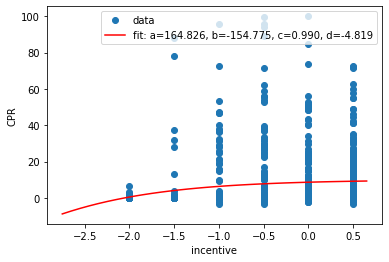

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_A_d_LA[i], x = OTM_Large_A_d_LA[i]['refi_lb'], y = OTM_Large_A_d_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_d_LA[i]['refi_lb'])):
    X.append(OTM_Large_A_d_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_d_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_A_d_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Ad, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Ad)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ad))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>80 \%$ and $\leq 90%$

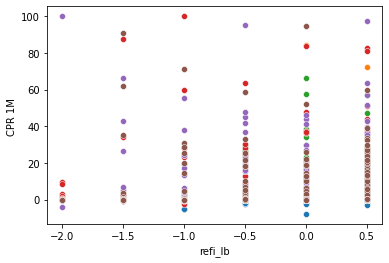

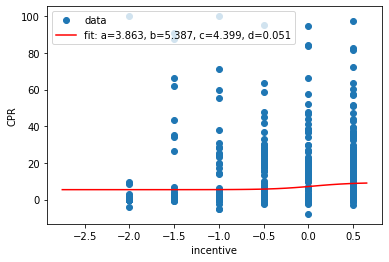

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_A_e_LA[i], x = OTM_Large_A_e_LA[i]['refi_lb'], y = OTM_Large_A_e_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_e_LA[i]['refi_lb'])):
    X.append(OTM_Large_A_e_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_e_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_A_e_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Ae, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Ae)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ae))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>90\%$ and $\leq 100\%$

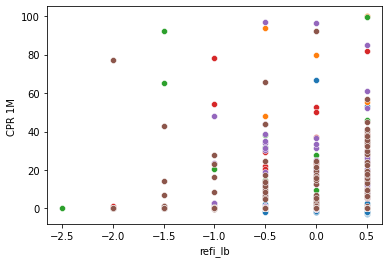

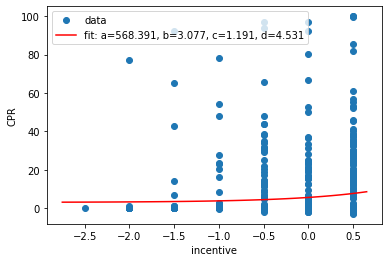

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_A_f_LA[i], x = OTM_Large_A_f_LA[i]['refi_lb'], y = OTM_Large_A_f_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_f_LA[i]['refi_lb'])):
    X.append(OTM_Large_A_f_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_f_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_A_f_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Af, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Af)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Af))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>100 \%$

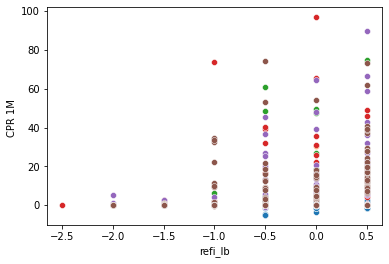

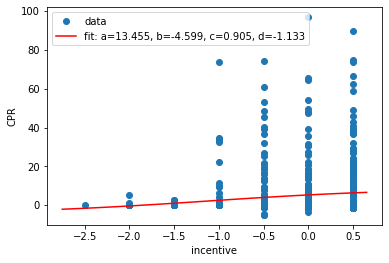

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_A_g_LA[i], x = OTM_Large_A_g_LA[i]['refi_lb'], y = OTM_Large_A_g_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_A_g_LA[i]['refi_lb'])):
    X.append(OTM_Large_A_g_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_A_g_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_A_g_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Ag, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Ag)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ag))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

## Credit score $>550$ and $\leq 680$ (Bucket B)

### LTV $\leq 50 \%$ 

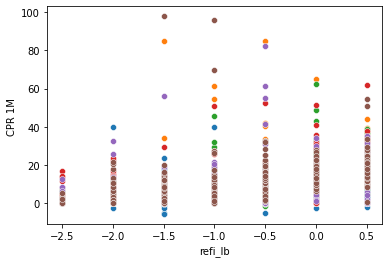

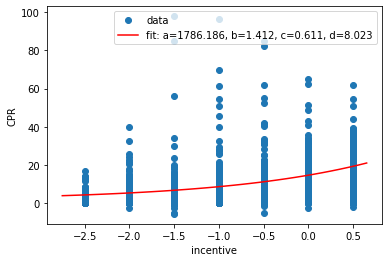

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_a_LA[i], x = OTM_Large_B_a_LA[i]['refi_lb'], y = OTM_Large_B_a_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_a_LA[i]['refi_lb'])):
    X.append(OTM_Large_B_a_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_a_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_B_a_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Ba, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Ba)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ba))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>50\%$ and $\leq 60\%$

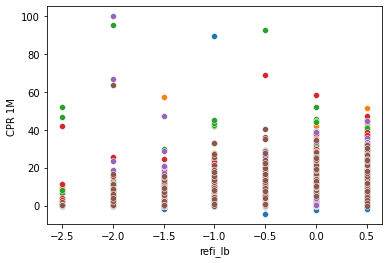

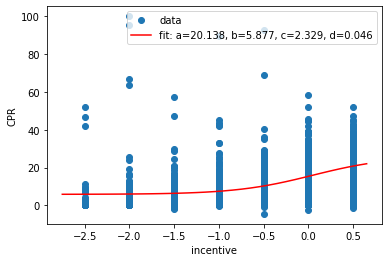

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_b_LA[i], x = OTM_Large_B_b_LA[i]['refi_lb'], y = OTM_Large_B_b_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_b_LA[i]['refi_lb'])):
    X.append(OTM_Large_B_b_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_b_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_B_b_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Bb, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Bb)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Bb))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>60\%$ and $\leq 70\%$

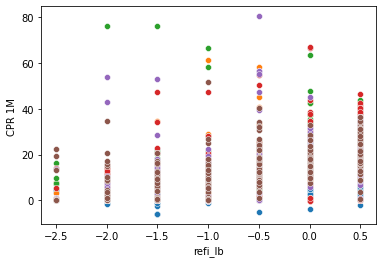

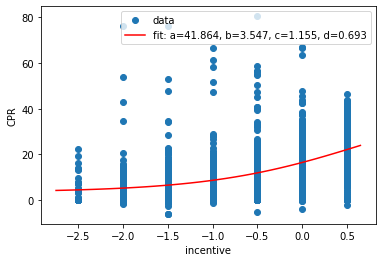

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_c_LA[i], x = OTM_Large_B_c_LA[i]['refi_lb'], y = OTM_Large_B_c_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_c_LA[i]['refi_lb'])):
    X.append(OTM_Large_B_c_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_c_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_B_c_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Bc, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Bc)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Bc))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>70\%$ and $\leq 80\%$

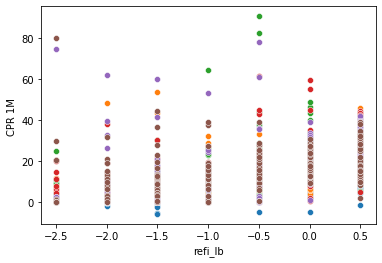

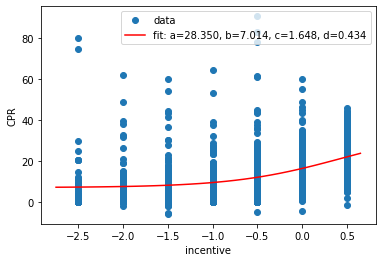

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_d_LA[i], x = OTM_Large_B_d_LA[i]['refi_lb'], y = OTM_Large_B_d_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_d_LA[i]['refi_lb'])):
    X.append(OTM_Large_B_d_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_d_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_B_d_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Bd, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Bd)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Bd))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>80 \%$ and $\leq 90%$

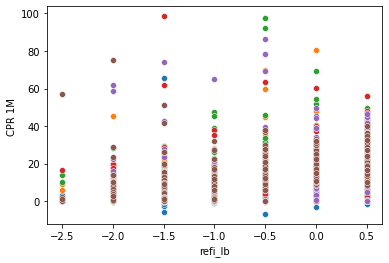

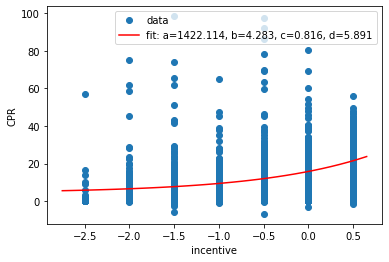

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_e_LA[i], x = OTM_Large_B_e_LA[i]['refi_lb'], y = OTM_Large_B_e_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_e_LA[i]['refi_lb'])):
    X.append(OTM_Large_B_e_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_e_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_B_e_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Be, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Be)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Be))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>90\%$ and $\leq 100\%$

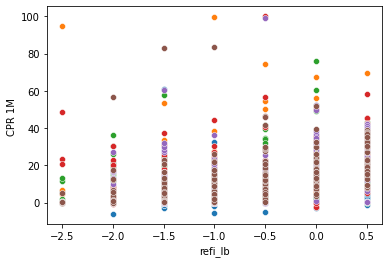

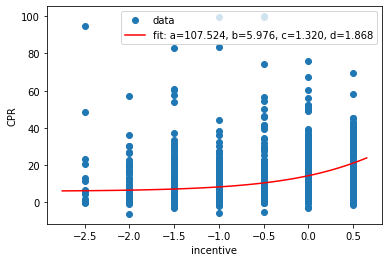

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_f_LA[i], x = OTM_Large_B_f_LA[i]['refi_lb'], y = OTM_Large_B_f_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_f_LA[i]['refi_lb'])):
    X.append(OTM_Large_B_f_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_f_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_B_f_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Bf, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Bf)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Bf))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>100 \%$

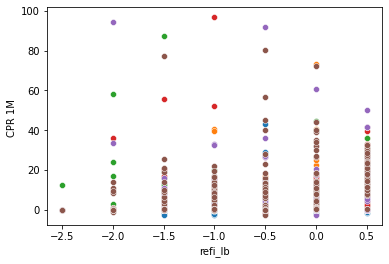

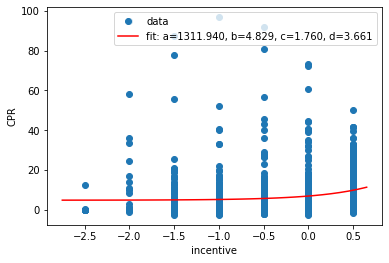

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_B_g_LA[i], x = OTM_Large_B_g_LA[i]['refi_lb'], y = OTM_Large_B_g_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_B_g_LA[i]['refi_lb'])):
    X.append(OTM_Large_B_g_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_B_g_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_B_g_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Bg, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Bg)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Bg))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

## Credit score $>680$ and $\leq 740$ (Bucket C)

### LTV $\leq 50 \%$ 

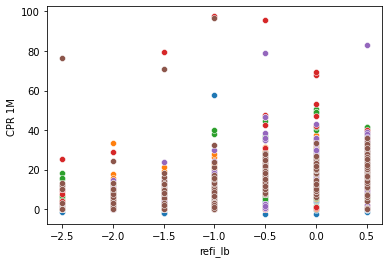

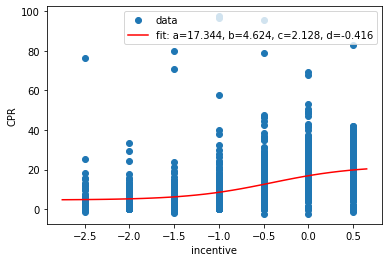

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_a_LA[i], x = OTM_Large_C_a_LA[i]['refi_lb'], y = OTM_Large_C_a_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_a_LA[i]['refi_lb'])):
    X.append(OTM_Large_C_a_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_a_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_C_a_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Ca, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Ca)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ca))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>50\%$ and $\leq 60\%$

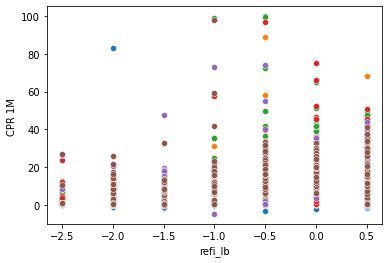

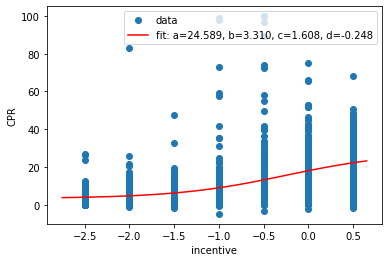

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_b_LA[i], x = OTM_Large_C_b_LA[i]['refi_lb'], y = OTM_Large_C_b_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_b_LA[i]['refi_lb'])):
    X.append(OTM_Large_C_b_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_b_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_C_b_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Cb, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Cb)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Cb))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>60\%$ and $\leq 70\%$

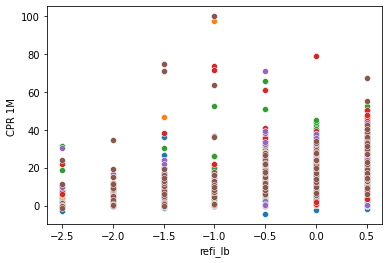

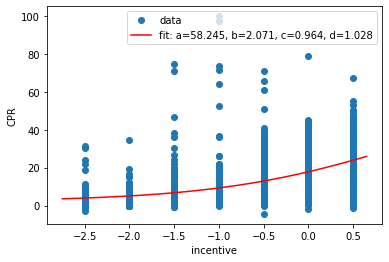

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_c_LA[i], x = OTM_Large_C_c_LA[i]['refi_lb'], y = OTM_Large_C_c_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_c_LA[i]['refi_lb'])):
    X.append(OTM_Large_C_c_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_c_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_C_c_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Cc, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Cc)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Cc))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>70\%$ and $\leq 80\%$

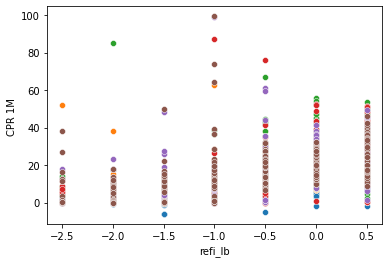

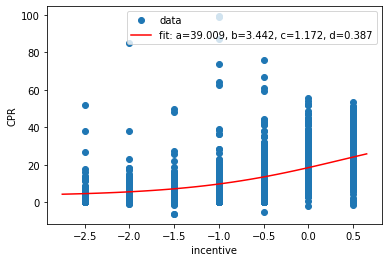

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_d_LA[i], x = OTM_Large_C_d_LA[i]['refi_lb'], y = OTM_Large_C_d_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_d_LA[i]['refi_lb'])):
    X.append(OTM_Large_C_d_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_d_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_C_d_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Cd, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Cd)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Cd))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>80 \%$ and $\leq 90%$

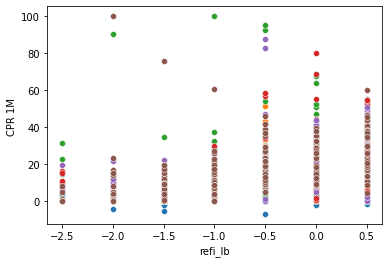

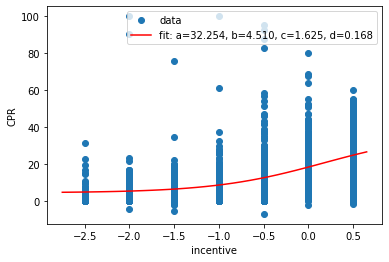

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_e_LA[i], x = OTM_Large_C_e_LA[i]['refi_lb'], y = OTM_Large_C_e_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_e_LA[i]['refi_lb'])):
    X.append(OTM_Large_C_e_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_e_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_C_e_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Ce, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Ce)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ce))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>90\%$ and $\leq 100\%$

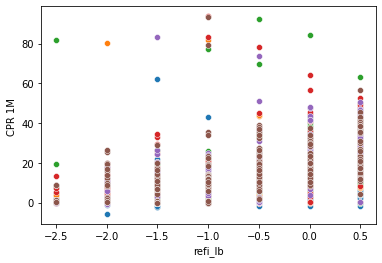

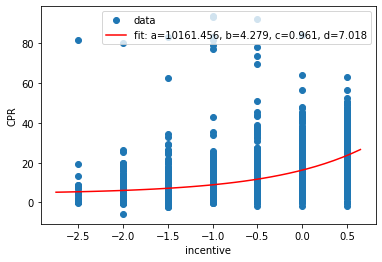

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_f_LA[i], x = OTM_Large_C_f_LA[i]['refi_lb'], y = OTM_Large_C_f_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_f_LA[i]['refi_lb'])):
    X.append(OTM_Large_C_f_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_f_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_C_f_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Cf, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Cf)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Cf))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>100 \%$

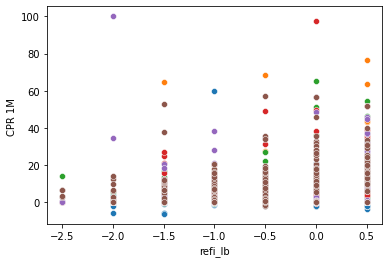

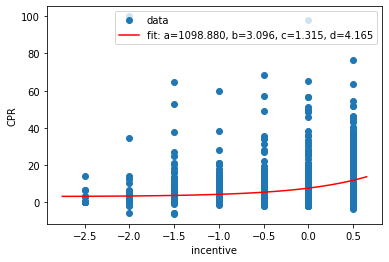

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_C_g_LA[i], x = OTM_Large_C_g_LA[i]['refi_lb'], y = OTM_Large_C_g_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_C_g_LA[i]['refi_lb'])):
    X.append(OTM_Large_C_g_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_C_g_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_C_g_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Cg, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Cg)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Cg))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

## Credit score $>740$ (Bucket D)

### LTV $\leq 50 \%$ 

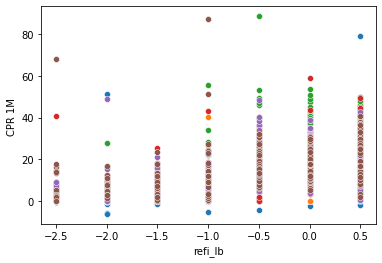

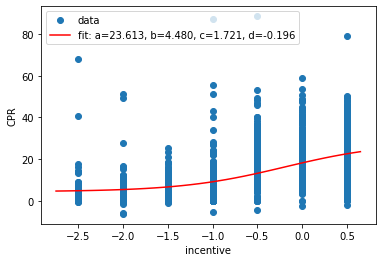

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_a_LA[i], x = OTM_Large_D_a_LA[i]['refi_lb'], y = OTM_Large_D_a_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_a_LA[i]['refi_lb'])):
    X.append(OTM_Large_D_a_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_a_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_D_a_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Da, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Da)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Da))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>50\%$ and $\leq 60\%$

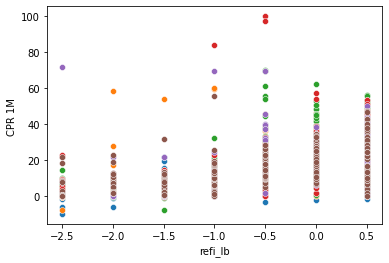

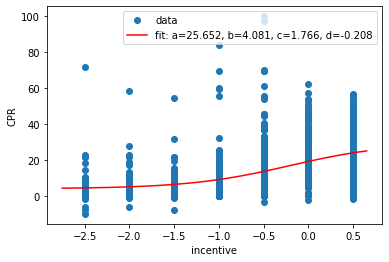

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_b_LA[i], x = OTM_Large_D_b_LA[i]['refi_lb'], y = OTM_Large_D_b_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_b_LA[i]['refi_lb'])):
    X.append(OTM_Large_D_b_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_b_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_D_b_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Db, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Db)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Db))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>60\%$ and $\leq 70\%$

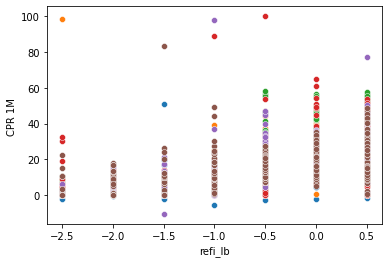

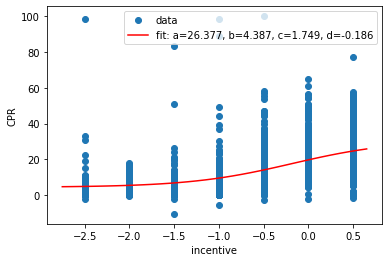

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_c_LA[i], x = OTM_Large_D_c_LA[i]['refi_lb'], y = OTM_Large_D_c_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_c_LA[i]['refi_lb'])):
    X.append(OTM_Large_D_c_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_c_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_D_c_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Dc, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Dc)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Dc))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>70\%$ and $\leq 80\%$

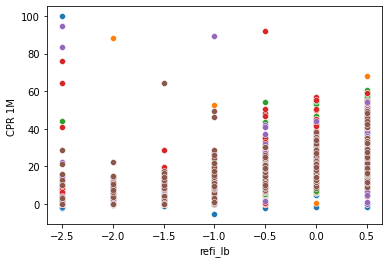

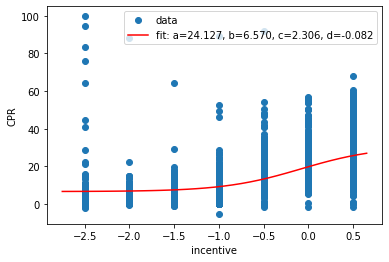

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_d_LA[i], x = OTM_Large_D_d_LA[i]['refi_lb'], y = OTM_Large_D_d_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_d_LA[i]['refi_lb'])):
    X.append(OTM_Large_D_d_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_d_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_D_d_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Dd, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Dd)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Dd))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>80 \%$ and $\leq 90%$

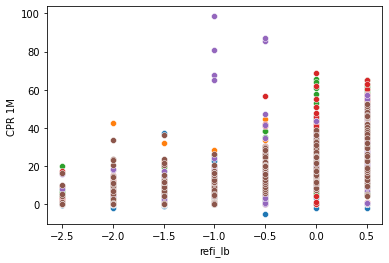

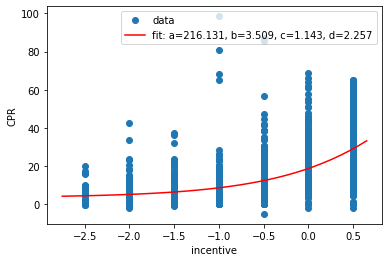

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_e_LA[i], x = OTM_Large_D_e_LA[i]['refi_lb'], y = OTM_Large_D_e_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_e_LA[i]['refi_lb'])):
    X.append(OTM_Large_D_e_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_e_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_D_e_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_De, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_De)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_De))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>90\%$ and $\leq 100\%$

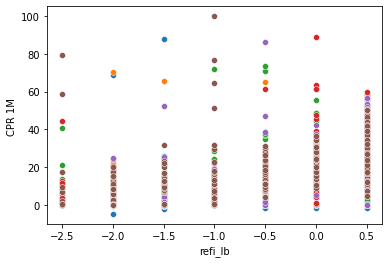

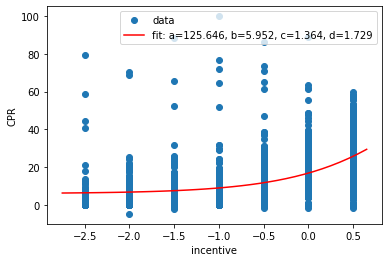

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_f_LA[i], x = OTM_Large_D_f_LA[i]['refi_lb'], y = OTM_Large_D_f_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_f_LA[i]['refi_lb'])):
    X.append(OTM_Large_D_f_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_f_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_D_f_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Df, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Df)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Df))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### LTV $>100 \%$

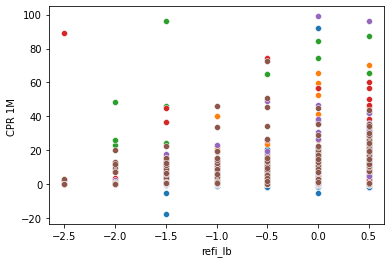

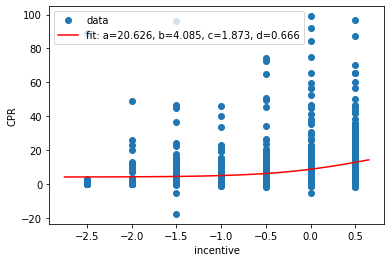

In [ ]:
X = []
Y = []
for i in range(6):
  sns.scatterplot(data=OTM_Large_D_g_LA[i], x = OTM_Large_D_g_LA[i]['refi_lb'], y = OTM_Large_D_g_LA[i]['CPR 1M '])
  for j in range(len(OTM_Large_D_g_LA[i]['refi_lb'])):
    X.append(OTM_Large_D_g_LA[i]['refi_lb'].iloc[j])
  for k in range(len(OTM_Large_D_g_LA[i]['CPR 1M '])):
    Y.append(OTM_Large_D_g_LA[i]['CPR 1M '].iloc[k])

X_new = []
Y_new = []
for i in range(len(X)): 
  if isnan(X[i]) == False:
    if isnan(Y[i]) == False:
      X_new.append(X[i])
      Y_new.append(Y[i])


x = X_new
y = Y_new
xtest = np.arange(-2.75,.75,.1)
popt_Dg, pcov = opt.curve_fit(f, x, y, method="trf")
y_fit = f(xtest, *popt_Dg)
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.plot(x, y, 'o', label = 'data')
ax.plot(xtest, y_fit, 'r-', label = 'fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Dg))
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

## The S-curves for each LTV for a given credit bucket plotted together

Below we plot the S-curves for all the different LTVs, but the same credit score together.

### Credit score $\leq 550$ (Bucket A)

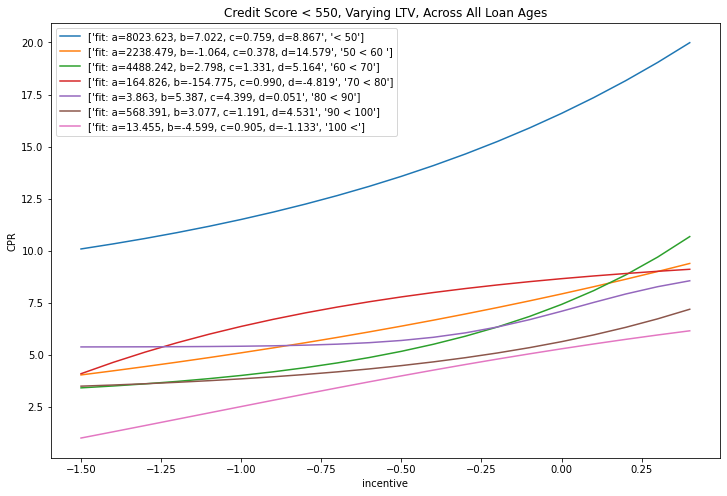

In [ ]:
xtest = np.arange(-1.5,0.5,.1)
y_fit_Aa = f(xtest, *popt_Aa)
y_fit_Ab = f(xtest, *popt_Ab)
y_fit_Ac = f(xtest, *popt_Ac)
y_fit_Ad = f(xtest, *popt_Ad)
y_fit_Ae = f(xtest, *popt_Ae)
y_fit_Af = f(xtest, *popt_Af)
y_fit_Ag = f(xtest, *popt_Ag)
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
ax.plot(xtest, y_fit_Aa, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Aa), '< 50'])
ax.plot(xtest, y_fit_Ab, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ab), '50 < 60 '])
ax.plot(xtest, y_fit_Ac, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ac), '60 < 70'])
ax.plot(xtest, y_fit_Ad, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ad), '70 < 80'])
ax.plot(xtest, y_fit_Ae, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ae), '80 < 90'])
ax.plot(xtest, y_fit_Af, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Af), '90 < 100'])
ax.plot(xtest, y_fit_Ag, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ag), '100 <'])
plt.title('Credit Score < 550, Varying LTV, Across All Loan Ages')
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Differences to give ranges based on LTV

In [ ]:
# At incentive = -2.5, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-2.5, *popt_Ab)
HighLTV = f(-2.5, *popt_Ae)
print('The range expected based on LTVs when incentive is -2.5:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -2.5: 2.4410558454369538 to 5.387056565479228


In [ ]:
# At incentive = -1.5, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-1.5, *popt_Ab)
HighLTV = f(-1.5, *popt_Ae)
print('The range expected based on LTVs when incentive is -1.5:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -1.5: 4.047932521600303 to 5.391202631338171


In [ ]:
# At incentive = -1, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-1, *popt_Ab)
HighLTV = f(-1, *popt_Ae)
print('The range expected based on LTVs when incentive is -1:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -1: 5.1087889776384525 to 5.424550760995877


In [ ]:
# At incentive = -.5, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-.5, *popt_Ab)
HighLTV = f(-.5, *popt_Ae)
print('The range expected based on LTVs when incentive is -.5:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -.5: 6.389077844804415 to 5.701252187459252


### Credit score $>550$ and $\leq 680$ (Bucket B)

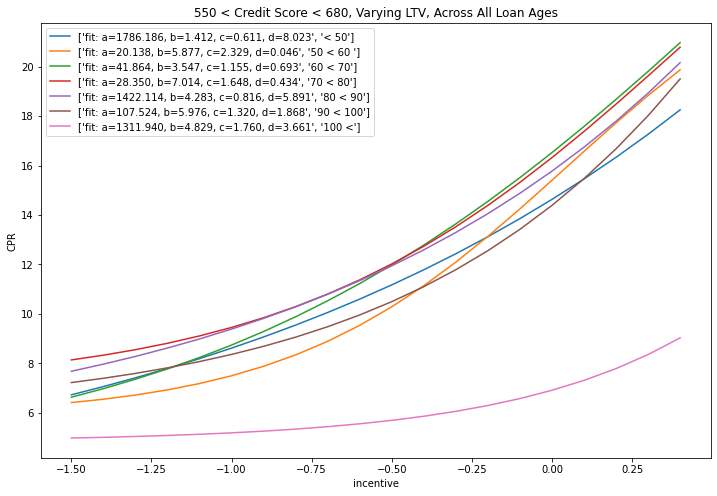

In [ ]:
xtest = np.arange(-1.5,0.5,.1)
y_fit_Ba = f(xtest, *popt_Ba)
y_fit_Bb = f(xtest, *popt_Bb)
y_fit_Bc = f(xtest, *popt_Bc)
y_fit_Bd = f(xtest, *popt_Bd)
y_fit_Be = f(xtest, *popt_Be)
y_fit_Bf = f(xtest, *popt_Bf)
y_fit_Bg = f(xtest, *popt_Bg)
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
ax.plot(xtest, y_fit_Ba, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ba), '< 50'])
ax.plot(xtest, y_fit_Bb, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Bb), '50 < 60 '])
ax.plot(xtest, y_fit_Bc, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Bc), '60 < 70'])
ax.plot(xtest, y_fit_Bd, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Bd), '70 < 80'])
ax.plot(xtest, y_fit_Be, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Be), '80 < 90'])
ax.plot(xtest, y_fit_Bf, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Bf), '90 < 100'])
ax.plot(xtest, y_fit_Bg, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Bg), '100 <'])
plt.title('550 < Credit Score < 680, Varying LTV, Across All Loan Ages')
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Differences to give ranges based on LTV

In [ ]:
# At incentive = -2.5, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-2.5, *popt_Bb)
HighLTV = f(-2.5, *popt_Be)
print('The range expected based on LTVs when incentive is -2.5:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -2.5: 5.930295096284009 to 5.7861896370563155


In [ ]:
# At incentive = -1.5, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-1.5, *popt_Bb)
HighLTV = f(-1.5, *popt_Be)
print('The range expected based on LTVs when incentive is -1.5:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -1.5: 6.412319448577961 to 7.679526212925938


In [ ]:
# At incentive = -1, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-1, *popt_Bb)
HighLTV = f(-1, *popt_Be)
print('The range expected based on LTVs when incentive is -1:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -1: 7.4973716731422595 to 9.385840762118683


In [ ]:
# At incentive = -.5, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-.5, *popt_Bb)
HighLTV = f(-.5, *popt_Be)
print('The range expected based on LTVs when incentive is -.5:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -.5: 10.286473536352585 to 11.944724747301986


### Credit score $>680$ and $\leq 740$ (Bucket C)

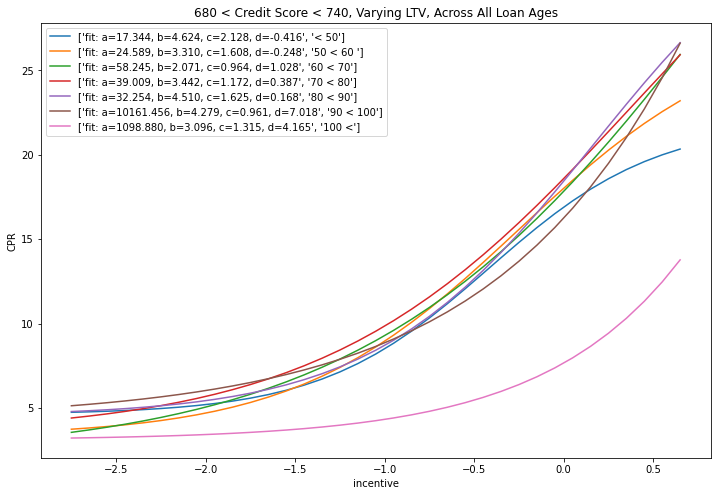

In [ ]:
xtest = np.arange(-2.75,.75,.1)
y_fit_Ca = f(xtest, *popt_Ca)
y_fit_Cb = f(xtest, *popt_Cb)
y_fit_Cc = f(xtest, *popt_Cc)
y_fit_Cd = f(xtest, *popt_Cd)
y_fit_Ce = f(xtest, *popt_Ce)
y_fit_Cf = f(xtest, *popt_Cf)
y_fit_Cg = f(xtest, *popt_Cg)
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
ax.plot(xtest, y_fit_Ca, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ca), '< 50'])
ax.plot(xtest, y_fit_Cb, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Cb), '50 < 60 '])
ax.plot(xtest, y_fit_Cc, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Cc), '60 < 70'])
ax.plot(xtest, y_fit_Cd, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Cd), '70 < 80'])
ax.plot(xtest, y_fit_Ce, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ce), '80 < 90'])
ax.plot(xtest, y_fit_Cf, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Cf), '90 < 100'])
ax.plot(xtest, y_fit_Cg, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Cg), '100 <'])
plt.title('680 < Credit Score < 740, Varying LTV, Across All Loan Ages')
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

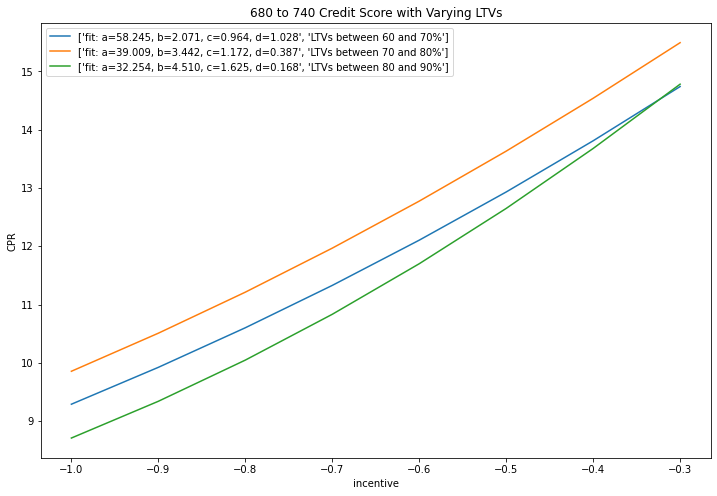

In [ ]:
xtest = np.arange(-1,-.25,.1)
y_fit_Ca = f(xtest, *popt_Ca)
y_fit_Cb = f(xtest, *popt_Cb)
y_fit_Cc = f(xtest, *popt_Cc)
y_fit_Cd = f(xtest, *popt_Cd)
y_fit_Ce = f(xtest, *popt_Ce)
y_fit_Cf = f(xtest, *popt_Cf)
y_fit_Cg = f(xtest, *popt_Cg)
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
ax.plot(xtest, y_fit_Cc, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Cc),'LTVs between 60 and 70%' ])
ax.plot(xtest, y_fit_Cd, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Cd), 'LTVs between 70 and 80%'])
ax.plot(xtest, y_fit_Ce, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Ce), 'LTVs between 80 and 90%'])
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.title('680 to 740 Credit Score with Varying LTVs')
plt.legend()
plt.show()

### Differences to give ranges based on LTV

In [ ]:
# At incentive = -2.5, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-2.5, *popt_Cb)
HighLTV = f(-2.5, *popt_Ce)
print('The range expected based on LTVs when incentive is -2.5:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -2.5: 3.9505909191652053 to 4.926626051931834


In [ ]:
# New Loan < 6 months
# Ramping up < 6-12 months
#yearly description after that
# above 36 is seasoned
# At incentive = -1.5, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-1.5, *popt_Cb)
HighLTV = f(-1.5, *popt_Ce)
print('The range expected based on LTVs when incentive is -1.5:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -1.5: 6.206363937833759 to 6.519507140196307


In [ ]:
# At incentive = -1, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-1, *popt_Cb)
HighLTV = f(-1, *popt_Ce)
print('The range expected based on LTVs when incentive is -1:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -1: 8.959876488400427 to 8.710628577660216


In [ ]:
# At incentive = -.5, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-.5, *popt_Cb)
HighLTV = f(-.5, *popt_Ce)
print('The range expected based on LTVs when incentive is -.5:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -.5: 13.14442215477458 to 12.64823856558229


In [ ]:
print(f(-1.0, *popt_Cb))
print(f(-1.0, *popt_Cc))
print(f(-1.0, *popt_Cd))

print(f(-0.5, *popt_Cb))
print(f(-0.5, *popt_Cc))
print(f(-0.5, *popt_Cd))


8.959876488400427
9.290596313641243
9.855568505948392
13.14442215477458
12.93019291472967
13.630479749544568


### Credit score $>740$ (Bucket D)

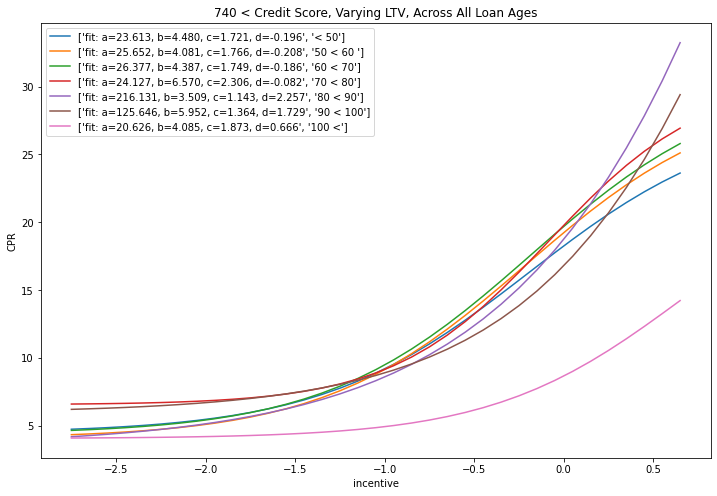

In [ ]:
xtest = np.arange(-2.75,.75,.1)
y_fit_Da = f(xtest, *popt_Da)
y_fit_Db = f(xtest, *popt_Db)
y_fit_Dc = f(xtest, *popt_Dc)
y_fit_Dd = f(xtest, *popt_Dd)
y_fit_De = f(xtest, *popt_De)
y_fit_Df = f(xtest, *popt_Df)
y_fit_Dg = f(xtest, *popt_Dg)
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
ax.plot(xtest, y_fit_Da, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Da), '< 50'])
ax.plot(xtest, y_fit_Db, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Db), '50 < 60 '])
ax.plot(xtest, y_fit_Dc, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Dc), '60 < 70'])
ax.plot(xtest, y_fit_Dd, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Dd), '70 < 80'])
ax.plot(xtest, y_fit_De, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_De), '80 < 90'])
ax.plot(xtest, y_fit_Df, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Df), '90 < 100'])
ax.plot(xtest, y_fit_Dg, label = ['fit: a=%5.3f, b=%5.3f, c=%5.3f, d=%5.3f' % tuple(popt_Dg), '100 <'])
plt.title('740 < Credit Score, Varying LTV, Across All Loan Ages')
plt.xlabel("incentive")
plt.ylabel("CPR")
plt.legend()
plt.show()

### Differences to give ranges based on LTV

In [ ]:
# At incentive = -2.5, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-2.5, *popt_Db)
HighLTV = f(-2.5, *popt_De)
print('The range expected based on LTVs when incentive is -2.5:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -2.5: 4.522057727660941 to 4.4472696583531075


In [ ]:
# At incentive = -1.5, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-1.5, *popt_Db)
HighLTV = f(-1.5, *popt_De)
print('The range expected based on LTVs when incentive is -1.5:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -1.5: 6.459730037990818 to 6.423349646053438


In [ ]:
# At incentive = -1, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-1, *popt_Db)
HighLTV = f(-1, *popt_De)
print('The range expected based on LTVs when incentive is -1:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -1: 9.163497773321033 to 8.615868523000293


In [ ]:
# At incentive = -.5, Low LTV (50 - 60%) to High LTV (80 - 90%) 
LowLTV = f(-.5, *popt_Db)
HighLTV = f(-.5, *popt_De)
print('The range expected based on LTVs when incentive is -.5:', LowLTV, 'to', HighLTV)

The range expected based on LTVs when incentive is -.5: 13.673992322913598 to 12.38911335793566


# Summary

By cleaning the noise out of the data and seperating the data into their various cohorts, we have been able to find models to describe the tail of the S-Curves which focus on the very negative incentives. By focusing on these negative incentives and modeling them, we have gained a better understanding of the behavior of prepayment where we expect to see a larger presence of turnover. From our models, it appears as though loan age has a larger impact than LTV on the growth rate of the CPR for changing incentives. However this could be a consequence of how the data  was aggragated and requires further investigation.